In [1]:
import matplotlib.pyplot as plt
import numpy as np
import math 
import sklearn.preprocessing 
import random
import yaml
import h5py
import logging
import datetime
import os
import time
import sys

import pprint
from tqdm import tqdm_notebook as tqdm

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, SequentialSampler, BatchSampler
import torch.nn.functional as F


from load_matlab_timedata import get_data_from
from src.TSGenerator import f_Y, f_X, get_func_timeseries
from src.DataLoader import TimeSeriesDataset
from src.model_utils import init_logger, plot_shared_scale, plot_multiscale
from src.Model import LSTM
from src.Losses import myLoss, aux_loss_jordan, prognose_dy

from torch.optim.lr_scheduler import ReduceLROnPlateau  


## Loading config files, setup execution parameters, init objects

In [2]:
plt.rcParams['figure.figsize'] = 20, 7.
CONFIG_FILENAME = "model_params_jordan.yaml"
# ! ls DC_motor_simulation
with open(CONFIG_FILENAME, 'r') as f:
        config = yaml.load(f, Loader=yaml.FullLoader)
   
pprint.pprint(config)


p_net = config['network_params']

p_train = config['train_params']

p_gen = config['generator_params']

p_data = config['data_params']
need_normalize = p_data['need_normalize']

{'data_params': {'best_discrete_k': 3,
                 'integration_step': 0.01,
                 'leave_nth': 13,
                 'mat_file': 'DC_motor_simulation/train_3_parameters.mat',
                 'need_normalize': True,
                 'specific_data_source': 'DC_motor_simulation/test_3_parameters_5_15_1_20_additive_sin.mat',
                 'specific_data_sources': ['DC_motor_simulation/test_3_parameters_5_15_1_20_additive_noise.mat',
                                           'DC_motor_simulation/test_3_parameters_5_15_1_20_additive_sin.mat',
                                           'DC_motor_simulation/test_3_parameters_d_001_2.mat',
                                           'DC_motor_simulation/test_3_parameters_v_0_33.mat'],
                 'test_size': 0.3,
                 'use_part_of_data': 1.0},
 'exp_path': 'only_batches',
 'generator_params': {'a': 0.5, 'b': 1.0, 'f_X': 'math.sin', 'f_Y': 'math.cos'},
 'is_debug': False,
 'jordan_path': 'jordan.pt',
 'netw

# Set parameters

In [3]:

# # If `per_element` is True, then LSTM reads in one timestep at a time.
if  p_net['per_element']:
    lstm_input_size = 1
else:
    lstm_input_size = p_net['input_size']
    
# if is_debug:
#     x, y = get_func_timeseries(f_Y = f_Y, f_X = f_X, a=p_generate['a'], b=p_generate['b'])
to_generate_data = config['to_generate_data'] 
if to_generate_data:
    p_gen = config['generator_params']
    print("Data generator params:")
    pprint.pprint(p_gen)
    a = p_gen['a']
    b = p_gen['b']
is_debug = config['is_debug']


init_logger(config)

logging.info("Experiment started with params")
logging.info(f"data_par: {p_data}")
logging.info(f"net_par: {p_net}")
logging.info(f"train_par: {p_train}") 

logger inited to file [only_batcheslogs/exp_2019-05-16_15:24:54.log]


## Init data loader and get appropriate part of data

## Creating objects from imported files

In [4]:
from src.Model import LSTM, LSTM_jordan
from src.Losses import myLoss, prognose_dy, myLoss_jordan  # imports here for faster rerun and debug procedure

model = LSTM_jordan(lstm_input_size,
             p_net['hidden_size'],
             batch_size=p_train['batch_size'],
            jordan_params=3,
             output_dim=1,
             num_layers=p_net['num_layers'],
                   lstm_bias=p_net['bias'])

loss_fn = myLoss_jordan


In [5]:
for name, parameter in model.named_parameters():
    print(name, '\t\t', parameter.shape)

jordan 		 torch.Size([1, 3])
lstm.weight_ih_l0 		 torch.Size([8, 4])
lstm.weight_hh_l0 		 torch.Size([8, 2])
linear.weight 		 torch.Size([1, 2])
linear.bias 		 torch.Size([1])


In [6]:
p_optim = p_train['optimizer']

if p_optim['optimizer'] == "adam":
    optimizer = torch.optim.Adam(
        [
                {
                    'params': model.jordan,
                    'lr': p_optim['jordan']['lr'],
                    'betas': (0.8, 0.95),
                    'weight_decay':p_optim['jordan']['wd']
                },
                {
                    'params': model.lstm.parameters(), 
                    'lr': p_optim['lstm']['lr'],
                    'weight_decay':p_optim['lstm']['wd']
                },
                {
                    'params': model.linear.parameters(),
                    'lr': p_optim['linear']['lr'],
                    'weight_decay':p_optim['linear']['wd']
                }
            ]
    )

logging.info(f"Model n params: {model.get_num_params()}")
print(f"model has [{model.get_num_params()}] params")
num_epochs = p_train['num_epochs']
logging.info("Training process INITIALIZED")
optimizer

model has [54.0] params


Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.8, 0.95)
    eps: 1e-08
    lr: 0.01
    weight_decay: 0

Parameter Group 1
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0

Parameter Group 2
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)

In [7]:
p_sched = p_train['lr_scheduler']
scheduler = ReduceLROnPlateau(optimizer=optimizer,
                              mode='min',
                              factor=p_sched['lr_drop'],
                              patience=p_sched['patience'],
                              cooldown=p_sched['cooldown'],
                              threshold=p_sched['threshold'],
                              threshold_mode='rel',
                              min_lr=10**p_sched['early_stop_order'],
                             verbose=True
                             )
print("LR scheduler set_uped")
scheduler.state_dict()

LR scheduler set_uped


{'factor': 0.4,
 'min_lrs': [1e-08, 1e-08, 1e-08],
 'patience': 4,
 'verbose': True,
 'cooldown': 4,
 'cooldown_counter': 0,
 'mode': 'min',
 'threshold': 0.01,
 'threshold_mode': 'rel',
 'best': inf,
 'num_bad_epochs': 0,
 'mode_worse': inf,
 'eps': 1e-08,
 'last_epoch': -1}

In [8]:
sample_x= torch.rand([p_net['retrospective_steps'], p_train['batch_size'], 1])
y, pars = model(sample_x)

In [9]:
sample_x.shape


torch.Size([64, 1024, 1])

using 1.0 of data
loading from [DC_motor_simulation/train_3_parameters.mat]
X normalized, norms: [14.99931682]
x shape (76924, 1)
x_normalized shape (76924, 1)


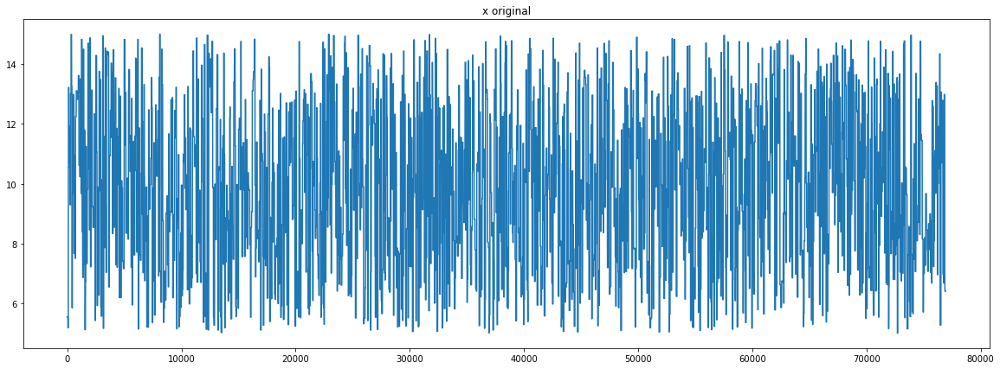

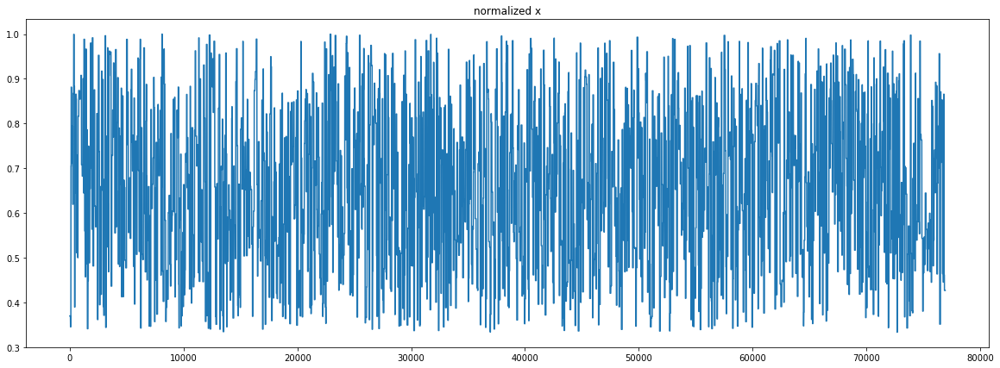

Y normalized, norms: [0.01324489]
input shape (76924, 1)
input partition shape (23078, 1)
output partition shape (23078, 1)
stacked Y shape  (23014, 1)
Y_tensor torch.Size([23014, 1])
X_tensor torch.Size([64, 23013, 1])
loading from [DC_motor_simulation/train_3_parameters.mat]
X normalized, norms: [14.99931682]
x shape (76924, 1)
x_normalized shape (76924, 1)


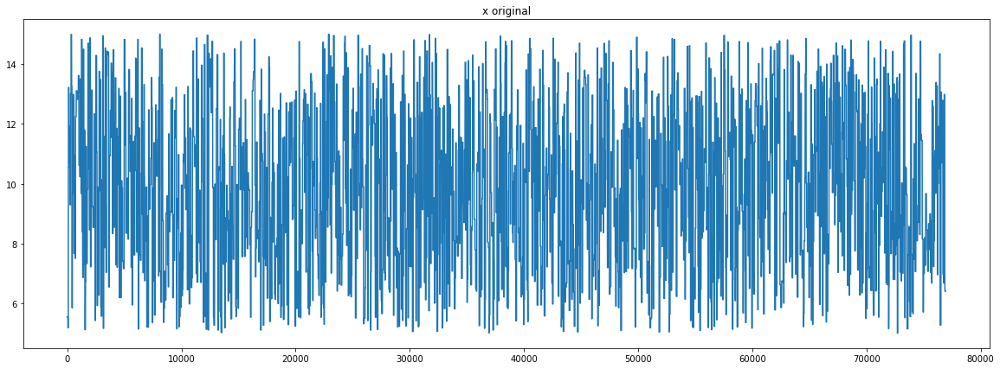

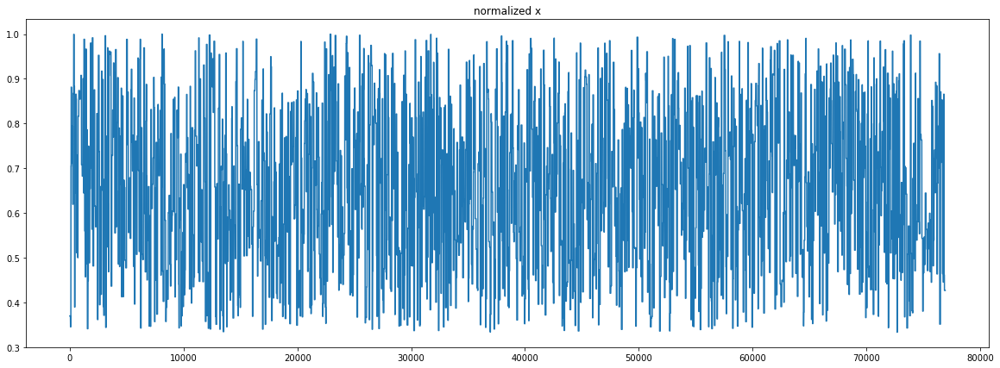

Y normalized, norms: [0.01324489]
input shape (76924, 1)
input partition shape (53846, 1)
output partition shape (53846, 1)
stacked Y shape  (53782, 1)
Y_tensor torch.Size([53782, 1])
X_tensor torch.Size([64, 53781, 1])
train set: [53782] batches
test set: [23014] batches
data_loading time 54.85178279876709 secs


In [10]:
# todo add time tracking for this cell
use_part = p_data['use_part_of_data']
print(f"using {use_part} of data")

t_tick = time.time()

test_ts_ds = TimeSeriesDataset(config=config,
                               partition=(use_part - use_part*p_data['test_size'], use_part),                        
                               logging=logging)

train_ts_ds = TimeSeriesDataset(config=config,
                                partition=(0, use_part - use_part*p_data['test_size']),
                                logging=logging)

print(f"train set: [{len(train_ts_ds)}] batches")
print(f"test set: [{len(test_ts_ds)}] batches")

if need_normalize:
    config['x_norm'] = train_ts_ds.x_norms[0]
    config['y_norm'] = train_ts_ds.y_norms[0]
    config['x_norm']
else:
    config['x_norm'] = 1
    config['y_norm'] = 1
    config['x_norm']

train_dl = DataLoader(dataset = train_ts_ds,
                      batch_sampler = BatchSampler(
                          sampler = SequentialSampler(train_ts_ds), 
                          batch_size = p_train['batch_size'],
                          drop_last = True)
                     )
test_dl = DataLoader(dataset = test_ts_ds,
                     batch_sampler = BatchSampler(
                     sampler = SequentialSampler(test_ts_ds), 
                     batch_size = p_train['batch_size'], 
                     drop_last = True)
                    )    
    
t_tock = time.time()
dataload_time = t_tock - t_tick
print(f"data_loading time {dataload_time} secs")

## Inspecting data we have, get several batches and look inside on pretty large scale to see individual iterations:

x [batch_size, retrospective_steps, channels] :torch.Size([1024, 64, 1])
y [batch_size, channels]: torch.Size([1024, 1])
y_last [slice_size]: (150,)


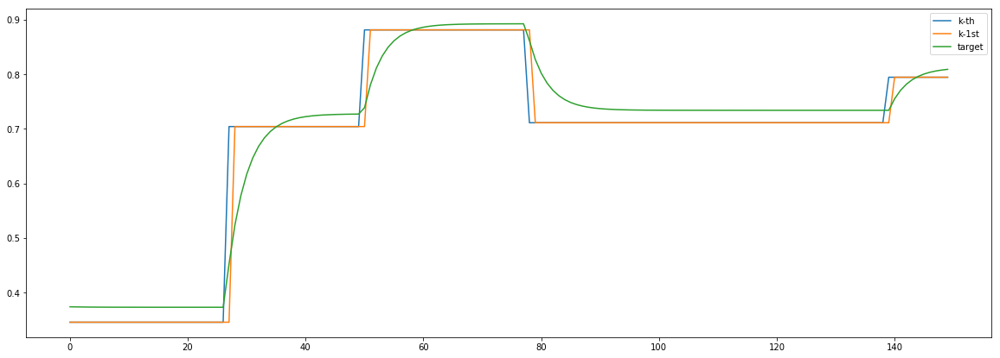

x [batch_size, retrospective_steps, channels] :torch.Size([1024, 64, 1])
y [batch_size, channels]: torch.Size([1024, 1])
y_last [slice_size]: (150,)


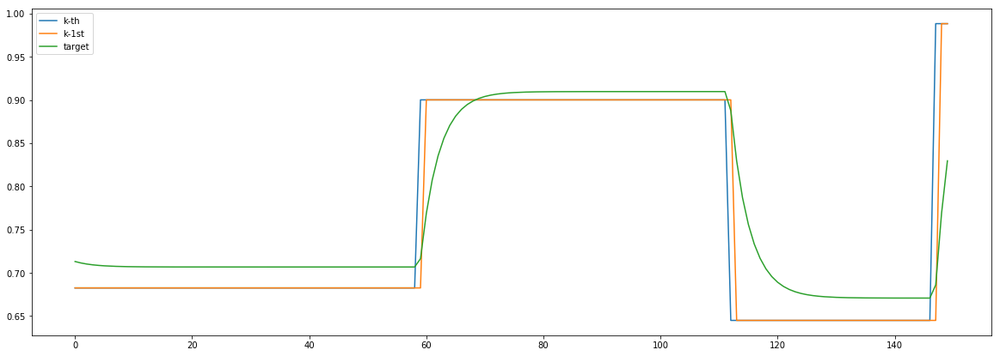

In [11]:
f, t = 0, 150
for i, batch in enumerate(train_dl):
    x, y, ind = batch
    print(f"x [batch_size, retrospective_steps, channels] :{x.shape}")
    print(f"y [batch_size, channels]: {y.shape}")
    y_kth = y.detach().numpy()[f:t, 0]
    print(f"y_last [slice_size]: {y_kth.shape}")
    x = x.transpose(0,1)
    plt.plot(x.detach().numpy()[-1][f:t], label='k-th')
    plt.plot(x.detach().numpy()[-2][f:t], label='k-1st')
    plt.plot(y_kth, label='target')
    plt.legend()
    plt.show()
    if i == 1:
        break

In [12]:
# #####################
# # 
# #####################
# from torch.nn import init
# for layer_p in a._all_weights:
#     for p in layer_p:
#         if 'weight' in p:
#             # print(p, a.__getattr__(p))
#             init.normal(a.__getattr__(p), 0.0, 0.02)

In [13]:
logging.info("History INITIALIZED")

hist = {
    
    "train":{
        "batches":{
            "main":np.zeros(len(train_dl)),
            "aux":np.zeros(len(train_dl)),
            "jordan":np.zeros(len(train_dl))
        },
        "epochs":{
            "main":np.zeros(num_epochs),
            "aux":np.zeros(num_epochs),
            "jordan":np.zeros(num_epochs)
        }
    },
    
    "eval_train":{
        "batches":{
            "main":np.zeros(len(train_dl)),
            "aux":np.zeros(len(train_dl)),
            "jordan":np.zeros(len(train_dl))
        },
        "epochs":{
            "main":np.zeros(num_epochs),
            "aux":np.zeros(num_epochs),
            "jordan":np.zeros(num_epochs)
        }
    },
    
    "eval_test":{
        "batches":{
            "main":np.zeros(len(test_dl)),
            "aux":np.zeros(len(test_dl)),
            "jordan":np.zeros(len(test_dl))
        },
        "epochs":{
            "main":np.zeros(num_epochs),
            "aux":np.zeros(num_epochs),
            "jordan":np.zeros(num_epochs)
        }
    },
    
    'mean_params_sample':
    {
        '1':np.zeros(num_epochs),
        '2':np.zeros(num_epochs),    
        '3':np.zeros(num_epochs)
    },
    'lr': np.zeros(num_epochs),
    'loss_rate': np.zeros(num_epochs),
    'weights_sum': np.zeros(num_epochs), 
    'weights_var': np.zeros(num_epochs),
    
    'grads':{
        'batches':{name: np.zeros(len(train_dl)) for name, parameter in model.named_parameters()},
        'epochs':{name: np.zeros(num_epochs) for name, parameter in model.named_parameters()}
    },
    'weights':{
        'batches':{name: np.zeros(len(train_dl)) for name, parameter in model.named_parameters()},
        'epochs':{name: np.zeros(num_epochs) for name, parameter in model.named_parameters()}
    },
    'vars':{
        'batches':{name: np.zeros(len(train_dl)) for name, parameter in model.named_parameters()},
        'epochs':{name: np.zeros(num_epochs) for name, parameter in model.named_parameters()}
    },
    'param_grads':{
        'batches':{"p1":np.zeros(len(train_dl)),
                   "p2":np.zeros(len(train_dl)),
                   "p3":np.zeros(len(train_dl))
                  },
        'epochs':{
            "p1":np.zeros(num_epochs), 
            "p2":np.zeros(num_epochs),
            "p3":np.zeros(num_epochs)
        }
    },
    'aux_global':[],
    'grad_global':{'p1':[], 'p2':[],'p3':[],'lstm':[], 'linear':[]}
}

In [14]:
def batch_iteration(iter_index, model, optimizer, batch_data, backprop, hist_part):
    
    x_batch, y_batch, indexes = batch_data
    x_batch.transpose_(0, 1) # todo get rid of it
    model.hidden = model.init_hidden()

    y_pred, jordan = model(x_batch)
    losses = loss_fn(y_pred, jordan.t(), y_batch, x_batch, config,
                    jord_flag=False,
                  core_flag=False,
                  aux_flag=False,
                  perfect_params_flag=True)
    main_loss, aux_loss, aux_residuals, jordan_loss = losses
    
    aux_loss *= 10**p_train['aux_loss']['scaling_order']
    
    jordan_loss *= 0#10**p_train['jordan_loss']['scaling_order'] # TODO change to special
    
    main_loss *= 0 #10*p_train['core_loss']['scaling_order']
    losses = [aux_loss, main_loss, jordan_loss]    
    
    
    if backprop:
            
        combined_loss = sum(losses)

        optimizer.zero_grad()

        aux_loss.backward()
    # TODO or manually add weight decay here when grad is ready
    #         print(f"losses after scaling: m[{main_loss.item()}] a[{aux_loss.item()}] c[{const_loss.item()}]")
        for name, parameter in model.named_parameters():
            hist['grads']['batches'][name][iter_index] = parameter.grad.sum().item()
            hist['weights']['batches'][name][iter_index] = parameter.sum().item()
            hist['vars']['batches'][name][iter_index] = parameter.var().item()
        hist['param_grads']['batches']['p1'][iter_index] = model.jordan.grad[0][0].item()
        hist['param_grads']['batches']['p2'][iter_index] = model.jordan.grad[0][1].item()
        hist['param_grads']['batches']['p3'][iter_index] = model.jordan.grad[0][2].item()
        
        hist['grad_global']['p1'].append(model.jordan.grad[0][0].item())
        hist['grad_global']['p2'].append(model.jordan.grad[0][1].item())
        hist['grad_global']['p3'].append(model.jordan.grad[0][2].item())
        
        hist['grad_global']['lstm'].append(sum([p.grad.abs().sum() for p in model.lstm.parameters()]).item())
        hist['grad_global']['linear'].append(sum([p.grad.abs().sum() for p in model.linear.parameters()]).item())
        hist['aux_global'].append(aux_loss.item())
        
        optimizer.step()
    
    hist_part["main"][iter_index] = main_loss.item()
    hist_part["aux"][iter_index] = aux_loss.item()
    hist_part["jordan"][iter_index] = jordan_loss.item()
    
    return y_pred, jordan

In [15]:
def update_long_term_hist(batches_hist, long_term_hist):
    mean_main = np.average(batches_hist["main"])
    mean_aux = np.average(batches_hist["aux"])
    mean_jord = np.average(batches_hist["jordan"])
    long_term_hist["main"][t] = mean_main
    long_term_hist["aux"][t] = mean_aux
    long_term_hist["jordan"][t] = mean_jord
    return mean_main, mean_aux, mean_jord

In [16]:
def slice_loss_sum(losses_dict, index):
    return sum([val[index] for val in losses_dict.values()])

## Train model


aux preds: 0.2501966059207916           -0.6147918701171875           -0.5398560762405396
main loss 0.0
aux loss 10489.34970327524
jord loss 0.0
combined loss 10489.34970327524 



Parameter containing:
tensor([[ 0.2502, -0.6148, -0.5399]], requires_grad=True)


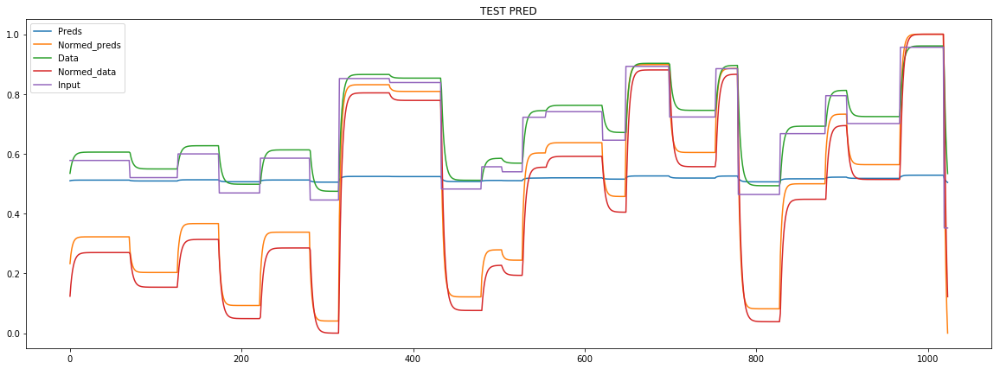

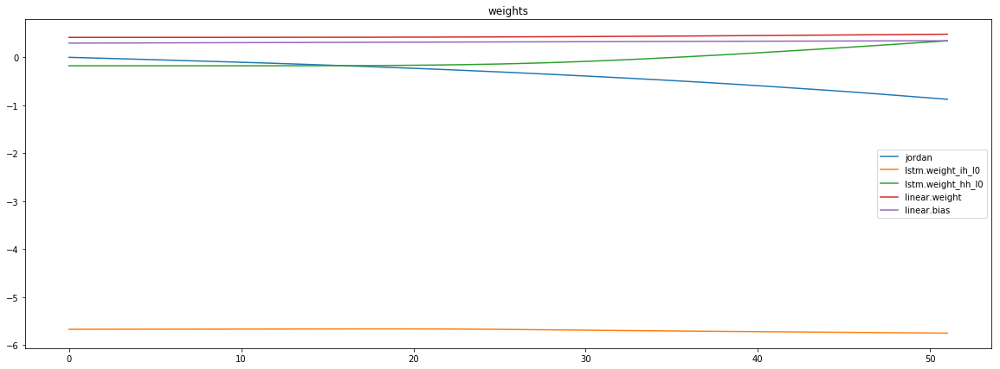

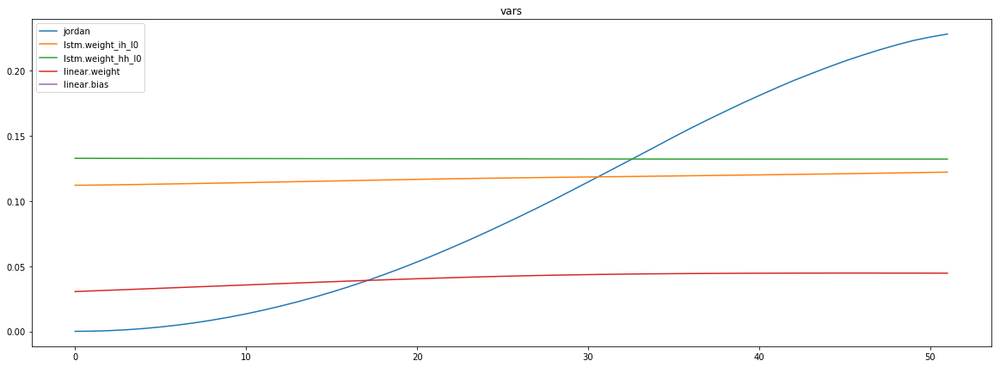

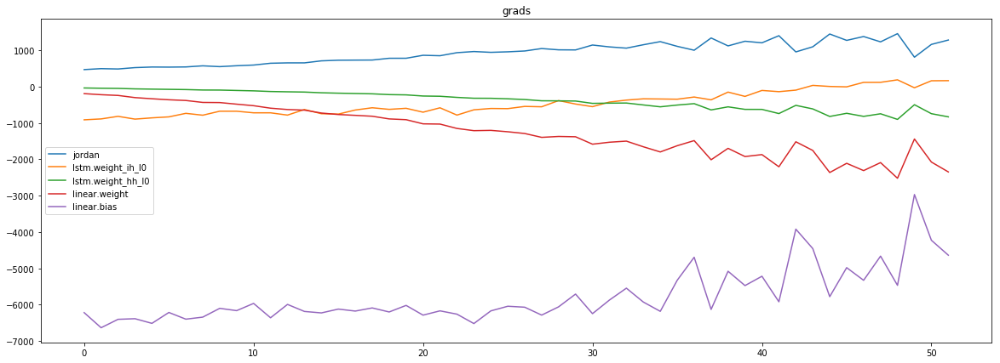

mean_p1 : -53.21260513429745
mean_p2 : 227.35322468097394
mean_p3 : 747.4331823495718


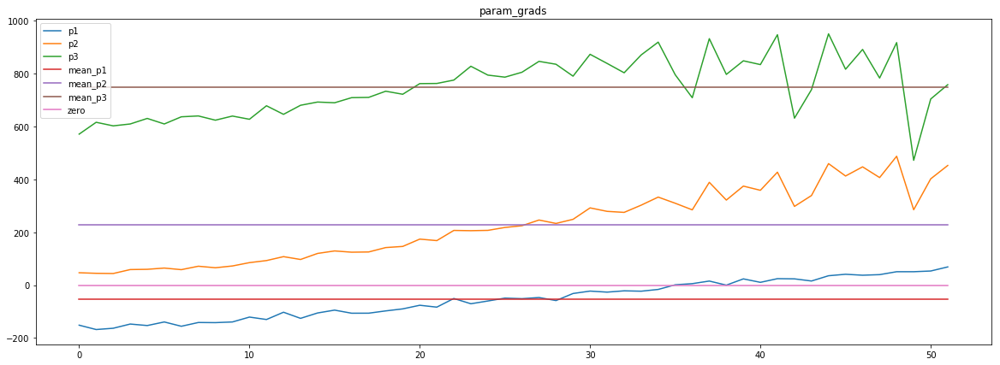

Epoch [0] 
     train_loss[10489.34970327524] 
     eval_train[9876.573692908654] 
     eval_test[10138.98868075284]



aux preds: -0.2816191613674164           -0.975843608379364           -0.7013477087020874
main loss 0.0
aux loss 9581.279860276441
jord loss 0.0
combined loss 9581.279860276441 



Parameter containing:
tensor([[-0.2816, -0.9758, -0.7013]], requires_grad=True)


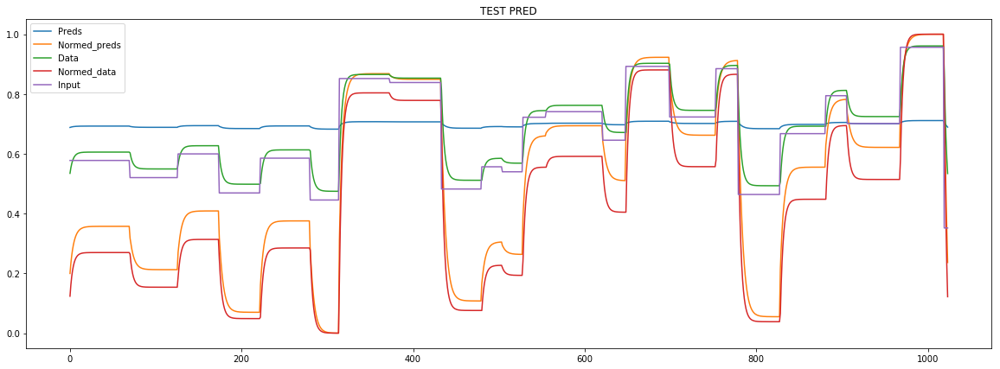

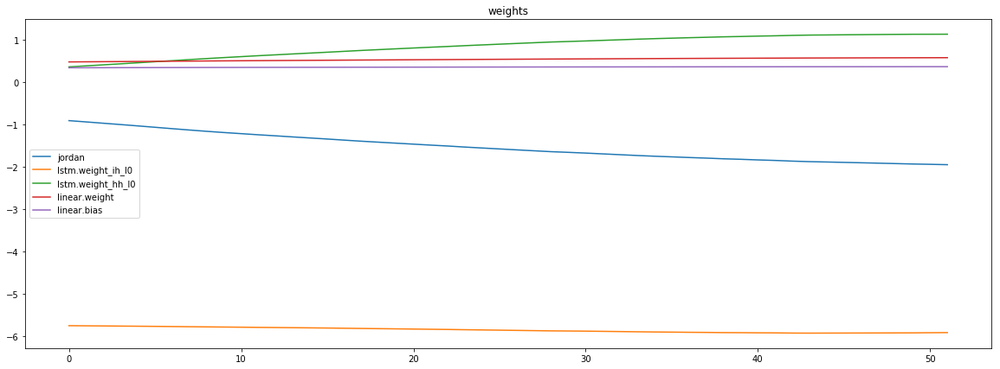

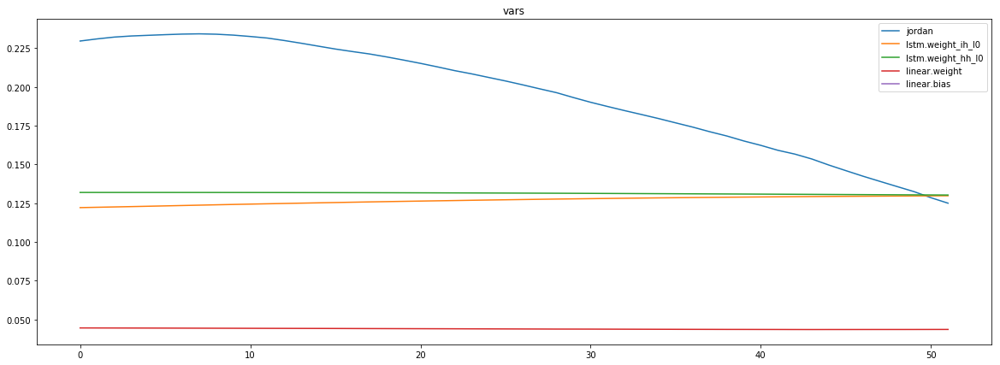

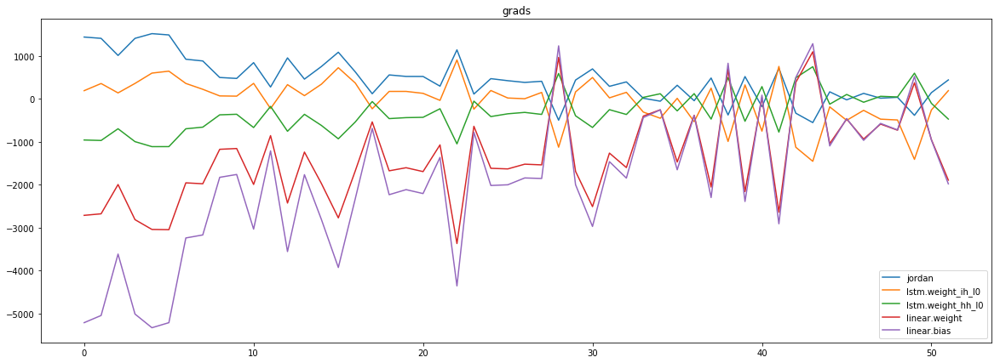

mean_p1 : 76.66285155369685
mean_p2 : 208.55624415324286
mean_p3 : 168.35915211530832


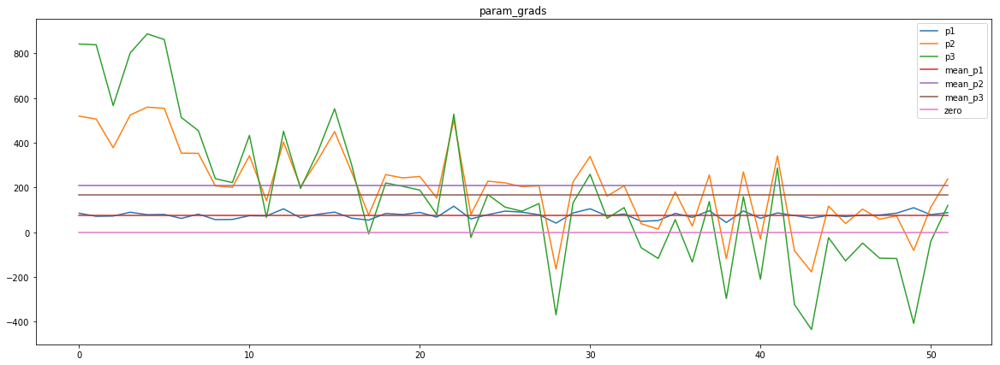

Epoch [1] 
     train_loss[9581.279860276441] 
     eval_train[9435.787616436299] 
     eval_test[9647.798805930397]



aux preds: -0.7159247398376465           -1.2957446575164795           -0.614296019077301
main loss 0.0
aux loss 9343.82303560697
jord loss 0.0
combined loss 9343.82303560697 



Parameter containing:
tensor([[-0.7159, -1.2957, -0.6143]], requires_grad=True)


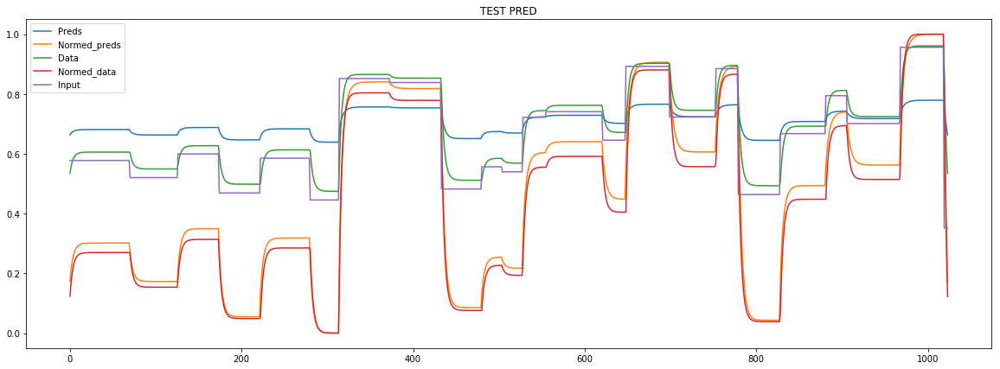

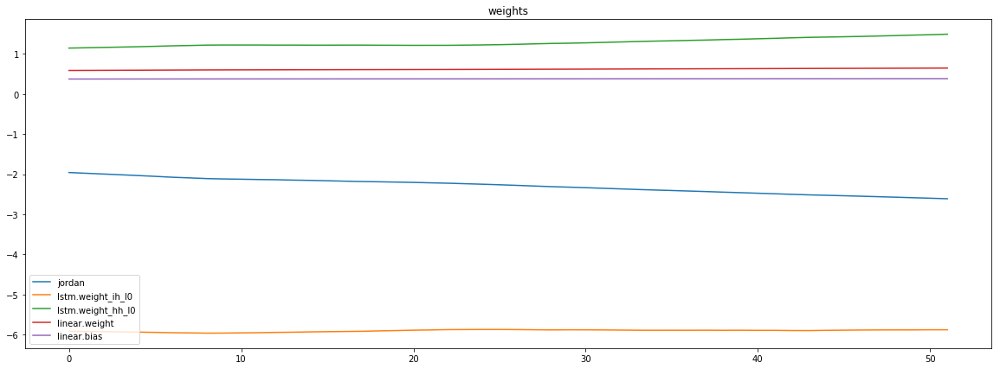

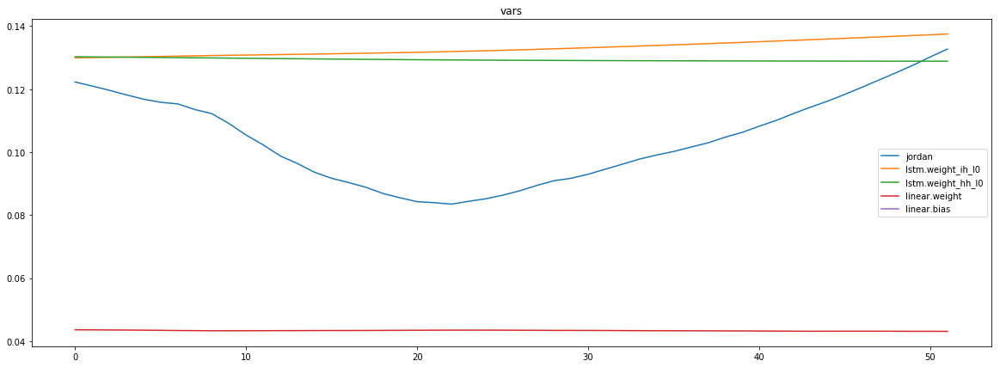

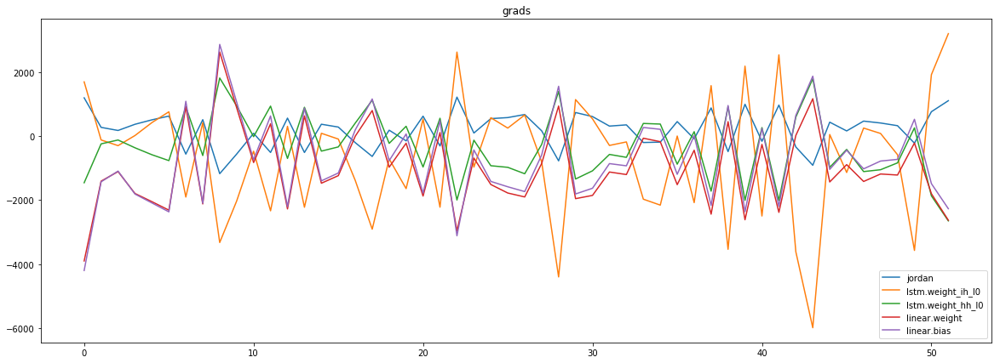

mean_p1 : 104.54009298177866
mean_p2 : 133.0928401855322
mean_p3 : -47.991861196664665


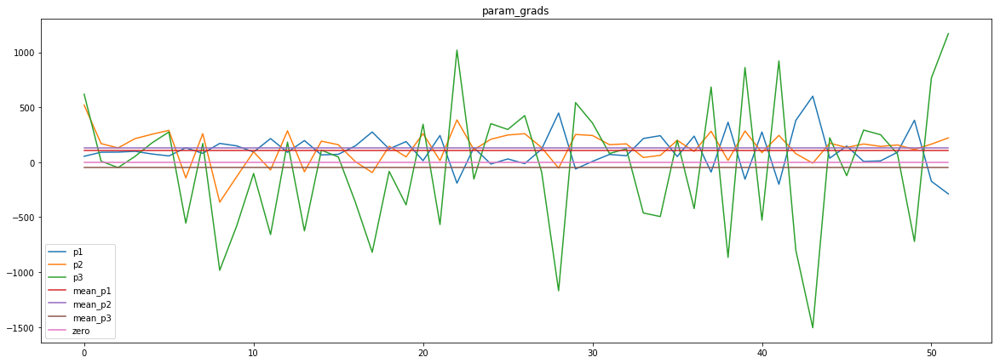

Epoch [2] 
     train_loss[9343.82303560697] 
     eval_train[9229.920381986178] 
     eval_test[9441.266379616478]



aux preds: -0.9073372483253479           -1.7159827947616577           -0.6020832657814026
main loss 0.0
aux loss 9100.080547626201
jord loss 0.0
combined loss 9100.080547626201 



Parameter containing:
tensor([[-0.9073, -1.7160, -0.6021]], requires_grad=True)


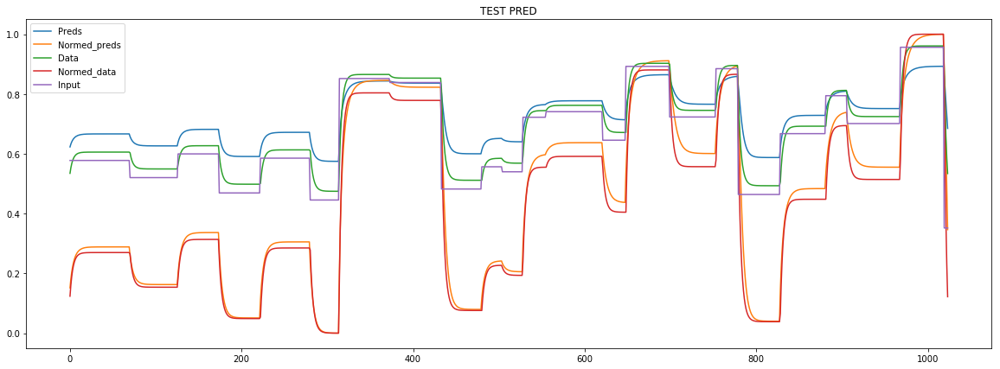

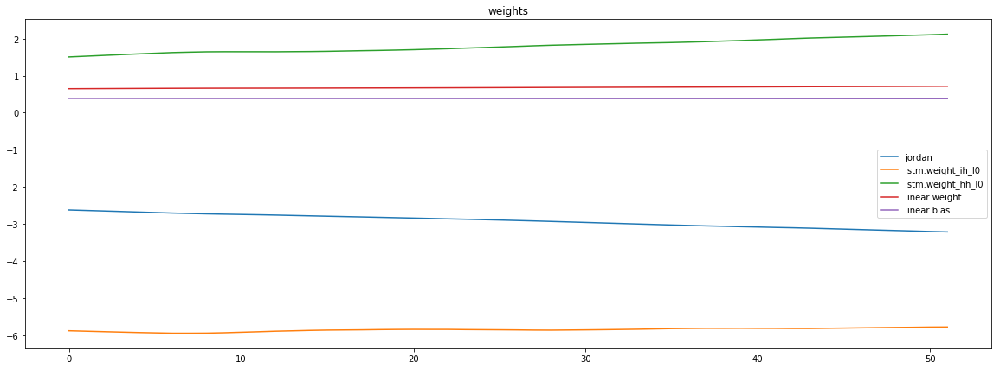

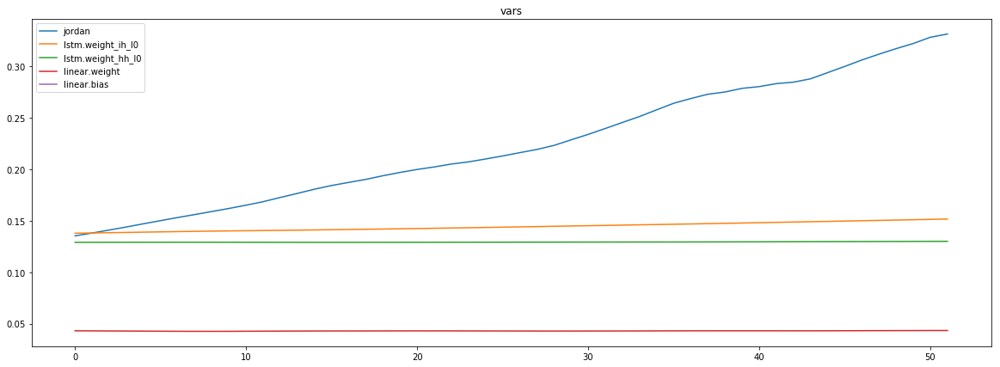

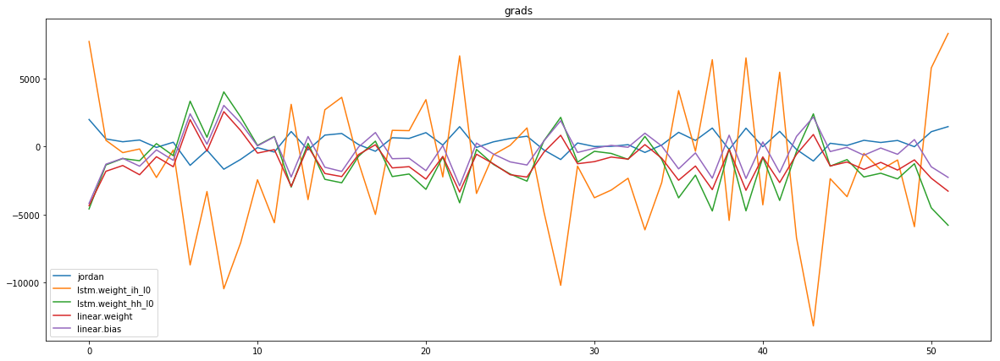

mean_p1 : 146.96651411056519
mean_p2 : 120.32450283490695
mean_p3 : -14.20888431255634


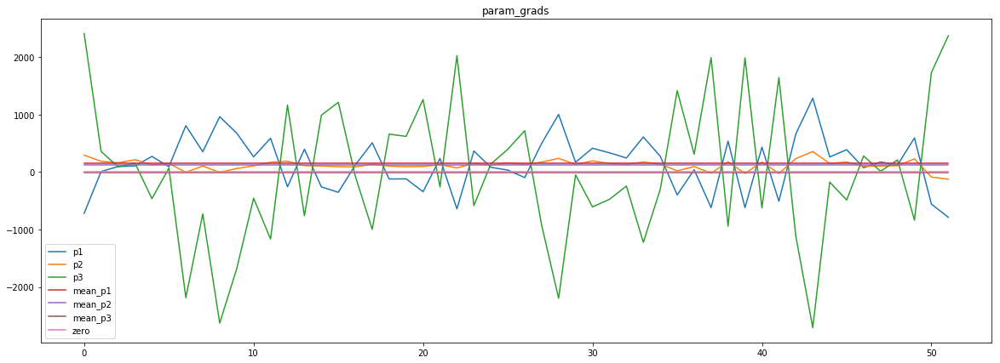

Epoch [3] 
     train_loss[9100.080547626201] 
     eval_train[8896.4501953125] 
     eval_test[9104.585715553978]



aux preds: -0.9854031205177307           -1.8687264919281006           -0.594014048576355
main loss 0.0
aux loss 8684.562434269832
jord loss 0.0
combined loss 8684.562434269832 



Parameter containing:
tensor([[-0.9854, -1.8687, -0.5940]], requires_grad=True)


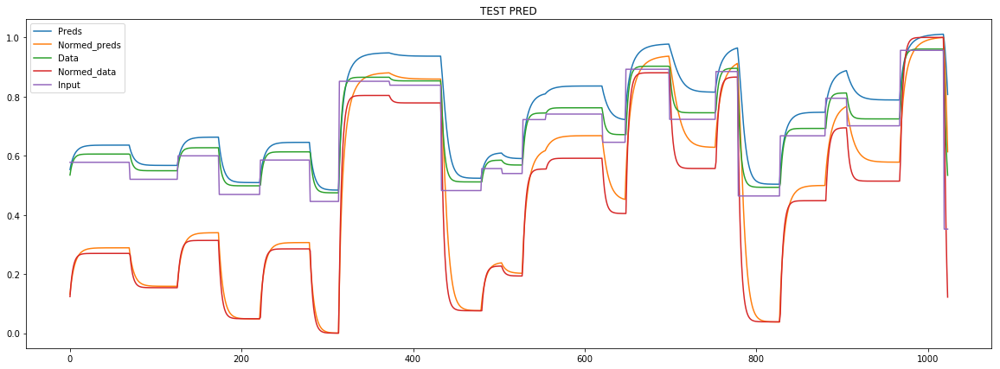

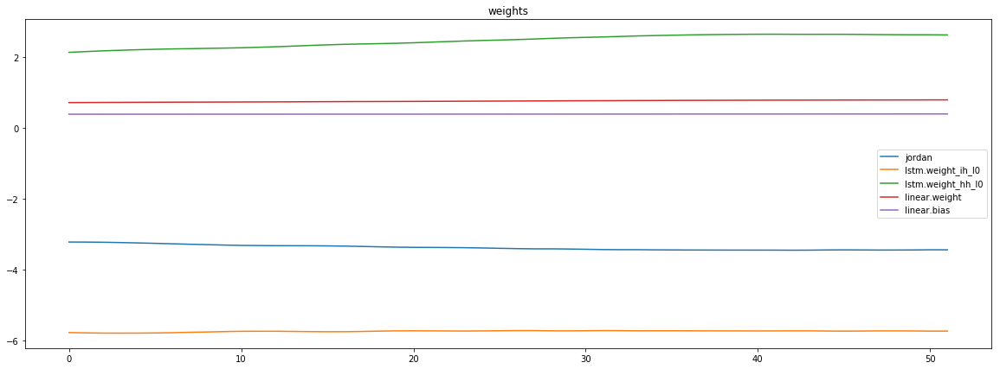

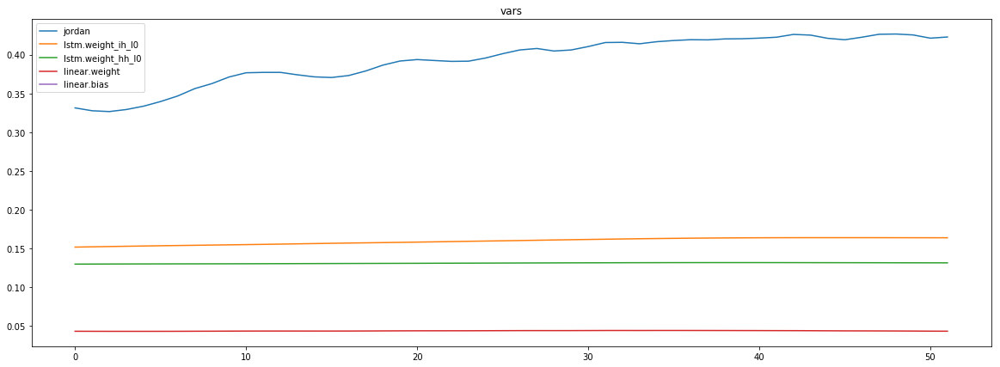

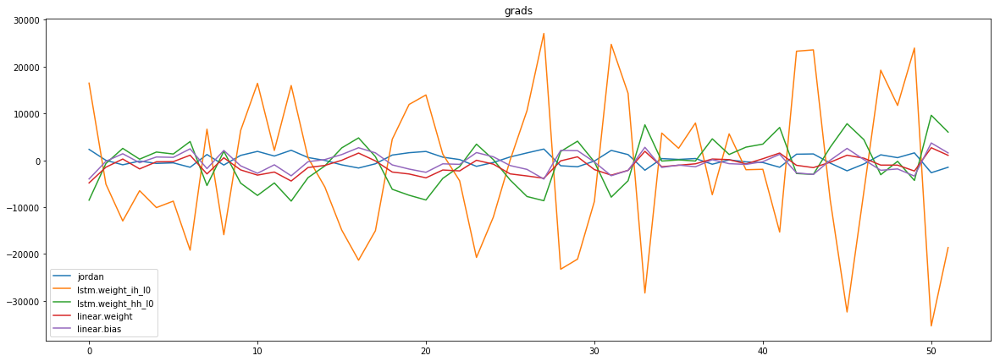

mean_p1 : 186.1821936093844
mean_p2 : 89.63417287973257
mean_p3 : -181.42279346172626


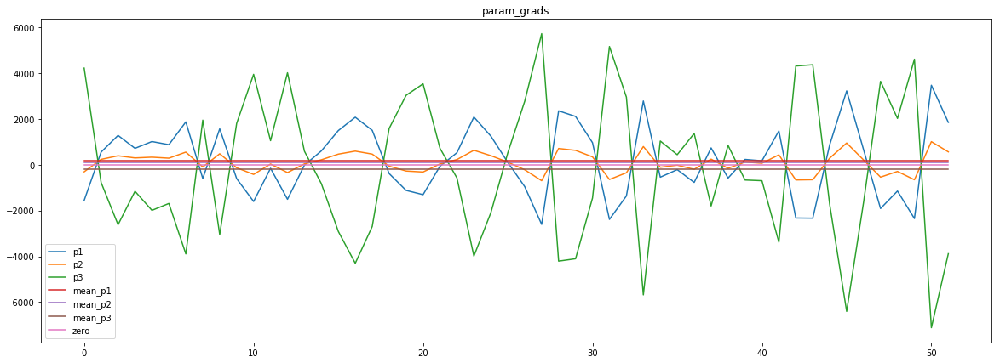

loss rate [0.06548103953974371]
Epoch [4] 
     train_loss[8684.562434269832] 
     eval_train[8572.44365985577] 
     eval_test[8782.500443892046]



aux preds: -0.9865133762359619           -1.8863348960876465           -0.5937064290046692
main loss 0.0
aux loss 8561.204552283654
jord loss 0.0
combined loss 8561.204552283654 



Parameter containing:
tensor([[-0.9865, -1.8863, -0.5937]], requires_grad=True)


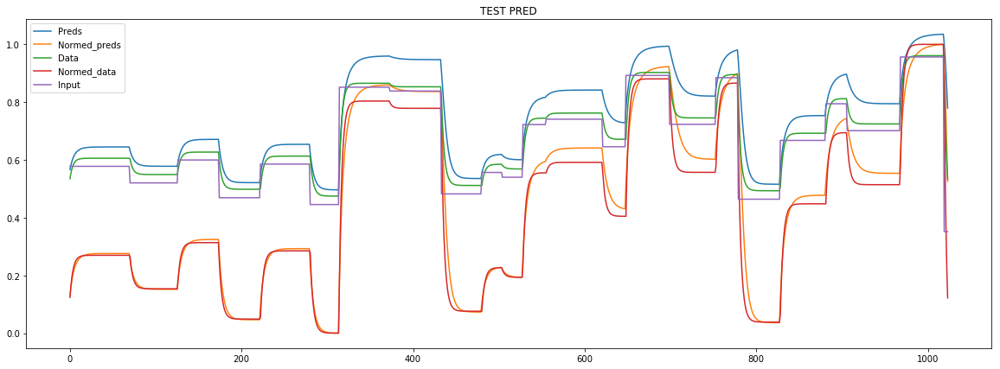

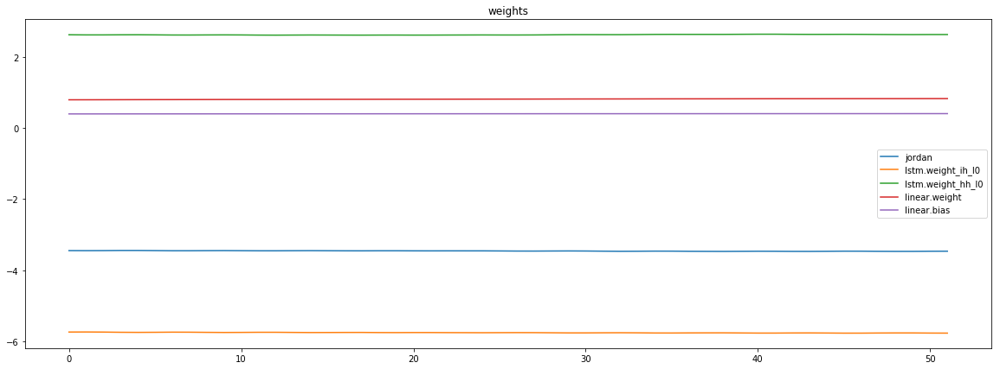

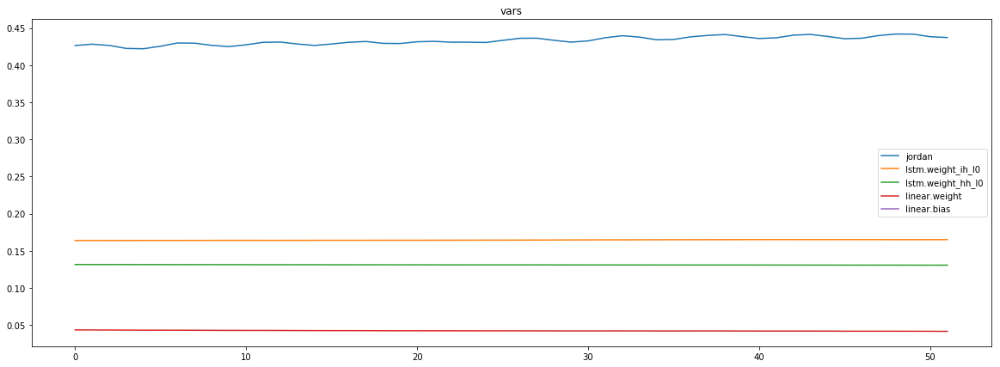

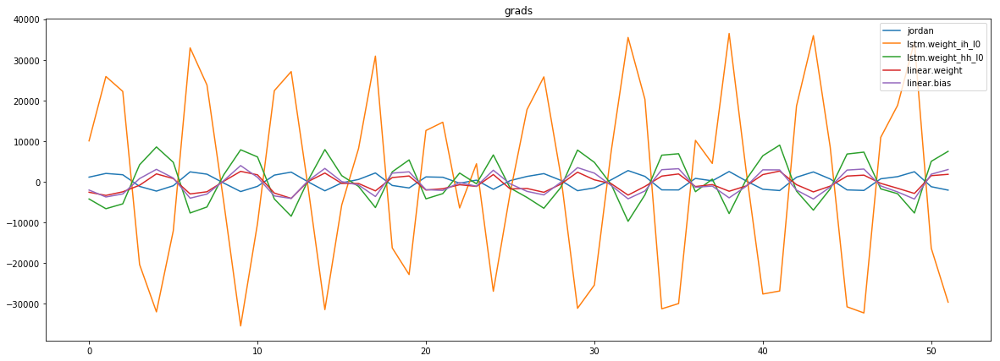

mean_p1 : -3.5223905123197117
mean_p2 : 17.072046169867882
mean_p3 : 21.510634202223557


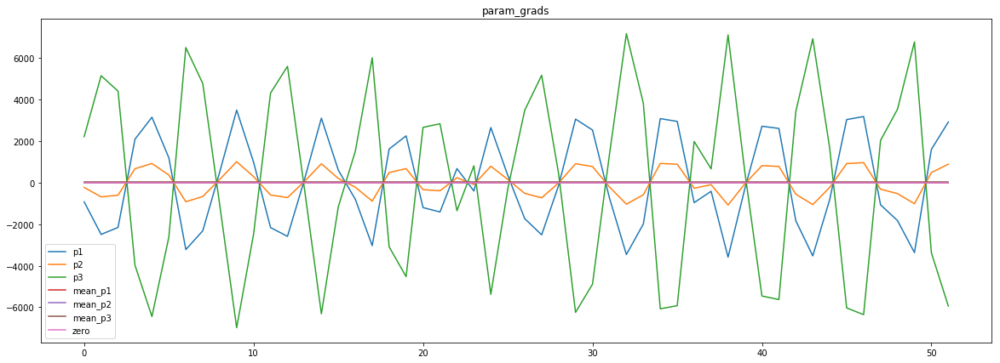

loss rate [0.039441209626863705]
Epoch [5] 
     train_loss[8561.204552283654] 
     eval_train[8542.713698167066] 
     eval_test[8750.1630859375]



aux preds: -0.9874721765518188           -1.8968647718429565           -0.5936760306358337
main loss 0.0
aux loss 8548.534808819111
jord loss 0.0
combined loss 8548.534808819111 



Parameter containing:
tensor([[-0.9875, -1.8969, -0.5937]], requires_grad=True)


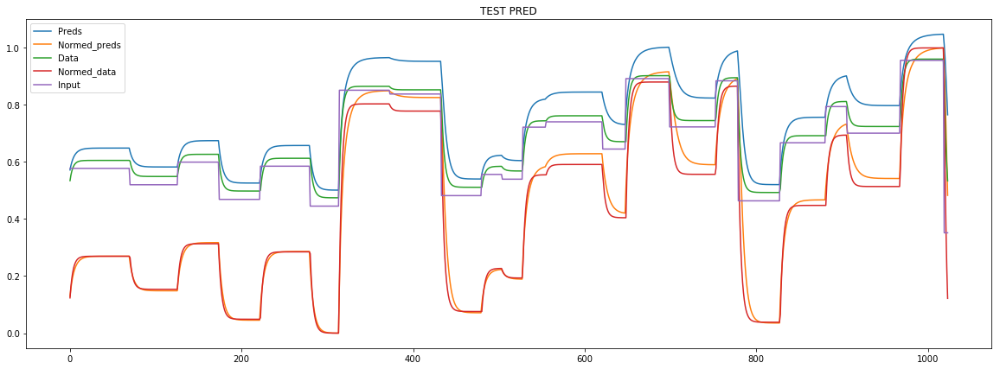

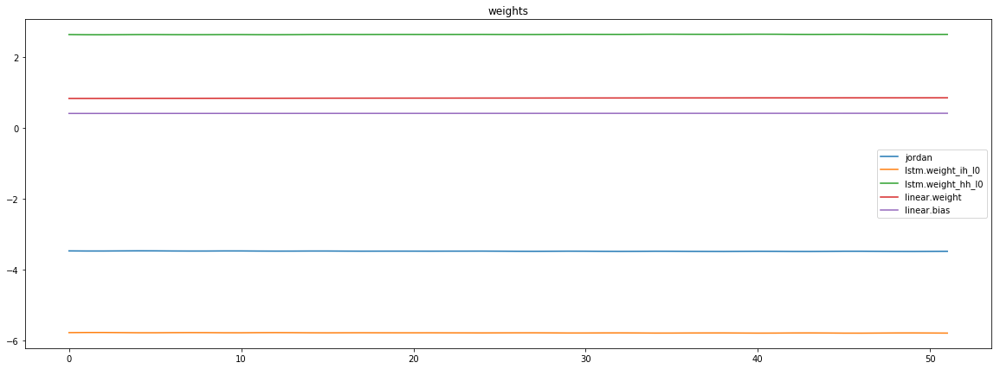

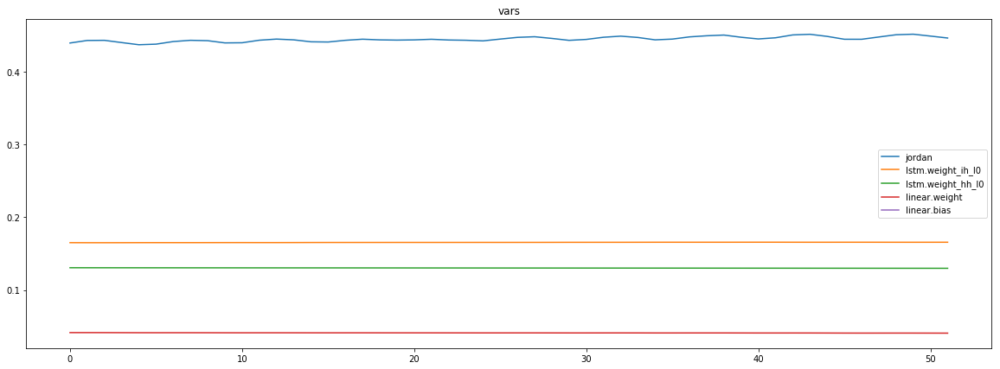

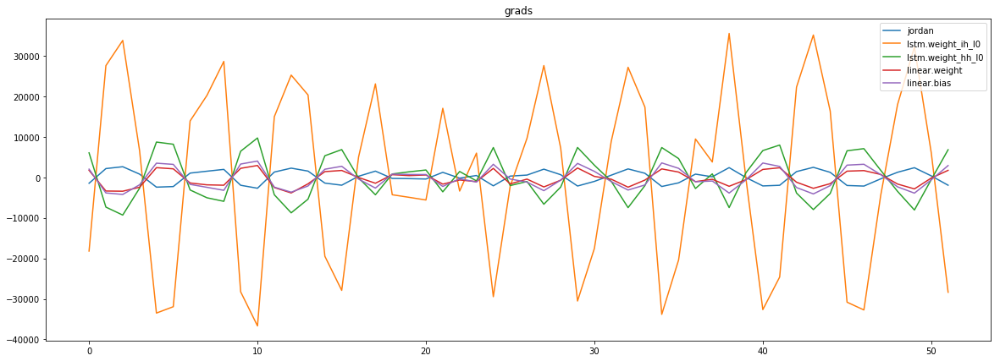

mean_p1 : -13.17800287099985
mean_p2 : 8.059790317828838
mean_p3 : 39.12137574415941


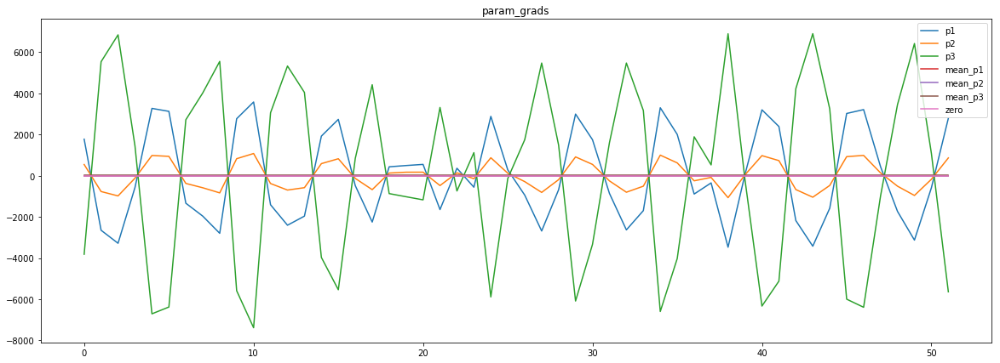

loss rate [0.015050220031630257]
Epoch [6] 
     train_loss[8548.534808819111] 
     eval_train[8540.965435321514] 
     eval_test[8745.450927734375]



aux preds: -0.9896947145462036           -1.9073545932769775           -0.5923389792442322
main loss 0.0
aux loss 8542.74472280649
jord loss 0.0
combined loss 8542.74472280649 



Parameter containing:
tensor([[-0.9897, -1.9074, -0.5923]], requires_grad=True)


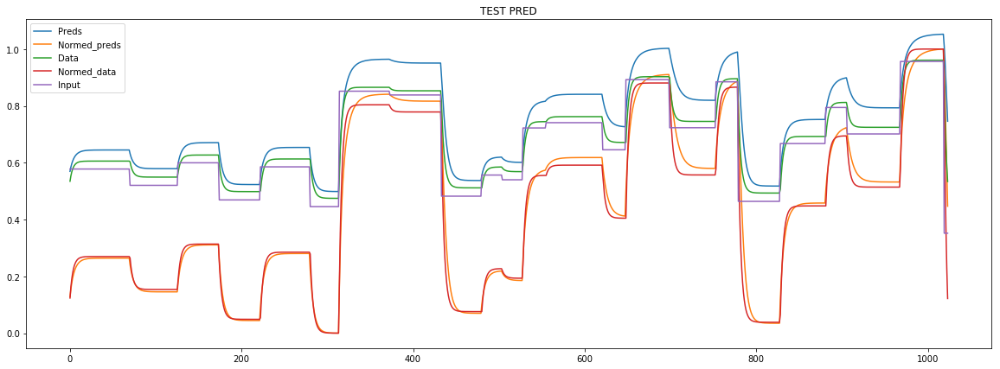

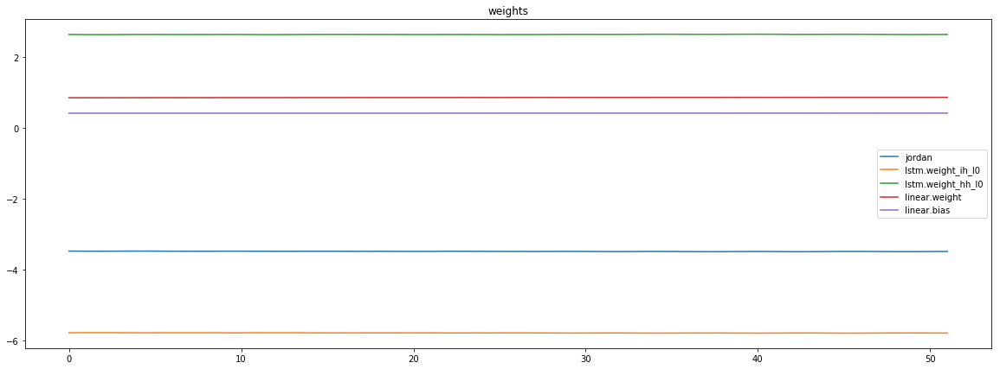

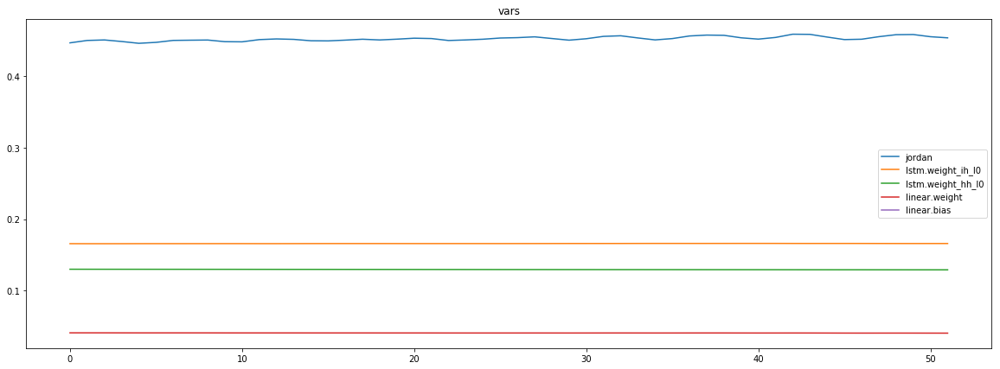

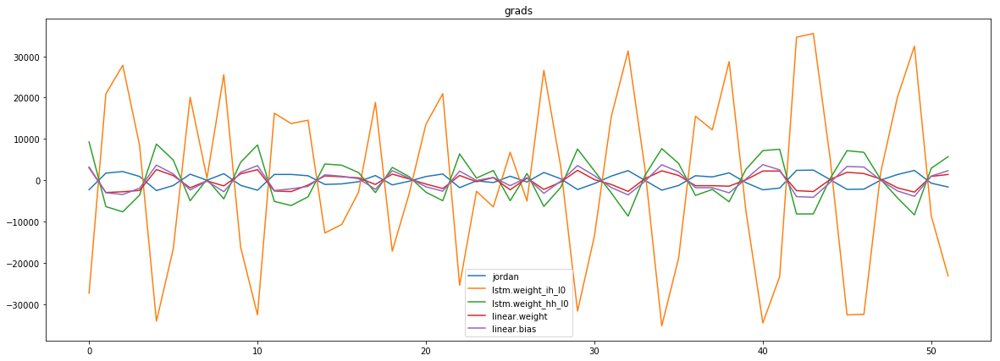

mean_p1 : 15.426687680757963
mean_p2 : 14.497392617739164
mean_p3 : -25.83221750992995


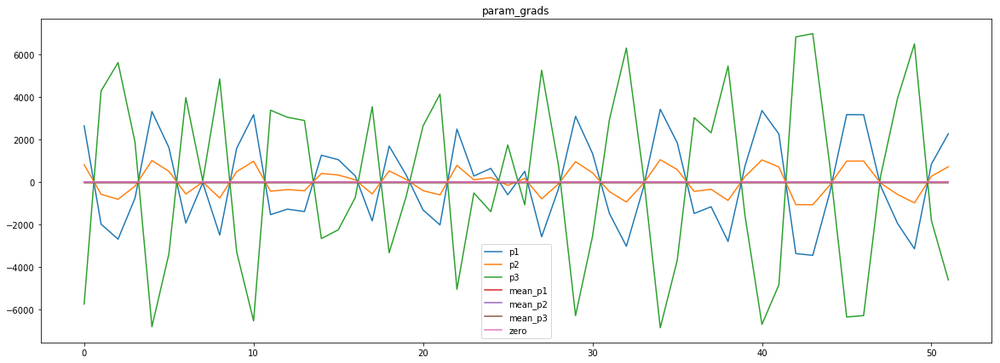

loss rate [0.002333087813970125]
Epoch [7] 
     train_loss[8542.74472280649] 
     eval_train[8534.019766000602] 
     eval_test[8738.935102982954]



aux preds: -0.9918129444122314           -1.9161713123321533           -0.5903742909431458
main loss 0.0
aux loss 8539.678513746996
jord loss 0.0
combined loss 8539.678513746996 



Parameter containing:
tensor([[-0.9918, -1.9162, -0.5904]], requires_grad=True)


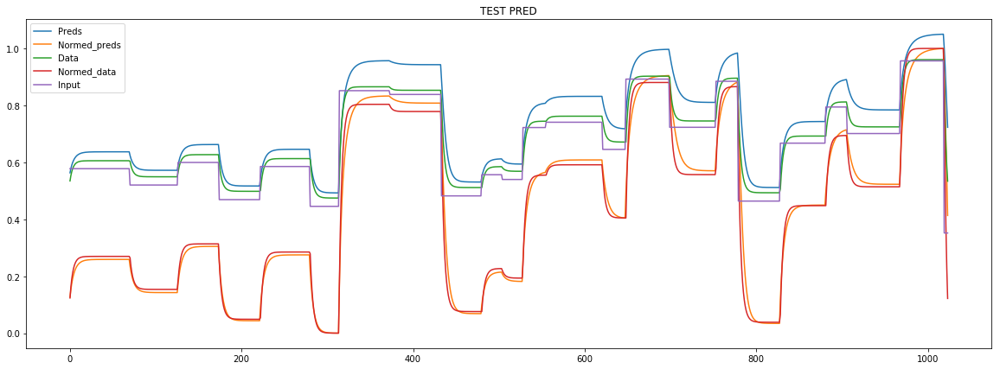

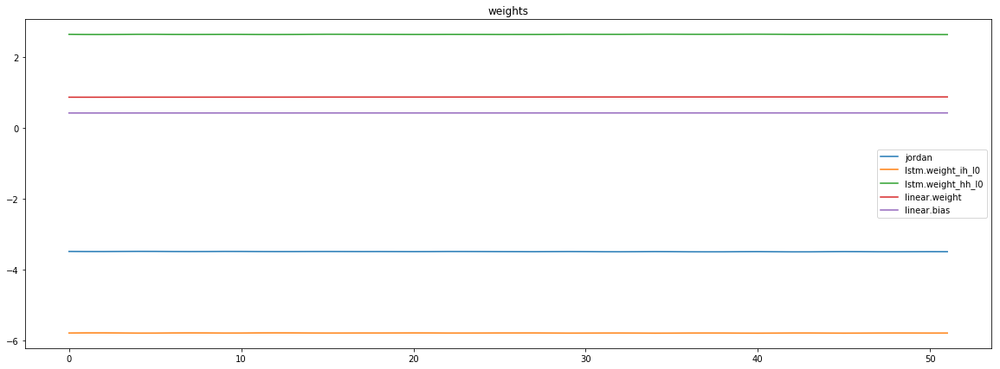

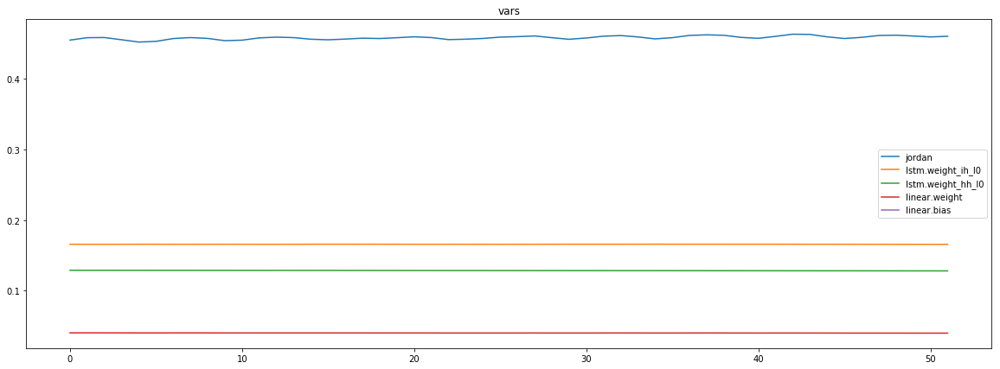

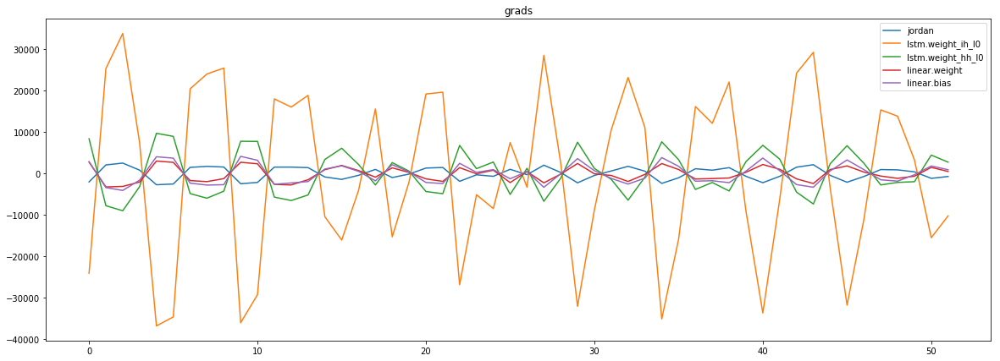

mean_p1 : 17.55075924213116
mean_p2 : 14.304275879493126
mean_p3 : -34.11057574932392


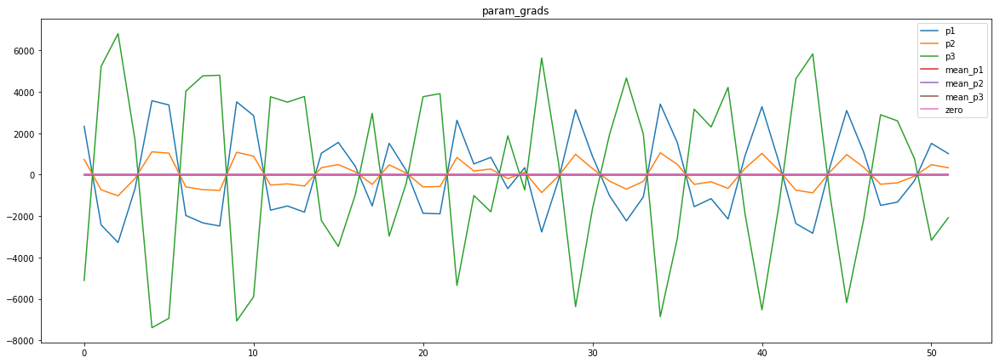

loss rate [0.00026425947439345787]
Epoch [8] 
     train_loss[8539.678513746996] 
     eval_train[8537.777493990385] 
     eval_test[8742.538796164772]



aux preds: -0.9920799732208252           -1.9223532676696777           -0.5907588601112366
main loss 0.0
aux loss 8539.165705754207
jord loss 0.0
combined loss 8539.165705754207 



Parameter containing:
tensor([[-0.9921, -1.9224, -0.5908]], requires_grad=True)


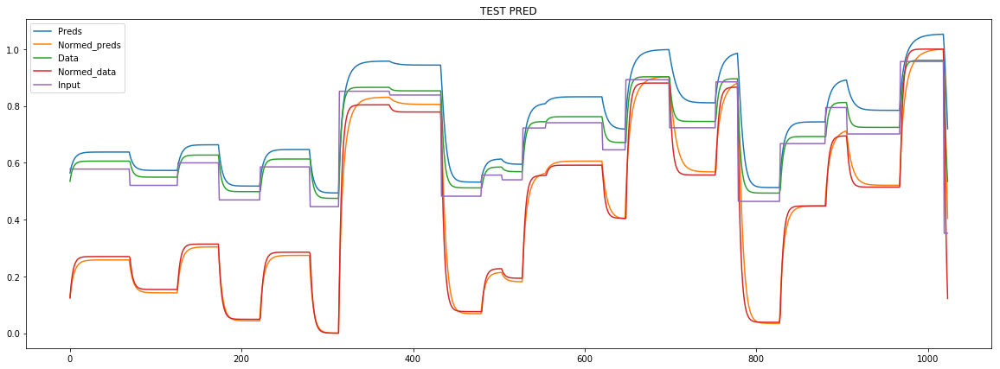

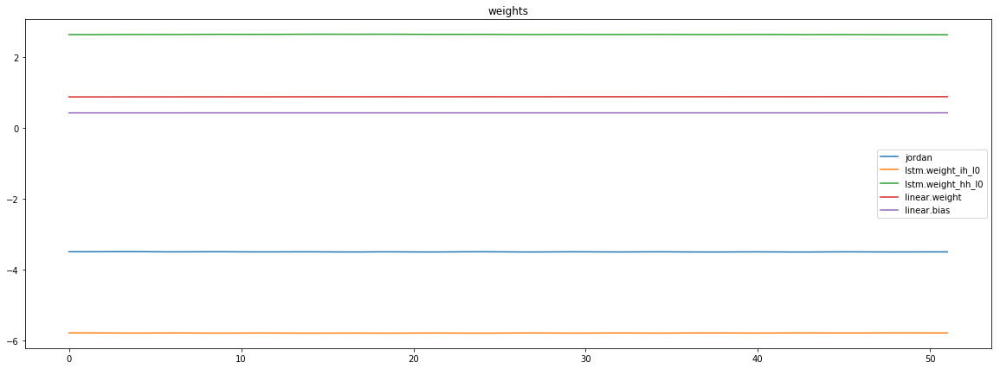

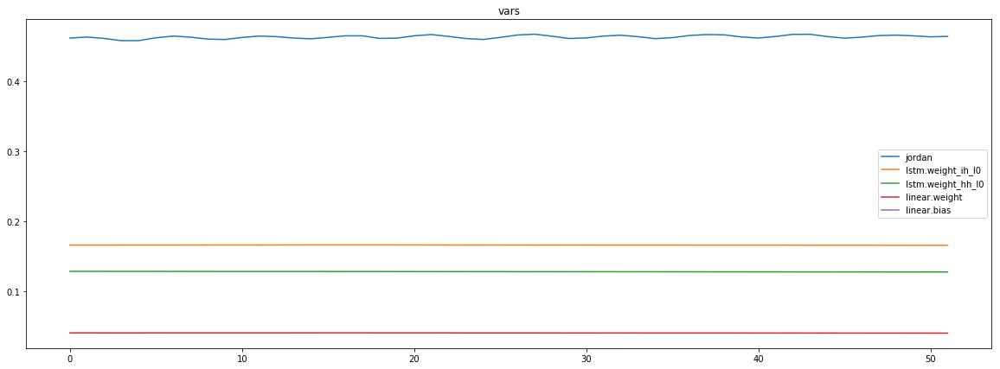

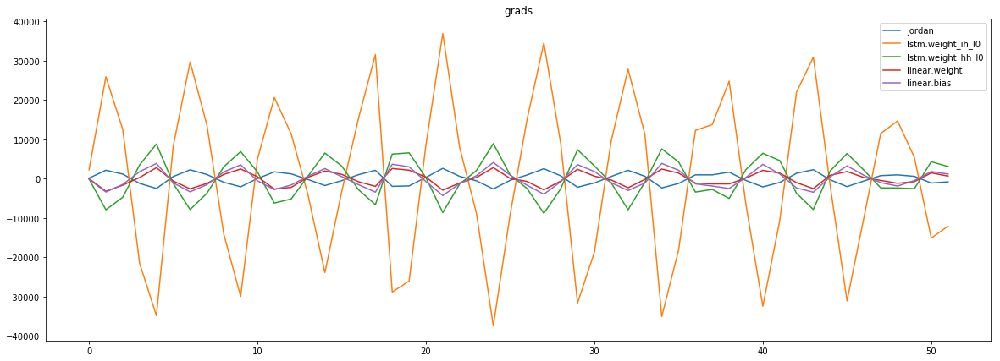

mean_p1 : 3.3467530470628004
mean_p2 : 8.076356447660006
mean_p3 : -0.9753065842848557


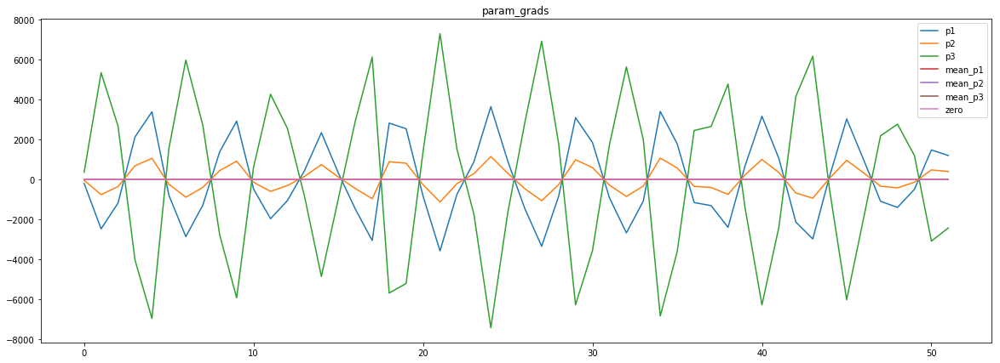

Epoch     9: reducing learning rate of group 0 to 4.0000e-03.
Epoch     9: reducing learning rate of group 1 to 4.0000e-04.
Epoch     9: reducing learning rate of group 2 to 4.0000e-04.
loss rate [0.00025655331106577695]
Epoch [9] 
     train_loss[8539.165705754207] 
     eval_train[8535.487595778246] 
     eval_test[8740.065407492897]



aux preds: -0.9914365410804749           -1.9261606931686401           -0.5915905833244324
main loss 0.0
aux loss 8533.279437725361
jord loss 0.0
combined loss 8533.279437725361 



Parameter containing:
tensor([[-0.9914, -1.9262, -0.5916]], requires_grad=True)


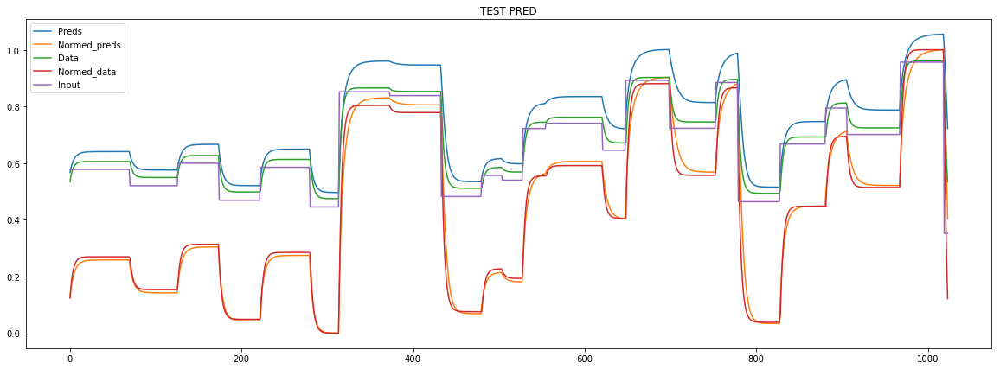

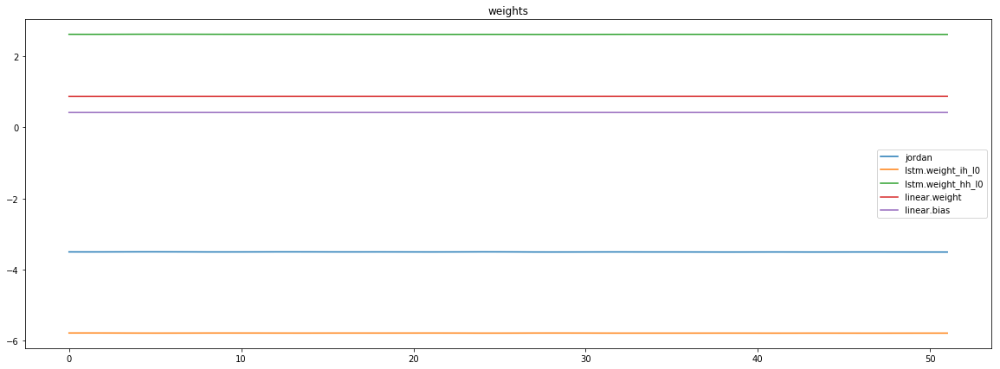

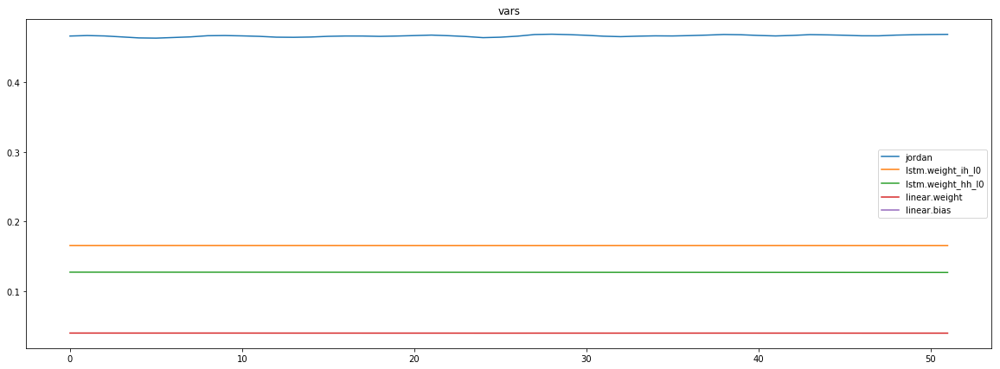

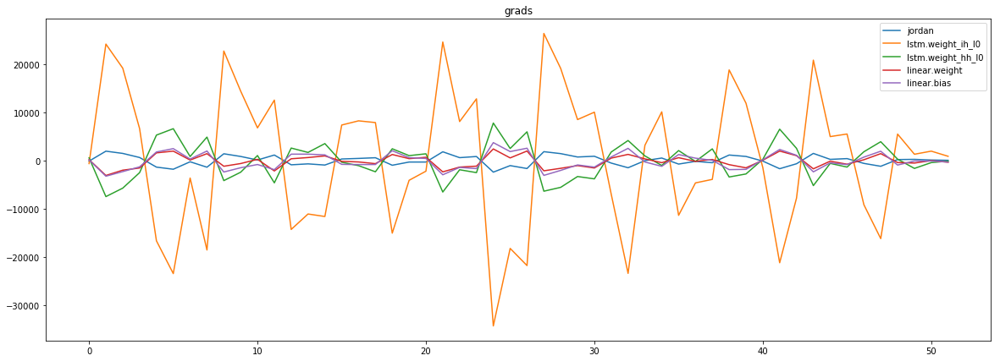

mean_p1 : -28.930014536930965
mean_p2 : 1.9620336752671461
mean_p3 : 64.1390621478741


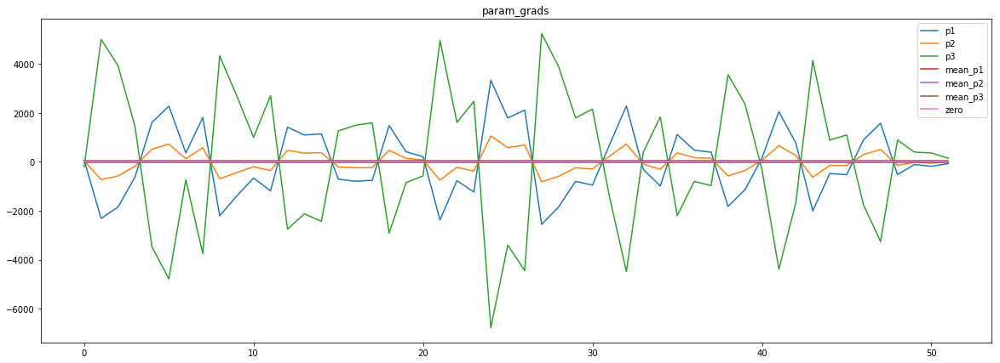

loss rate [0.0005204387950467071]
Epoch [10] 
     train_loss[8533.279437725361] 
     eval_train[8531.45840219351] 
     eval_test[8735.964200106535]



aux preds: -0.9916954040527344           -1.9312419891357422           -0.5917432308197021
main loss 0.0
aux loss 8533.303983248197
jord loss 0.0
combined loss 8533.303983248197 



Parameter containing:
tensor([[-0.9917, -1.9312, -0.5917]], requires_grad=True)


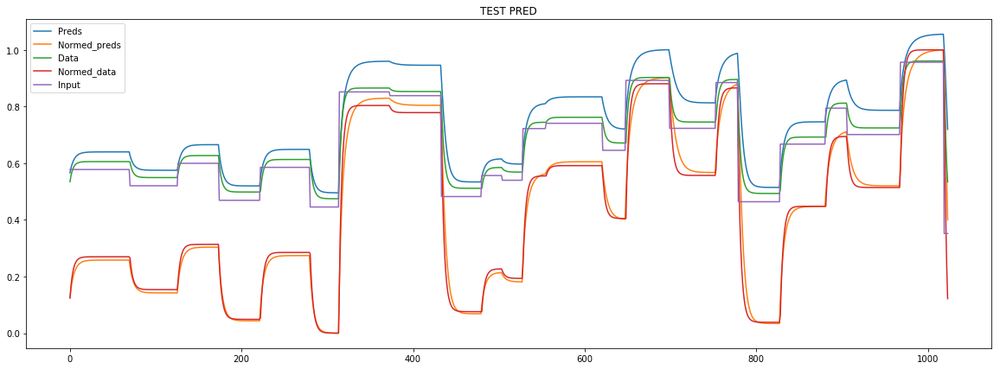

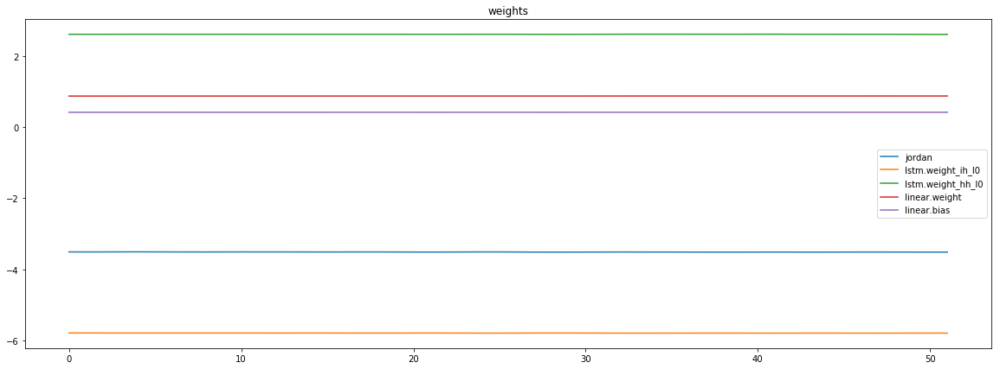

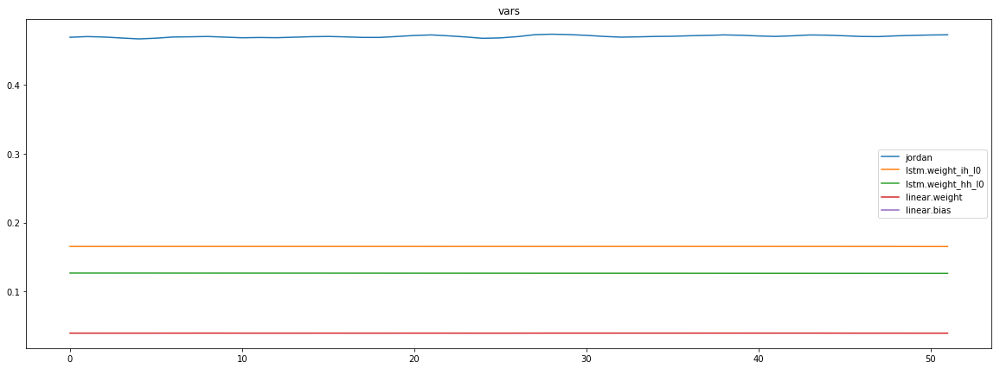

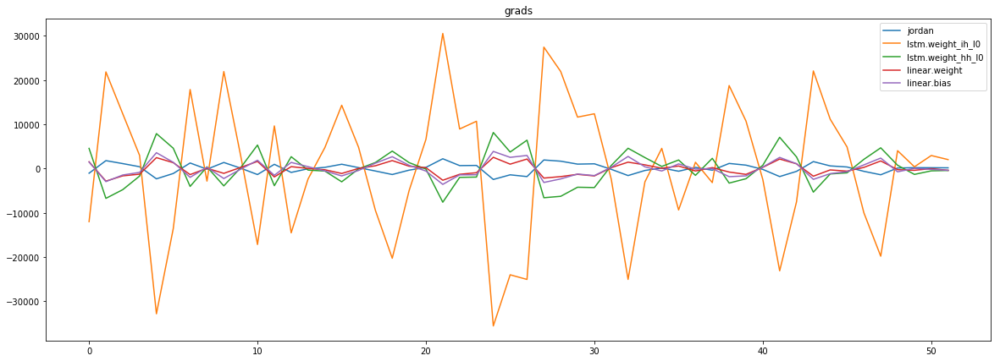

mean_p1 : 4.598964140965388
mean_p2 : 12.167115174807035
mean_p3 : -2.6419105529785156


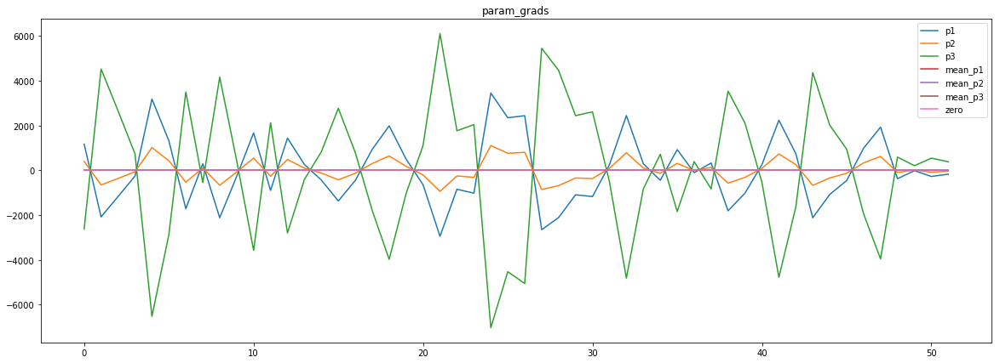

loss rate [0.000369098950969593]
Epoch [11] 
     train_loss[8533.303983248197] 
     eval_train[8531.804612379809] 
     eval_test[8736.297052556818]



aux preds: -0.9912996888160706           -1.9355287551879883           -0.5922939777374268
main loss 0.0
aux loss 8532.736431415264
jord loss 0.0
combined loss 8532.736431415264 



Parameter containing:
tensor([[-0.9913, -1.9355, -0.5923]], requires_grad=True)


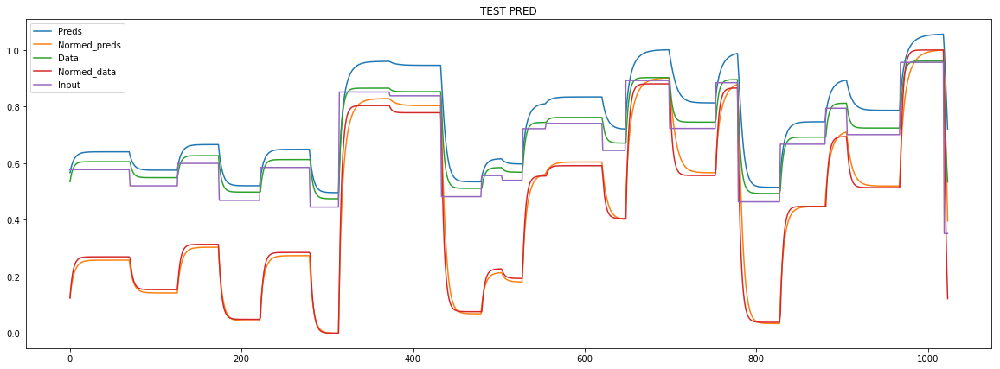

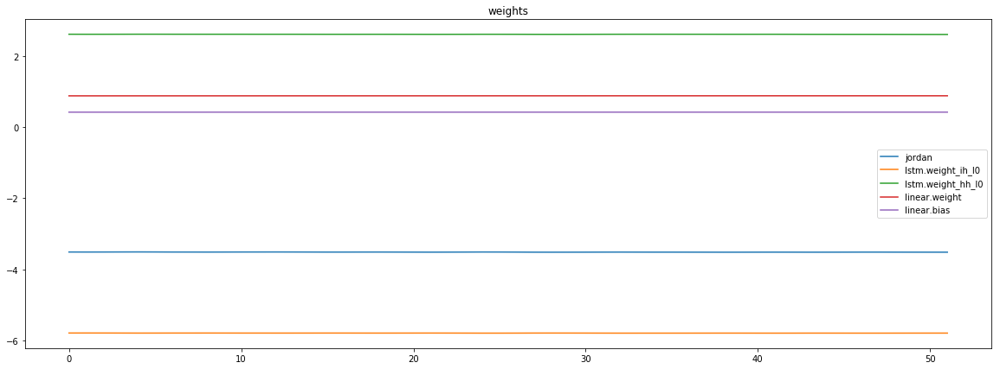

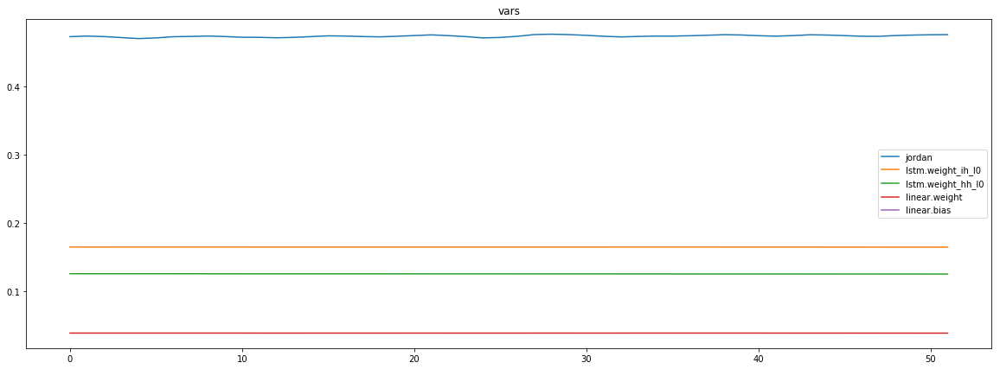

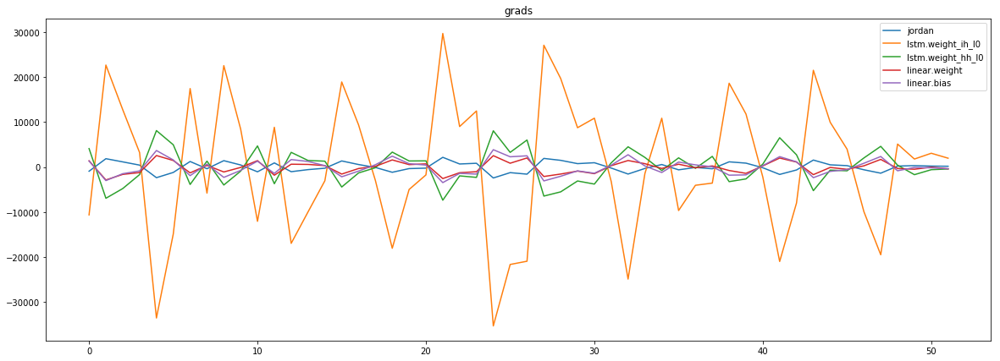

mean_p1 : -2.1819234994741588
mean_p2 : 9.89422027881329
mean_p3 : 8.41421391413762


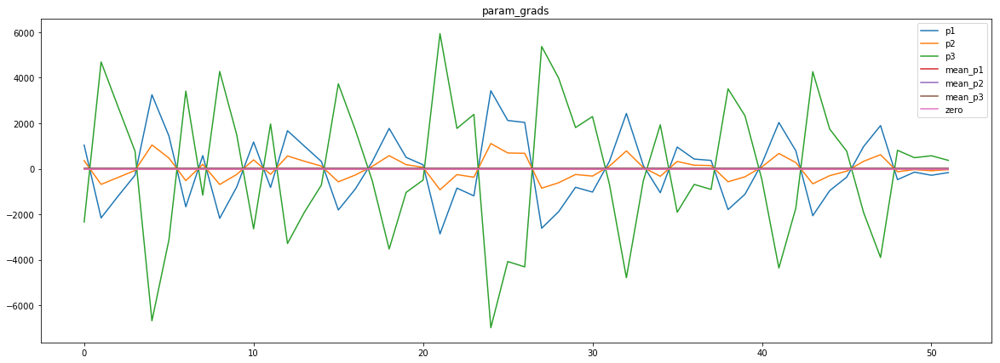

loss rate [0.00024823233906146047]
Epoch [12] 
     train_loss[8532.736431415264] 
     eval_train[8530.914137620191] 
     eval_test[8735.273304332386]



aux preds: -0.9910028576850891           -1.9397025108337402           -0.5928294658660889
main loss 0.0
aux loss 8532.510488656852
jord loss 0.0
combined loss 8532.510488656852 



Parameter containing:
tensor([[-0.9910, -1.9397, -0.5928]], requires_grad=True)


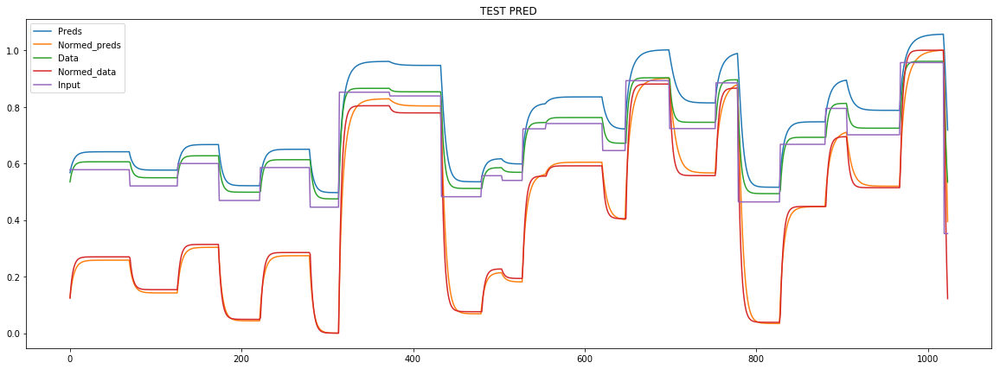

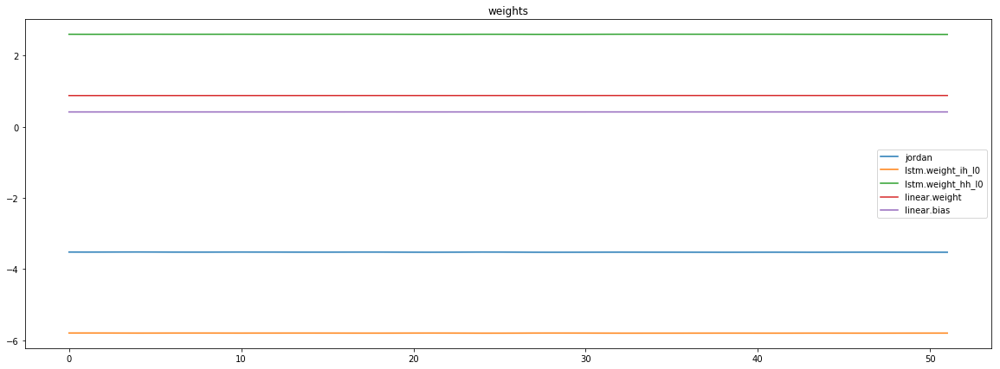

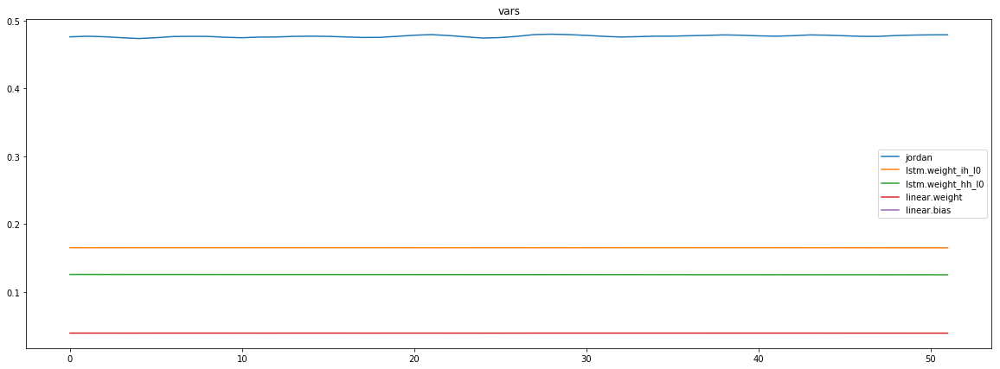

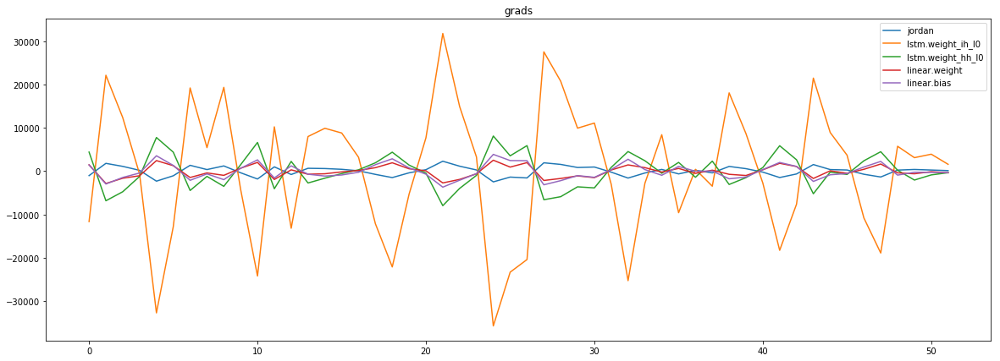

mean_p1 : -1.4373219013214111
mean_p2 : 9.685933168117817
mean_p3 : 8.23049178490272


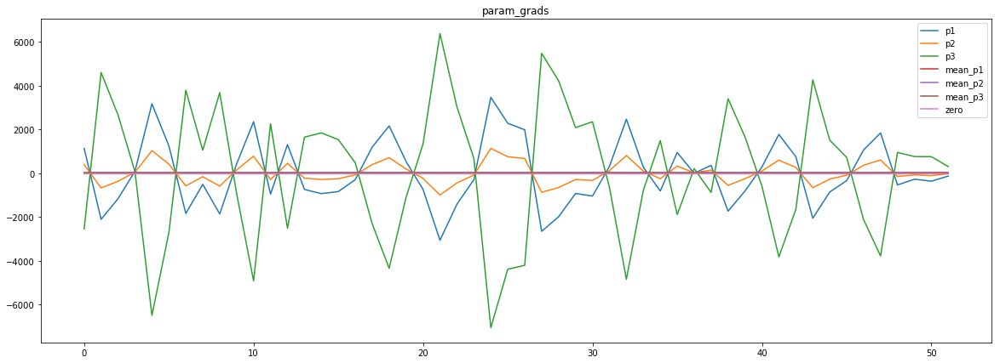

loss rate [0.0001583493755938914]
Epoch [13] 
     train_loss[8532.510488656852] 
     eval_train[8530.156400240385] 
     eval_test[8734.461536754261]



aux preds: -0.9908329248428345           -1.943792462348938           -0.5932307243347168
main loss 0.0
aux loss 8532.058922400842
jord loss 0.0
combined loss 8532.058922400842 



Parameter containing:
tensor([[-0.9908, -1.9438, -0.5932]], requires_grad=True)


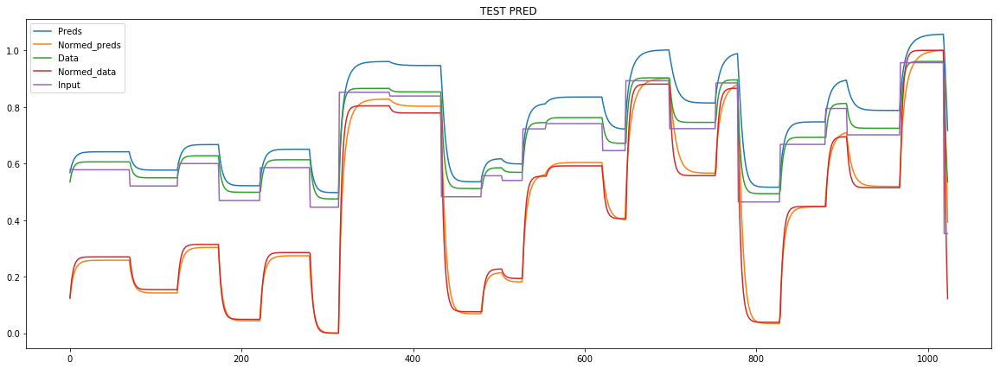

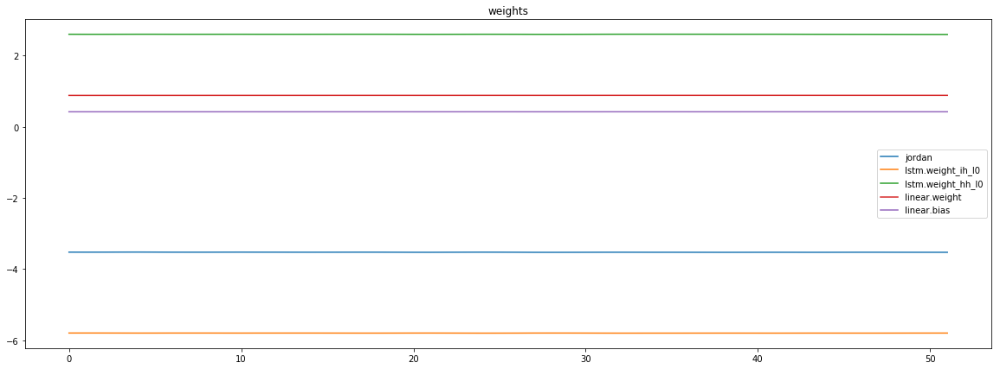

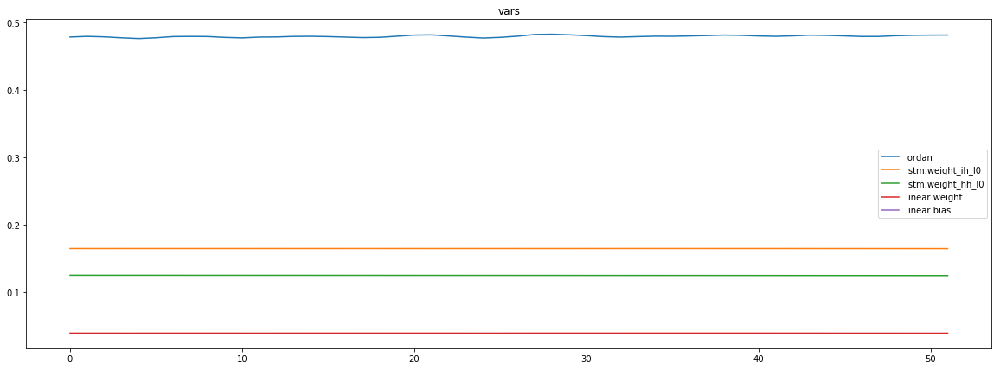

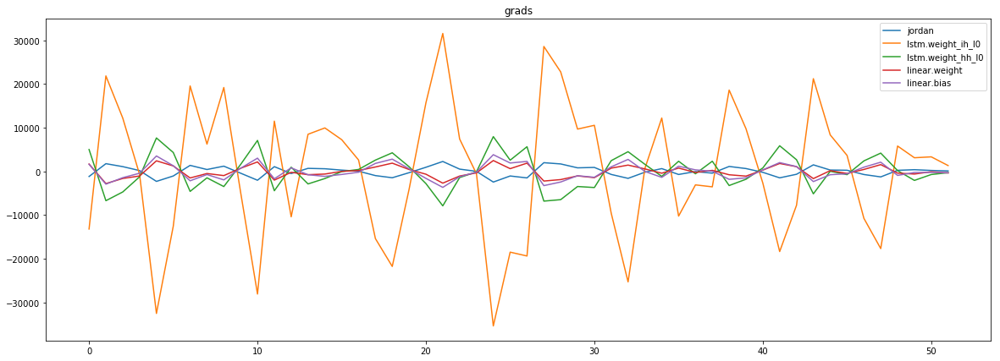

mean_p1 : 1.0906824698814979
mean_p2 : 10.138044320620024
mean_p3 : 2.7824598459097056


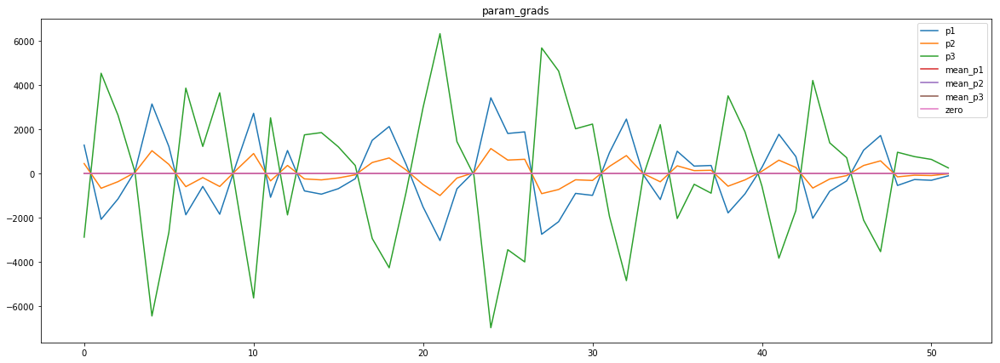

loss rate [0.00015229360943613823]
Epoch [14] 
     train_loss[8532.058922400842] 
     eval_train[8529.771230844352] 
     eval_test[8734.013627485796]



aux preds: -0.9906803369522095           -1.9477592706680298           -0.5936500430107117
main loss 0.0
aux loss 8531.79413311298
jord loss 0.0
combined loss 8531.79413311298 



Parameter containing:
tensor([[-0.9907, -1.9478, -0.5937]], requires_grad=True)


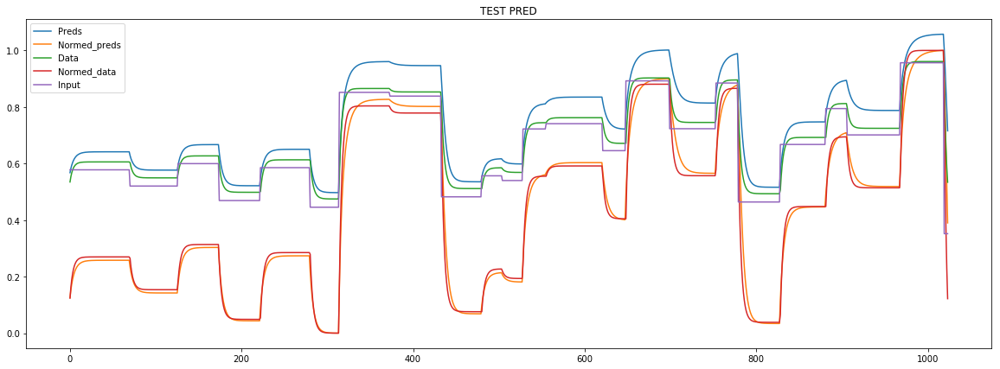

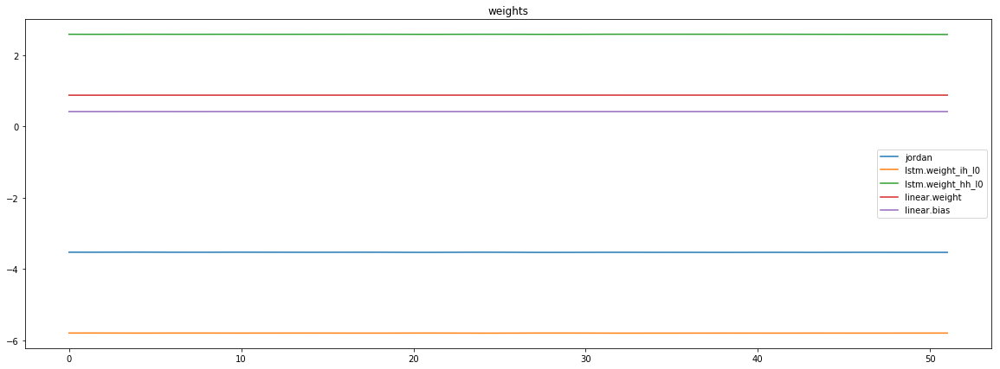

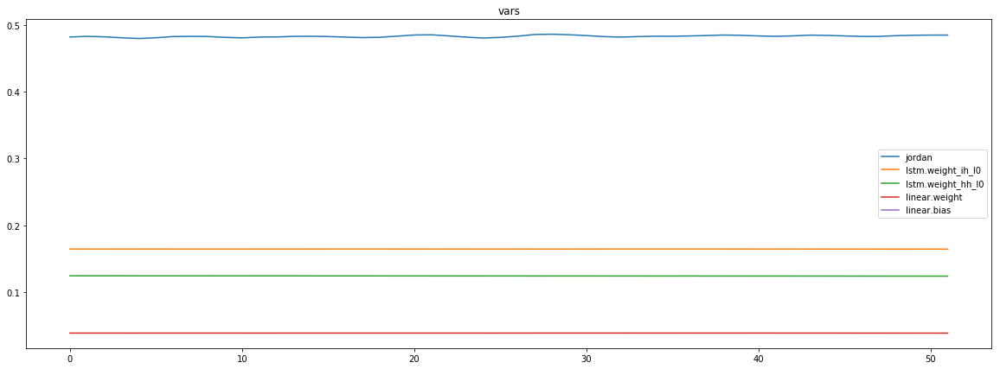

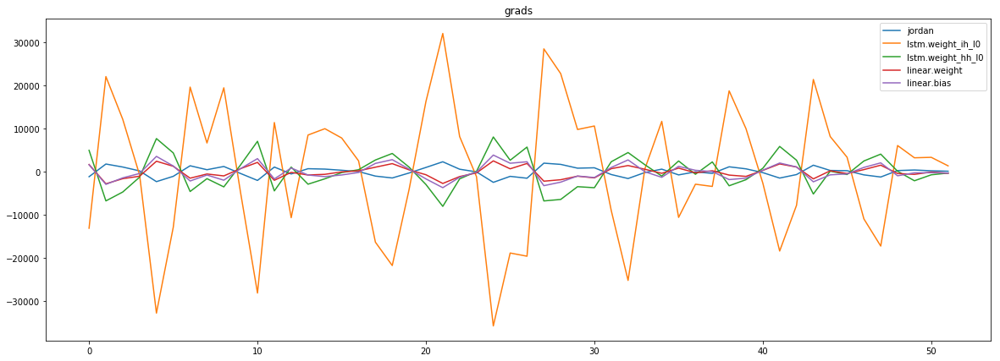

mean_p1 : 0.4769580547626202
mean_p2 : 9.720569940713736
mean_p3 : 4.678256254929763


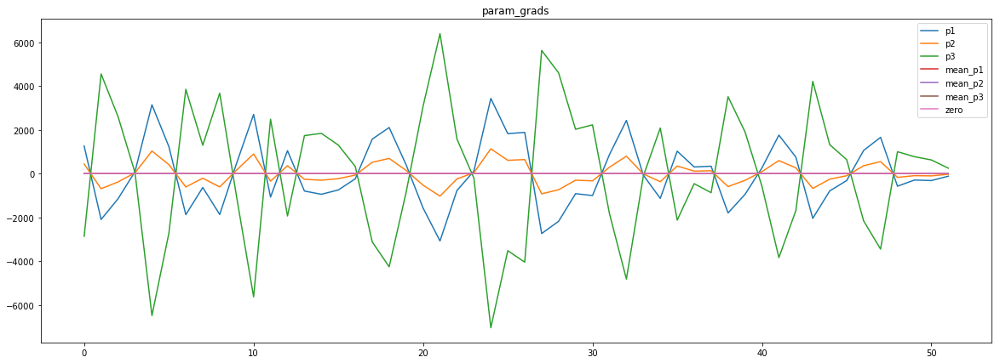

loss rate [0.00011632119418247822]
Epoch [15] 
     train_loss[8531.79413311298] 
     eval_train[8529.37060546875] 
     eval_test[8733.56680575284]



aux preds: -0.9905250668525696           -1.9515995979309082           -0.5940784215927124
main loss 0.0
aux loss 8531.505662184496
jord loss 0.0
combined loss 8531.505662184496 



Parameter containing:
tensor([[-0.9905, -1.9516, -0.5941]], requires_grad=True)


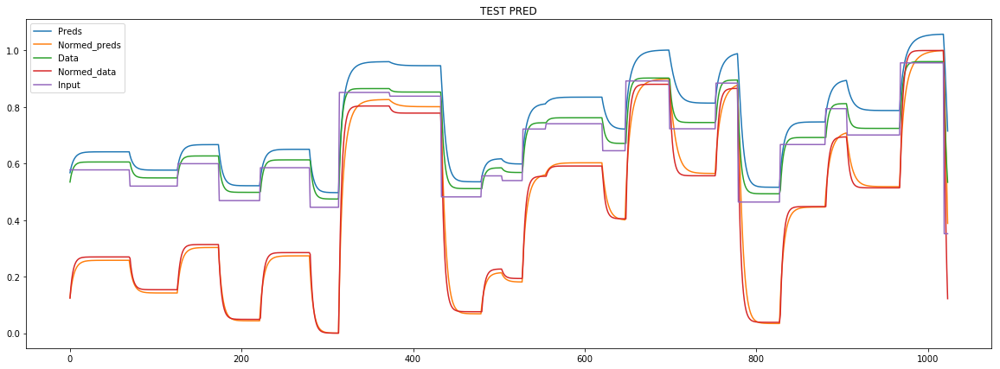

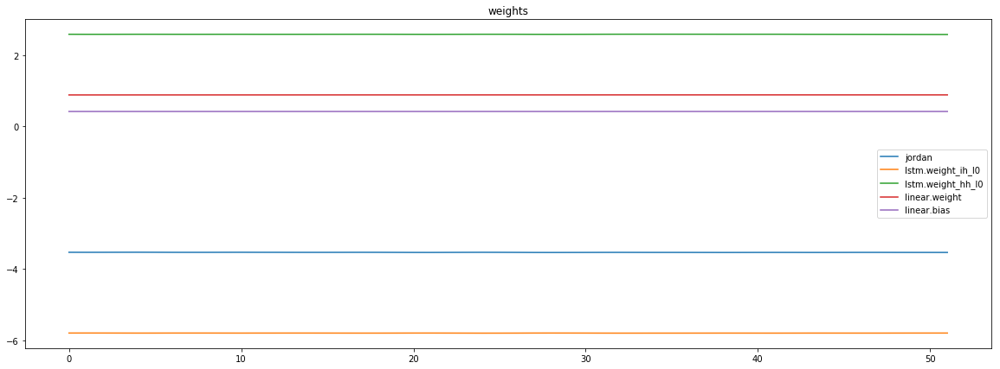

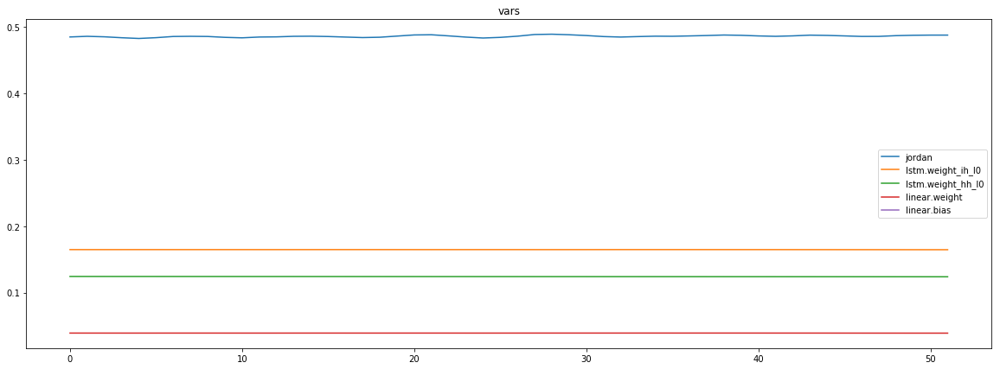

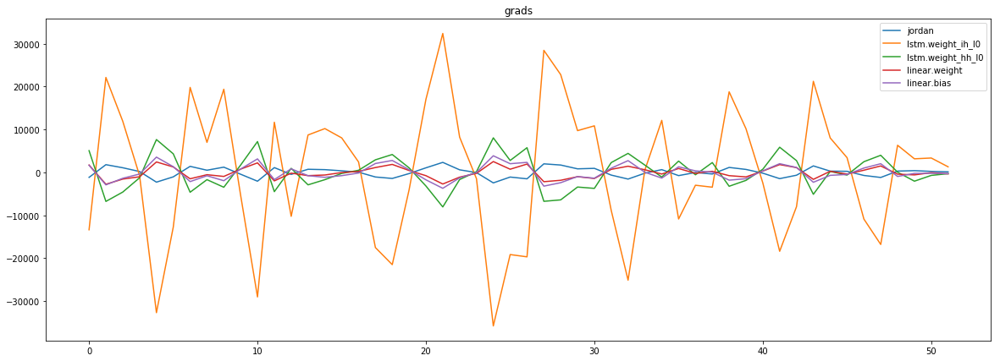

mean_p1 : 0.6991968154907227
mean_p2 : 9.62147146004897
mean_p3 : 4.356535251323994


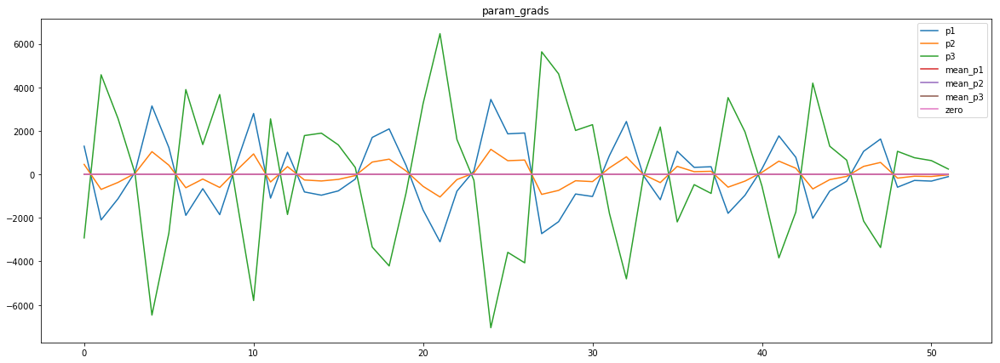

loss rate [0.0001017873561061089]
Epoch [16] 
     train_loss[8531.505662184496] 
     eval_train[8528.963688777043] 
     eval_test[8733.124977805397]



aux preds: -0.9904952645301819           -1.9553494453430176           -0.5944952964782715
main loss 0.0
aux loss 8531.263343224158
jord loss 0.0
combined loss 8531.263343224158 



Parameter containing:
tensor([[-0.9905, -1.9553, -0.5945]], requires_grad=True)


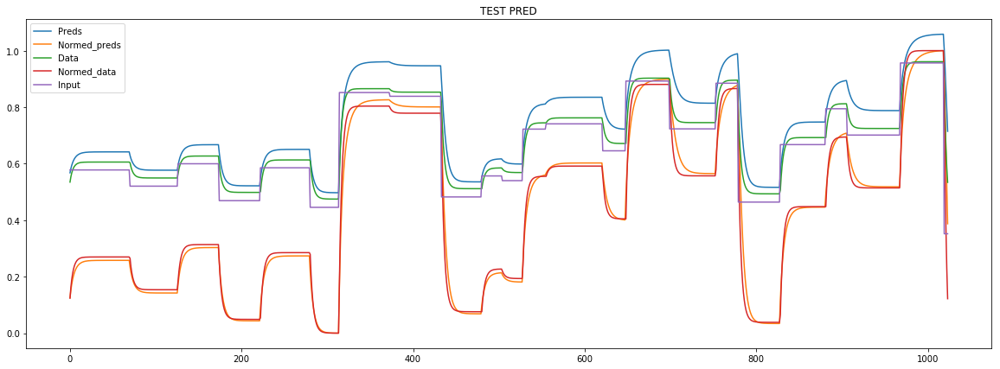

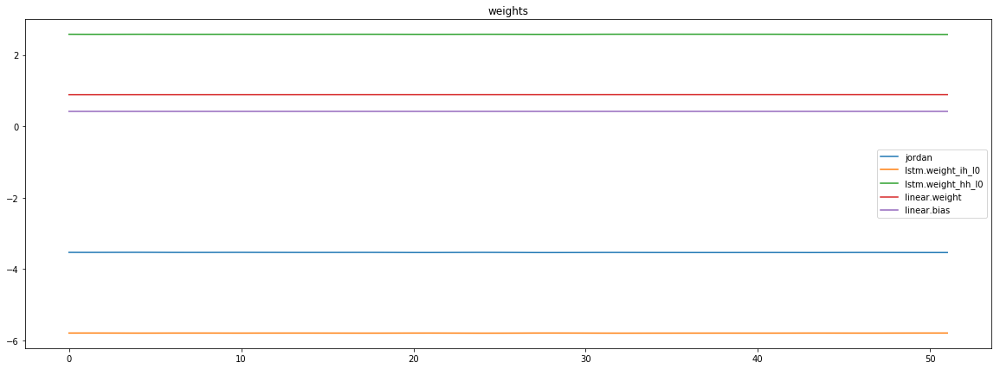

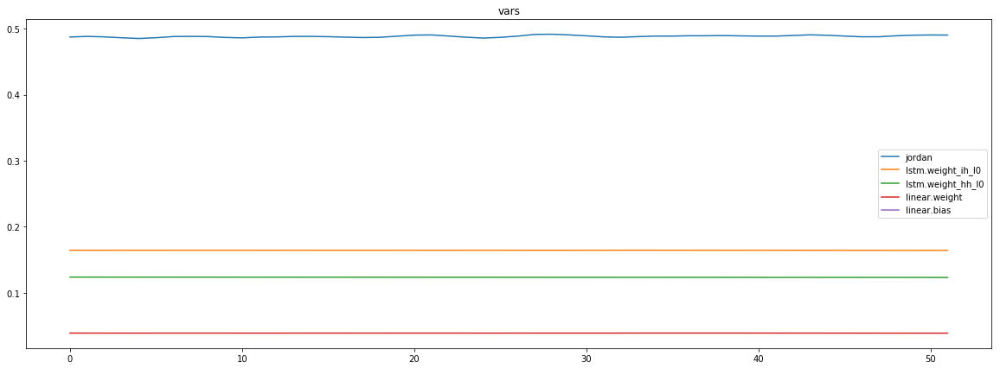

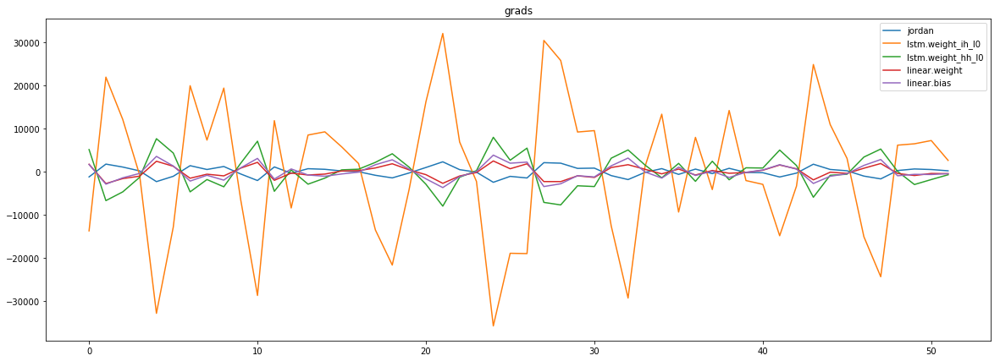

mean_p1 : -3.126061806311974
mean_p2 : 7.801431655883789
mean_p3 : 15.203326298640324


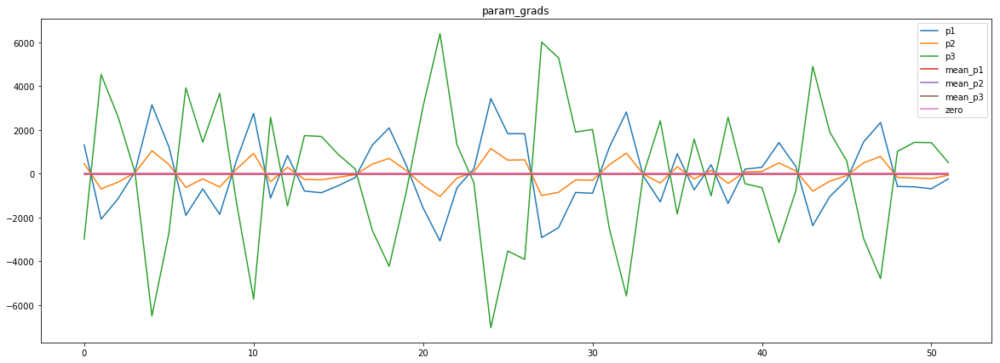

loss rate [8.723006244215625e-05]
Epoch [17] 
     train_loss[8531.263343224158] 
     eval_train[8528.637958233174] 
     eval_test[8732.806640625]



aux preds: -0.9904410243034363           -1.9588737487792969           -0.5948531627655029
main loss 0.0
aux loss 8530.924907977764
jord loss 0.0
combined loss 8530.924907977764 



Parameter containing:
tensor([[-0.9904, -1.9589, -0.5949]], requires_grad=True)


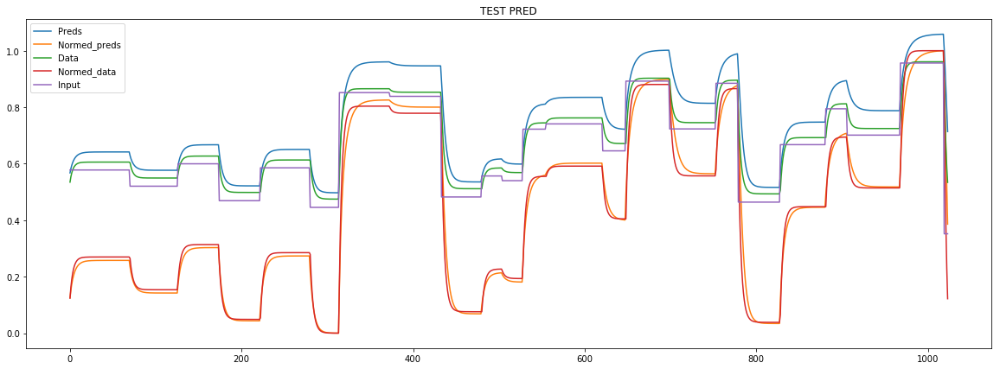

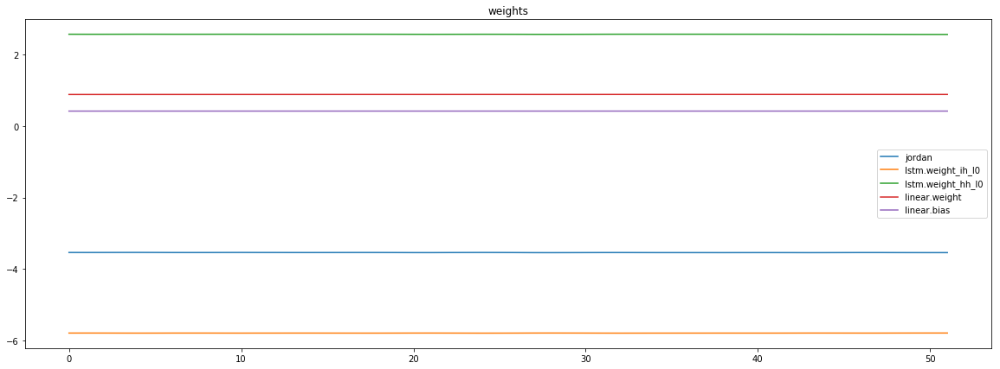

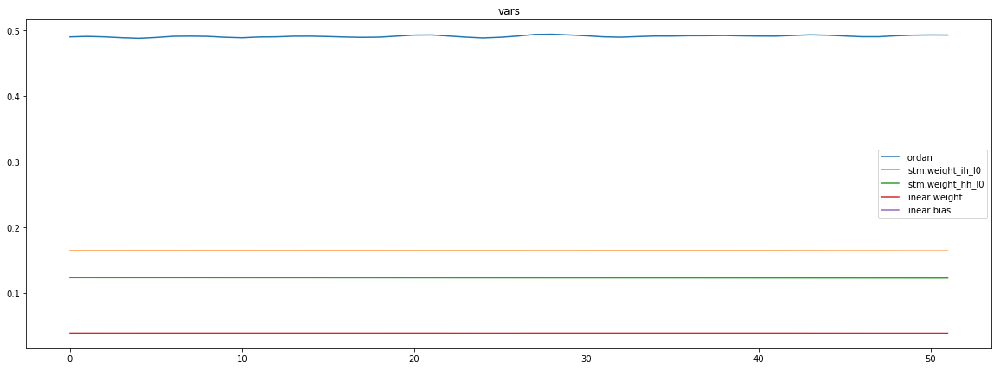

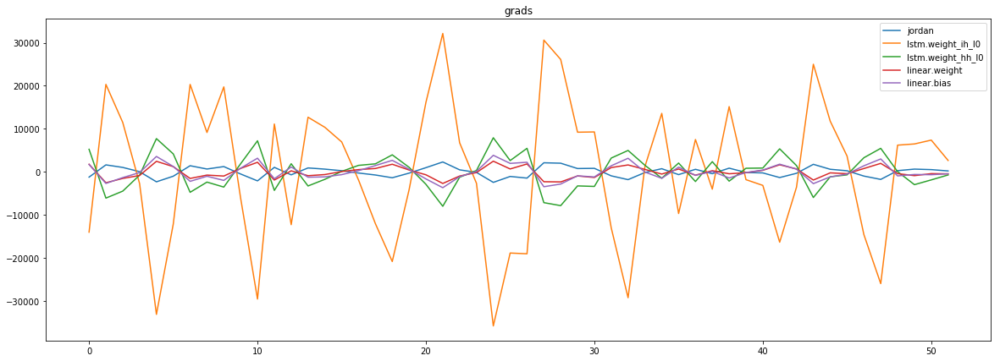

mean_p1 : 1.8323663564828725
mean_p2 : 9.357527989607592
mean_p3 : 3.0625264094426083


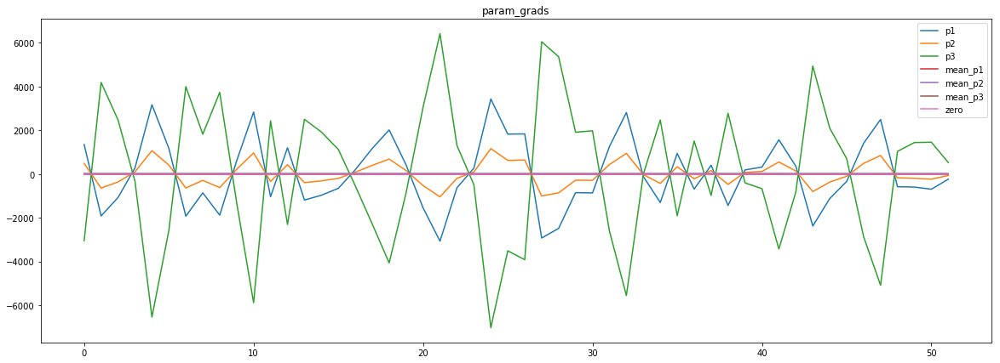

Epoch    18: reducing learning rate of group 0 to 1.6000e-03.
Epoch    18: reducing learning rate of group 1 to 1.6000e-04.
Epoch    18: reducing learning rate of group 2 to 1.6000e-04.
loss rate [7.128585274429611e-05]
Epoch [18] 
     train_loss[8530.924907977764] 
     eval_train[8528.377788837139] 
     eval_test[8732.543590198864]



aux preds: -0.9908986687660217           -1.9614298343658447           -0.594519853591919
main loss 0.0
aux loss 8529.00662935697
jord loss 0.0
combined loss 8529.00662935697 



Parameter containing:
tensor([[-0.9909, -1.9614, -0.5945]], requires_grad=True)


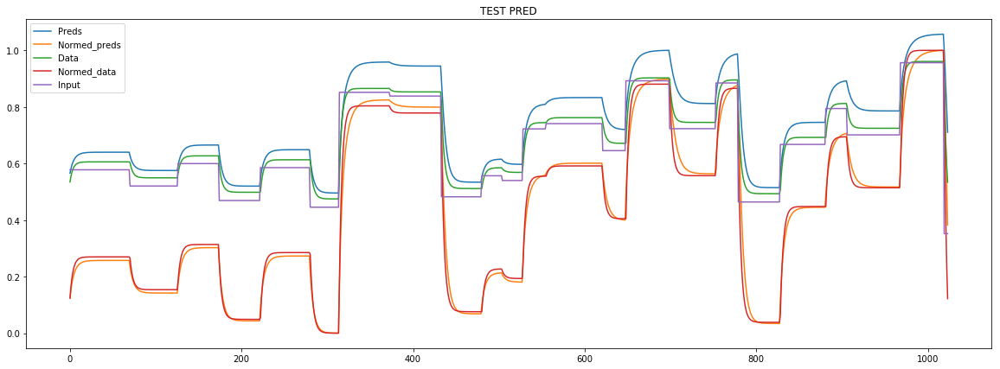

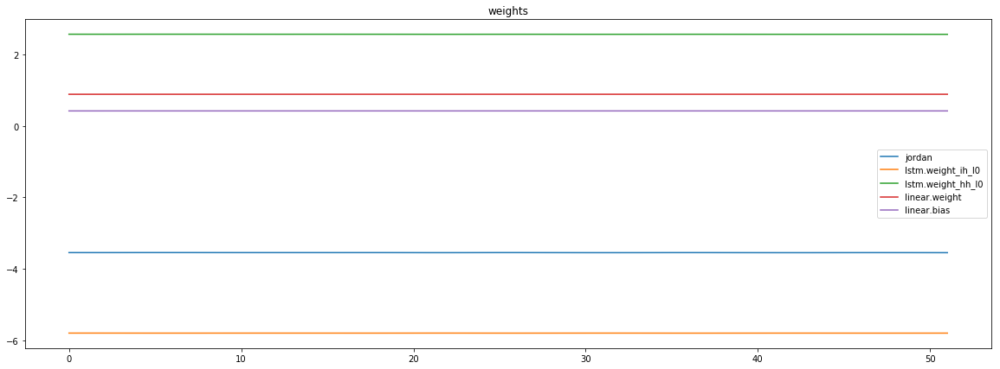

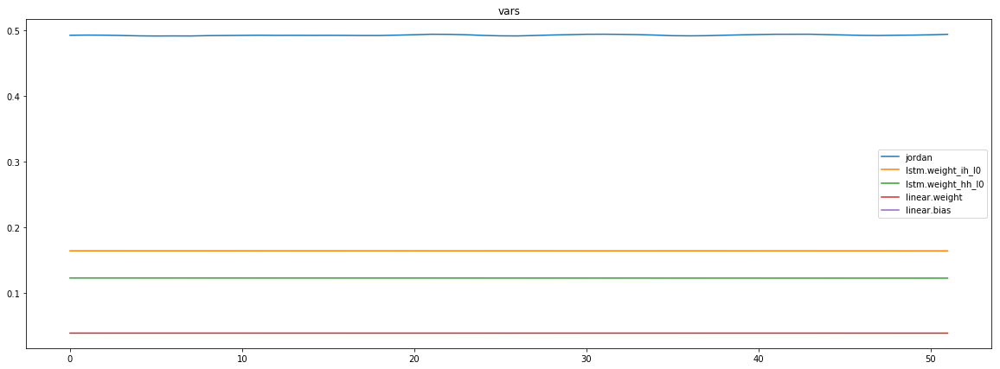

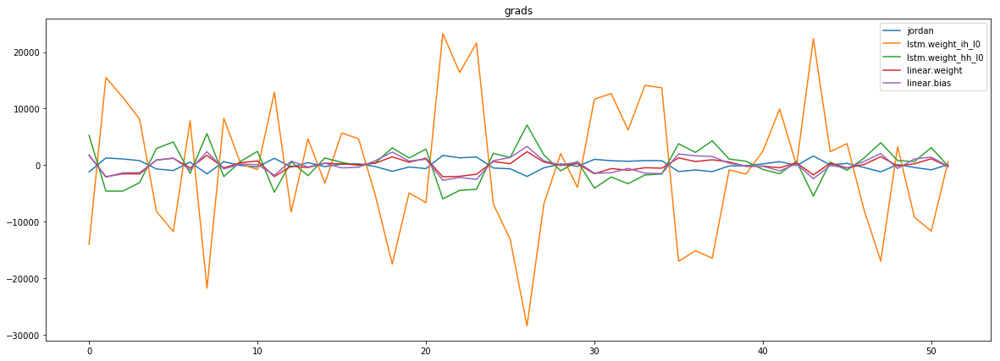

mean_p1 : 39.63086047539344
mean_p2 : 24.361238649258247
mean_p3 : -76.66633649972769


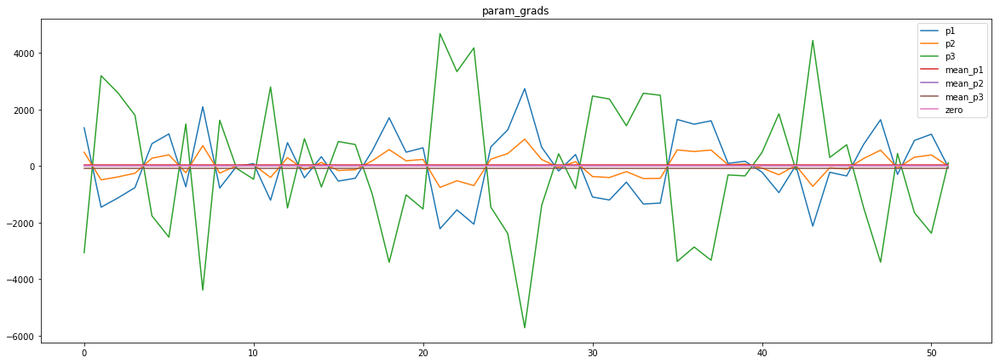

loss rate [-0.00012931649788550104]
Epoch [19] 
     train_loss[8529.00662935697] 
     eval_train[8529.80478140024] 
     eval_test[8733.954367897728]



aux preds: -0.9909091591835022           -1.9635359048843384           -0.5947237014770508
main loss 0.0
aux loss 8529.225426307092
jord loss 0.0
combined loss 8529.225426307092 



Parameter containing:
tensor([[-0.9909, -1.9635, -0.5947]], requires_grad=True)


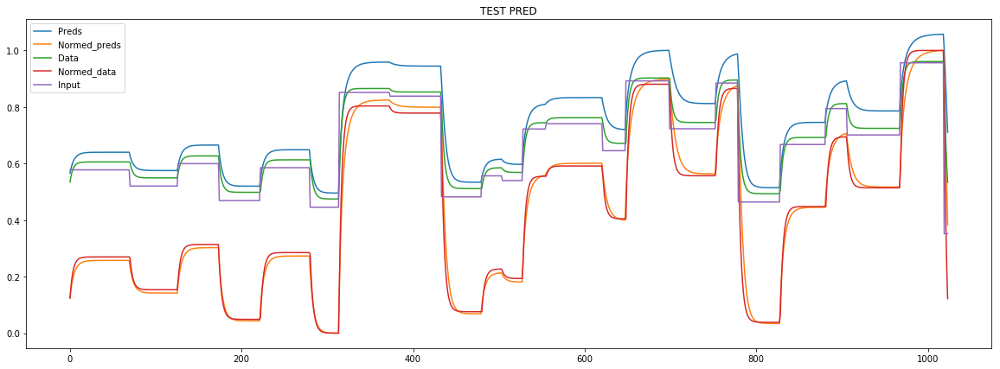

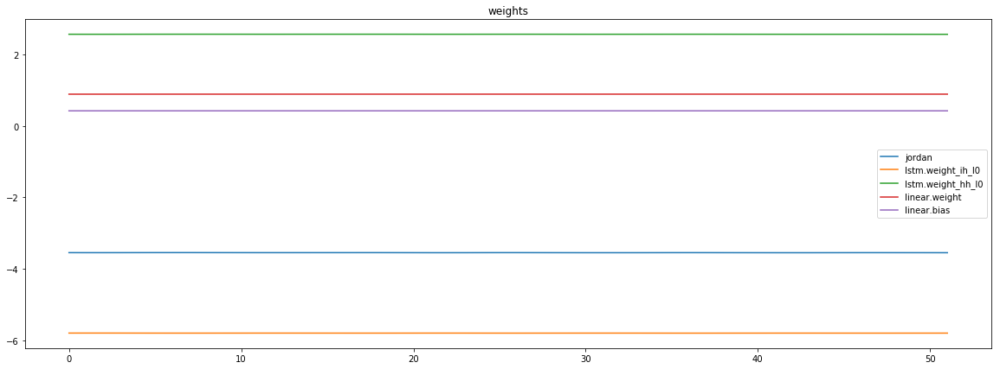

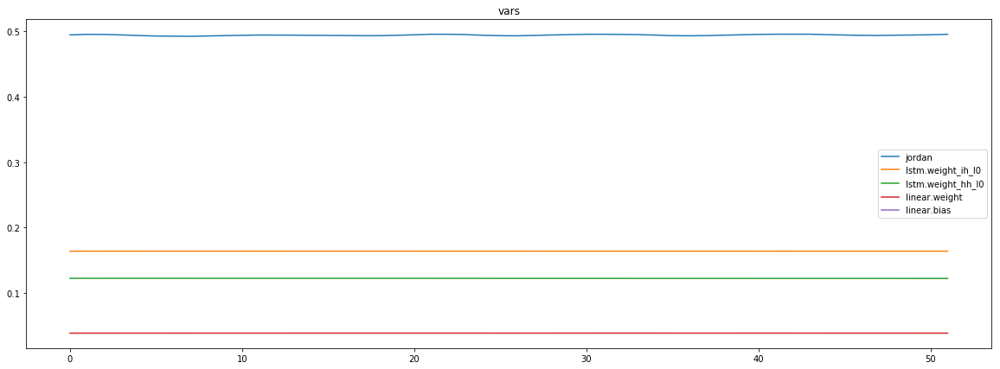

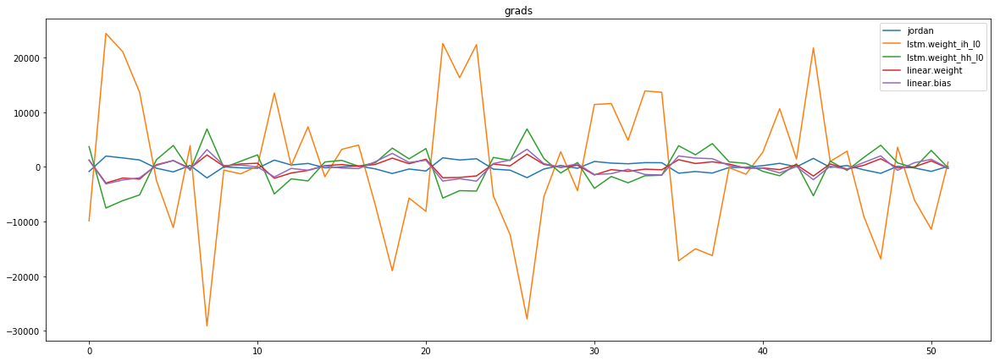

mean_p1 : -3.771189176119291
mean_p2 : 9.084058743256788
mean_p3 : 16.033026768611027


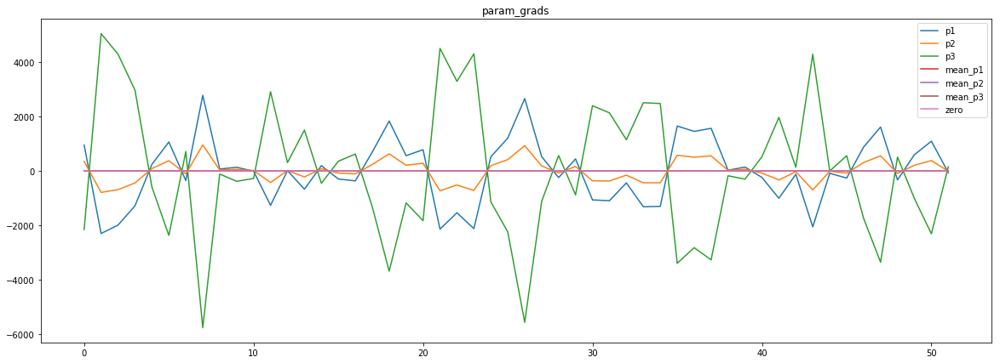

loss rate [-6.845691679679966e-05]
Epoch [20] 
     train_loss[8529.225426307092] 
     eval_train[8529.521268404447] 
     eval_test[8733.699374112215]



aux preds: -0.9908817410469055           -1.965575933456421           -0.5948812365531921
main loss 0.0
aux loss 8529.122990534855
jord loss 0.0
combined loss 8529.122990534855 



Parameter containing:
tensor([[-0.9909, -1.9656, -0.5949]], requires_grad=True)


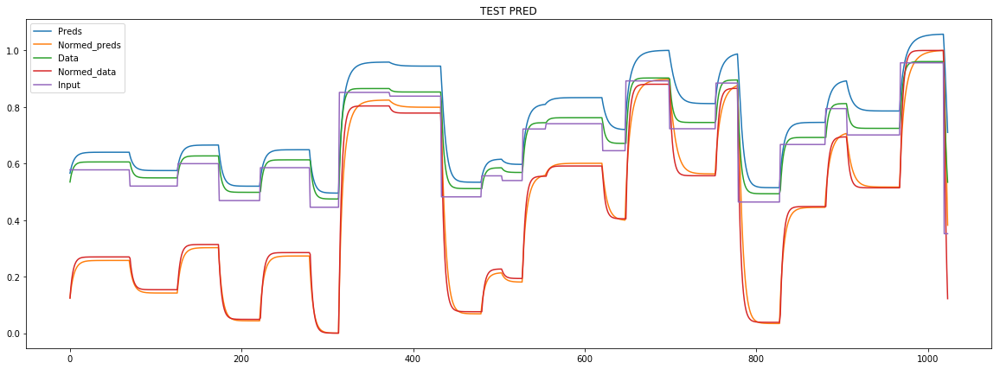

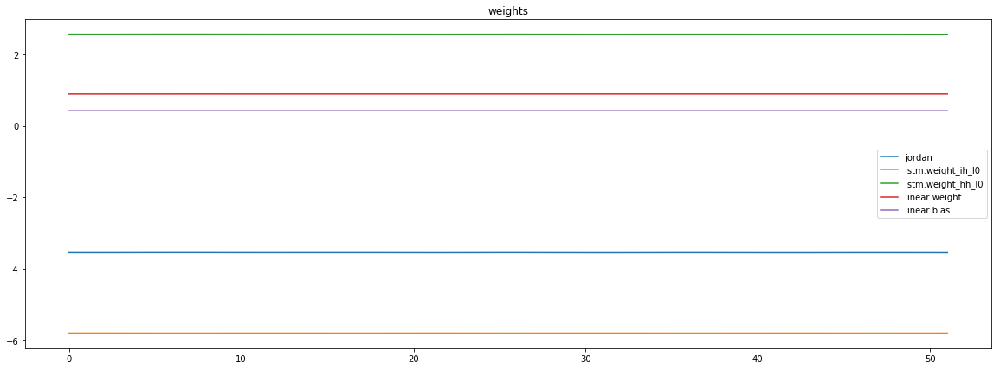

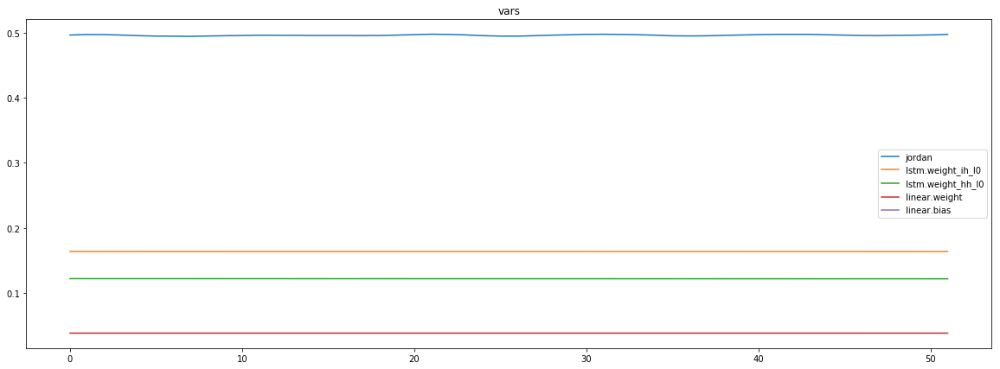

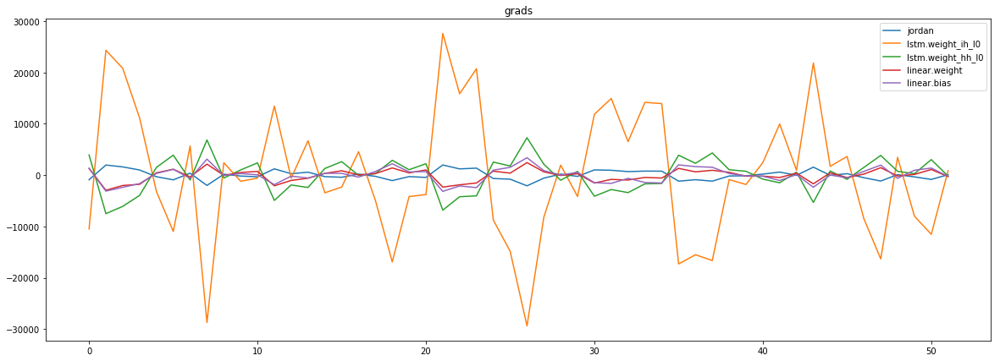

mean_p1 : -0.09428794567401592
mean_p2 : 10.244360300210806
mean_p3 : 6.223575738760141


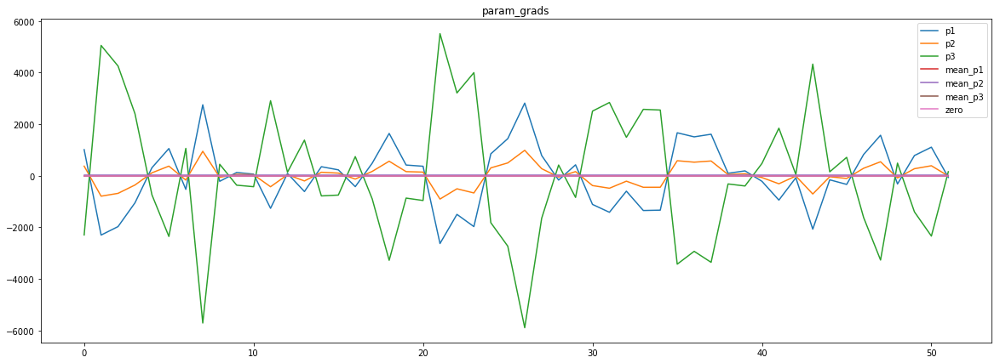

loss rate [-2.3692135921571378e-05]
Epoch [21] 
     train_loss[8529.122990534855] 
     eval_train[8529.437377929688] 
     eval_test[8733.606023615057]



aux preds: -0.9908261895179749           -1.967539668083191           -0.5950855612754822
main loss 0.0
aux loss 8528.98837515024
jord loss 0.0
combined loss 8528.98837515024 



Parameter containing:
tensor([[-0.9908, -1.9675, -0.5951]], requires_grad=True)


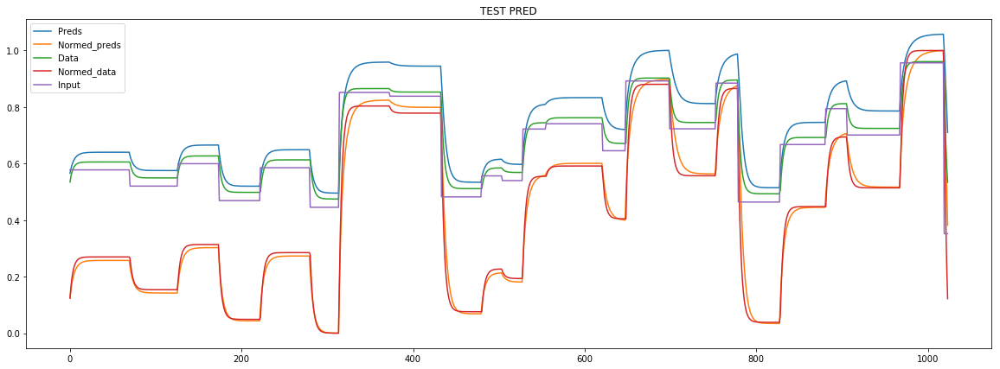

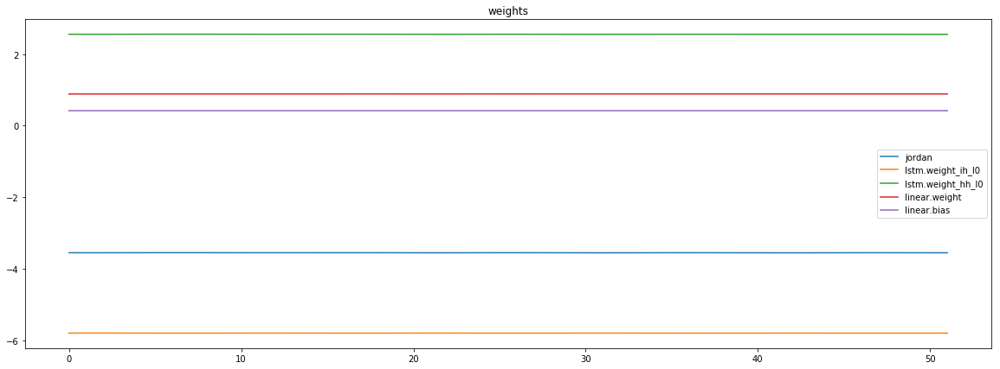

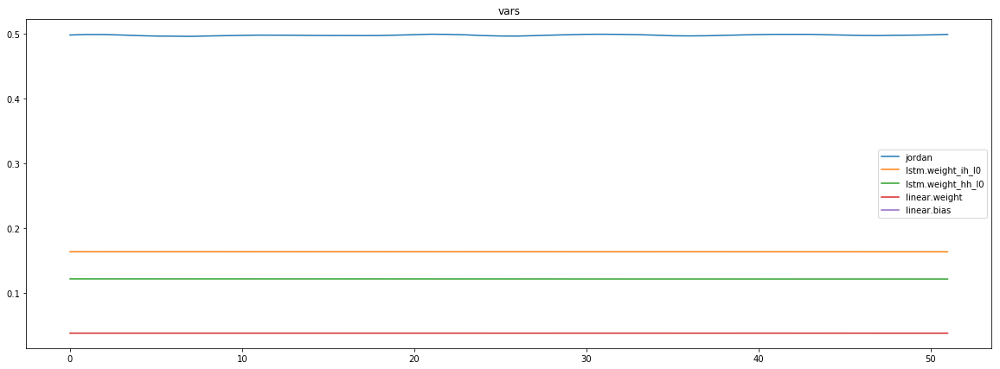

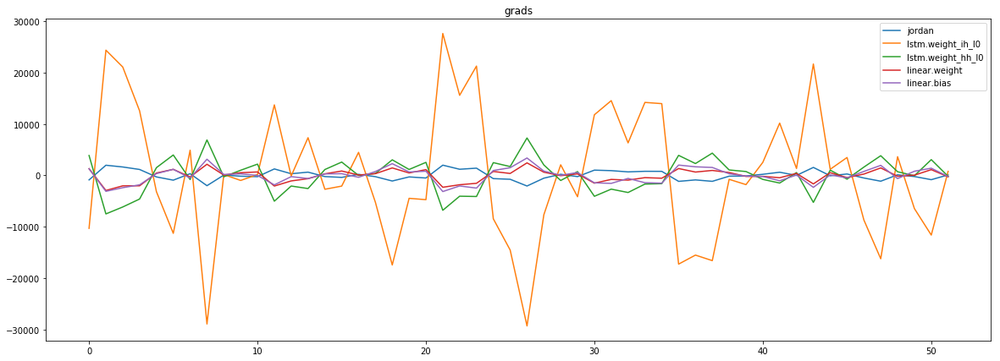

mean_p1 : -2.963378356053279
mean_p2 : 9.175912710336538
mean_p3 : 12.551163013164814


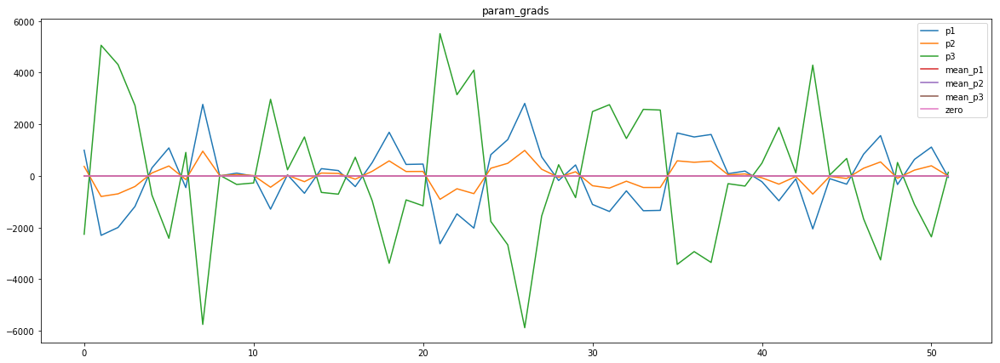

loss rate [5.18888240099713e-05]
Epoch [22] 
     train_loss[8528.98837515024] 
     eval_train[8529.119262695312] 
     eval_test[8733.300071022728]



aux preds: -0.9908078908920288           -1.9695320129394531           -0.5952262878417969
main loss 0.0
aux loss 8528.845036433293
jord loss 0.0
combined loss 8528.845036433293 



Parameter containing:
tensor([[-0.9908, -1.9695, -0.5952]], requires_grad=True)


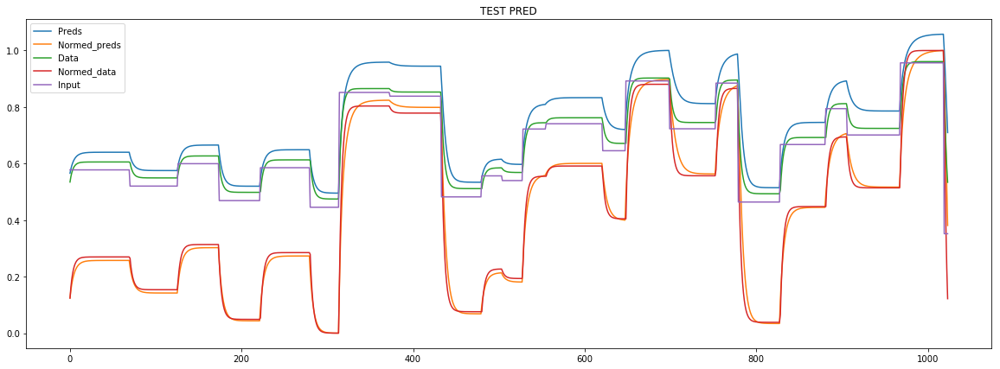

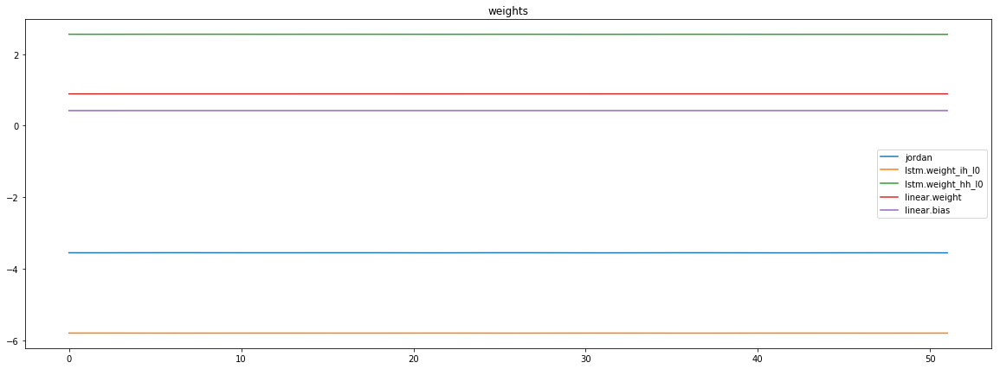

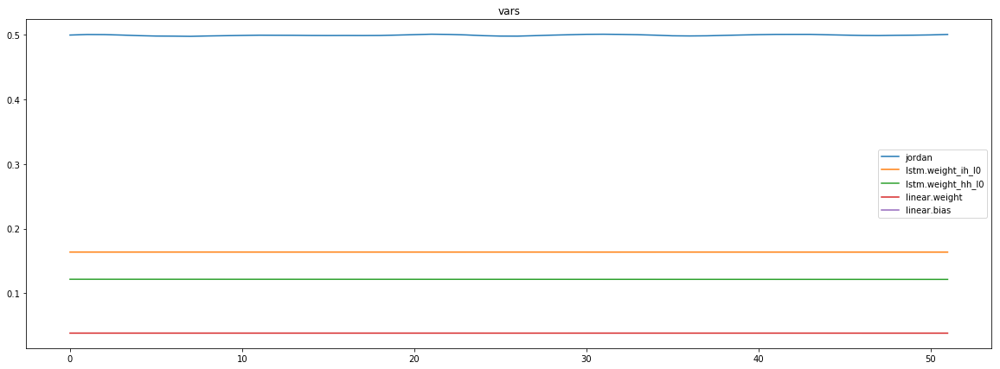

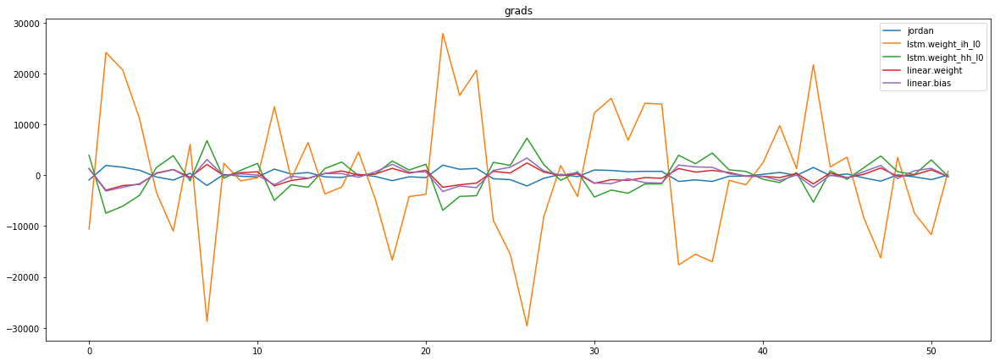

mean_p1 : -0.36249564244196963
mean_p2 : 10.025638626171993
mean_p3 : 6.543701171875


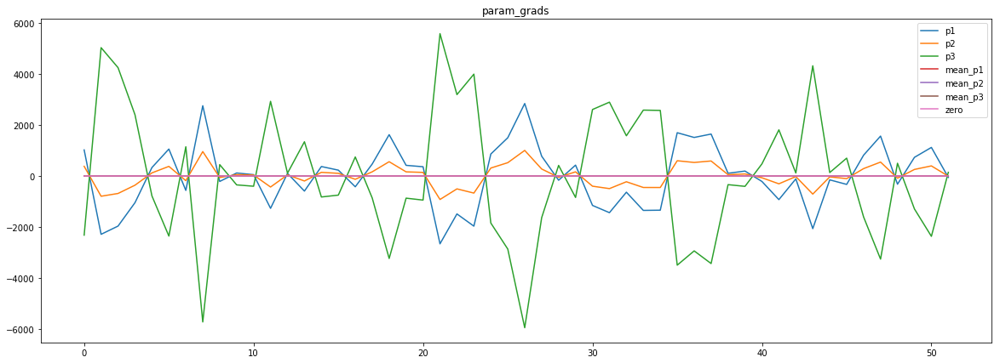

loss rate [2.997218589273487e-05]
Epoch [23] 
     train_loss[8528.845036433293] 
     eval_train[8529.103759765625] 
     eval_test[8733.273393110796]



aux preds: -0.9907827973365784           -1.9714806079864502           -0.5953952074050903
main loss 0.0
aux loss 8528.719407301684
jord loss 0.0
combined loss 8528.719407301684 



Parameter containing:
tensor([[-0.9908, -1.9715, -0.5954]], requires_grad=True)


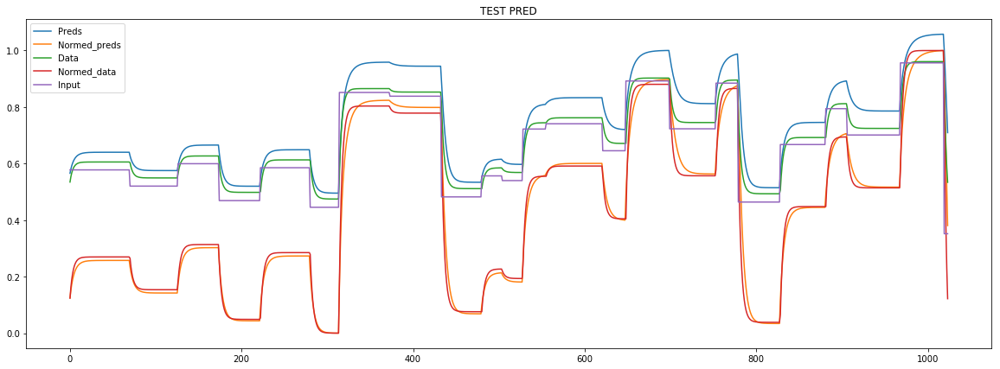

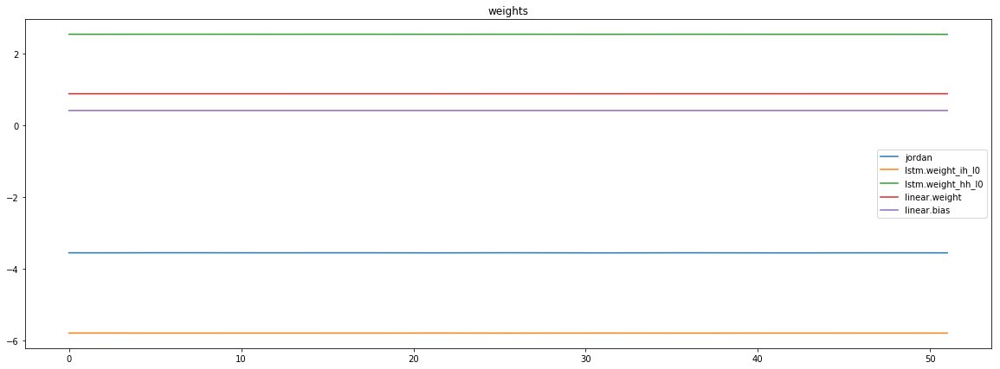

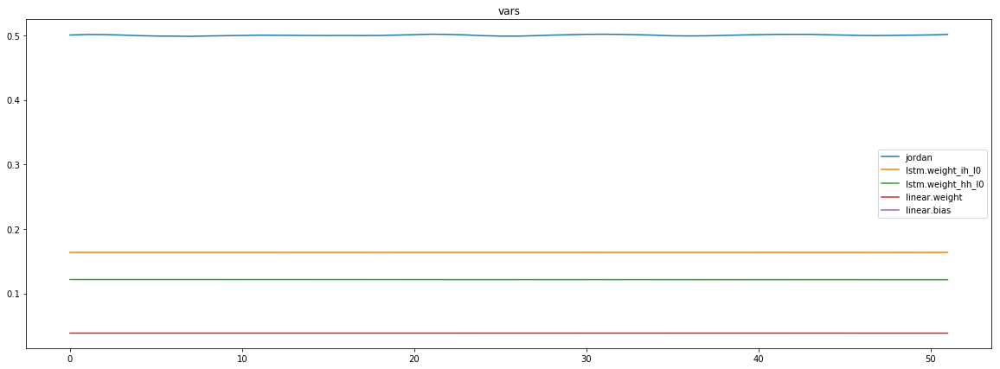

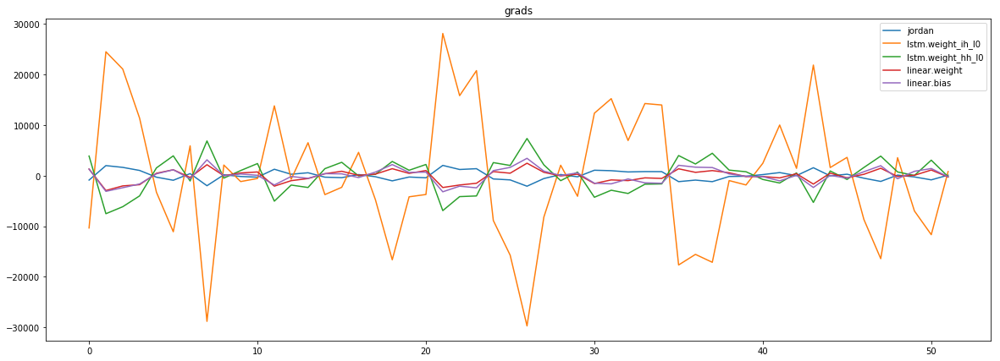

mean_p1 : -1.5661114912766676
mean_p2 : 9.503765005331774
mean_p3 : 9.640299576979418


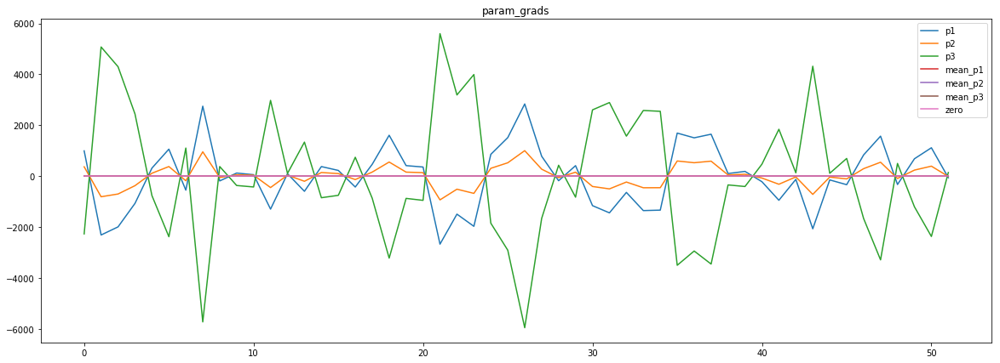

loss rate [3.0979894626304016e-05]
Epoch [24] 
     train_loss[8528.719407301684] 
     eval_train[8528.949697641227] 
     eval_test[8733.122602982954]



aux preds: -0.9907590746879578           -1.9734138250350952           -0.5955559015274048
main loss 0.0
aux loss 8528.577073317309
jord loss 0.0
combined loss 8528.577073317309 



Parameter containing:
tensor([[-0.9908, -1.9734, -0.5956]], requires_grad=True)


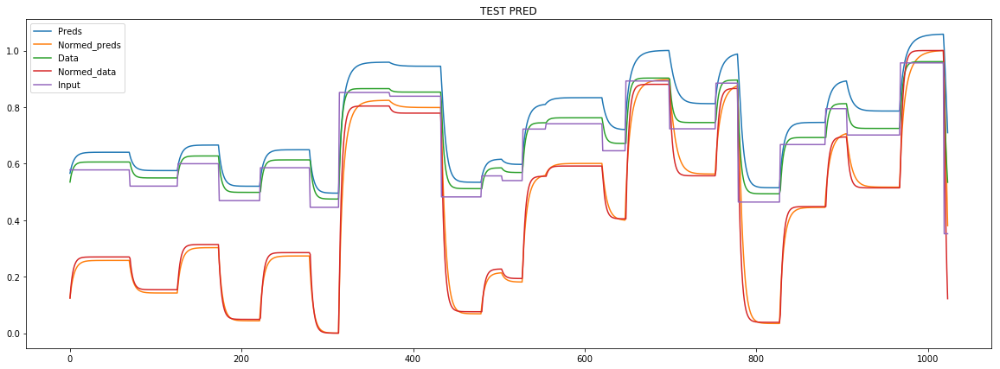

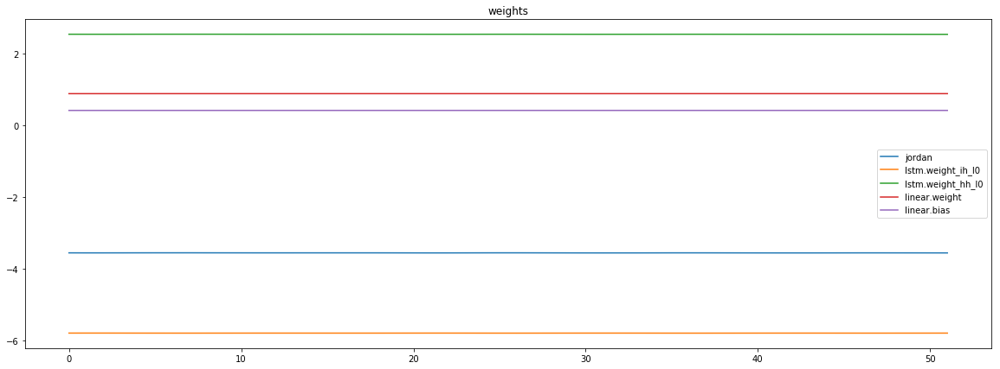

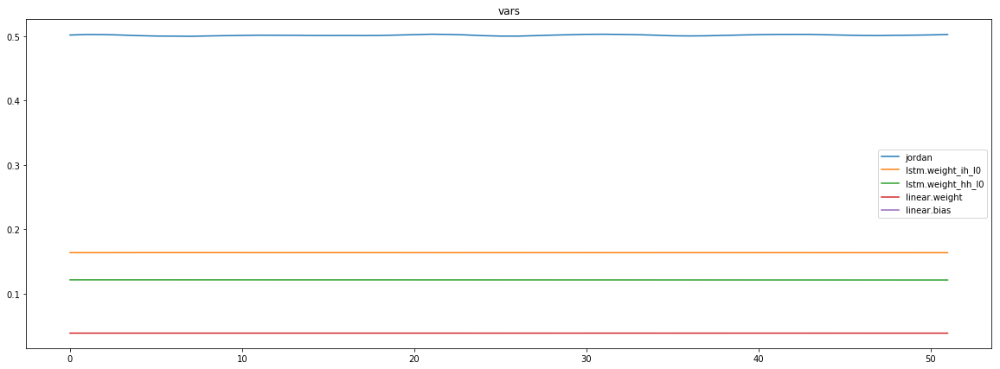

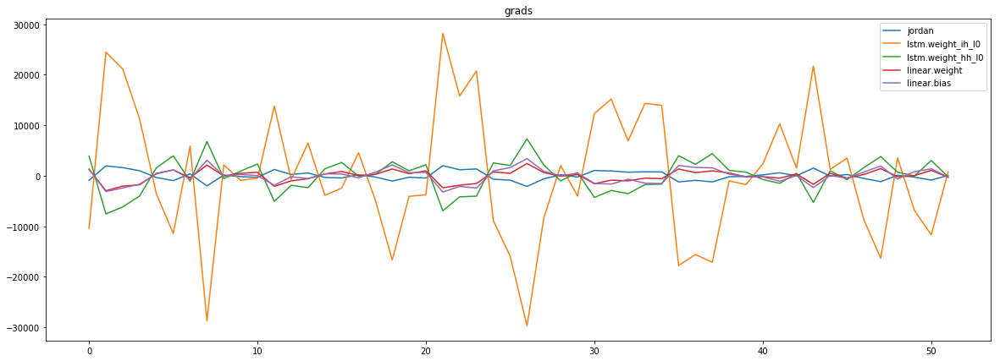

mean_p1 : -1.4022640815147986
mean_p2 : 9.529143773592436
mean_p3 : 9.113438532902645


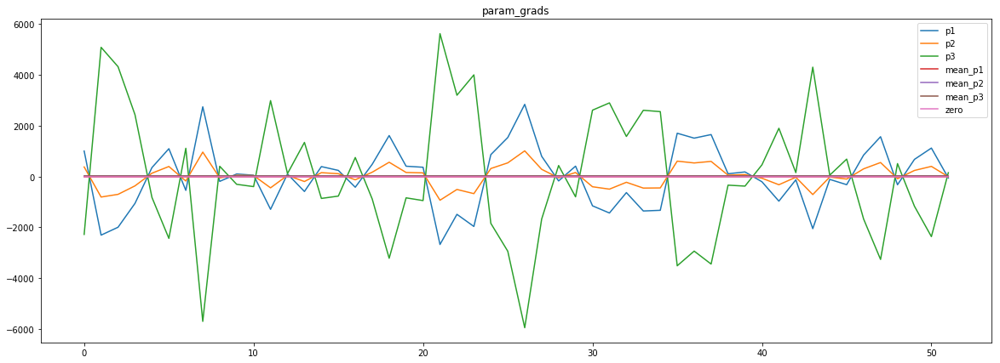

loss rate [2.7314925862165218e-05]
Epoch [25] 
     train_loss[8528.577073317309] 
     eval_train[8528.81973031851] 
     eval_test[8732.993474786932]



aux preds: -0.9907333254814148           -1.9753217697143555           -0.5957181453704834
main loss 0.0
aux loss 8528.428006685697
jord loss 0.0
combined loss 8528.428006685697 



Parameter containing:
tensor([[-0.9907, -1.9753, -0.5957]], requires_grad=True)


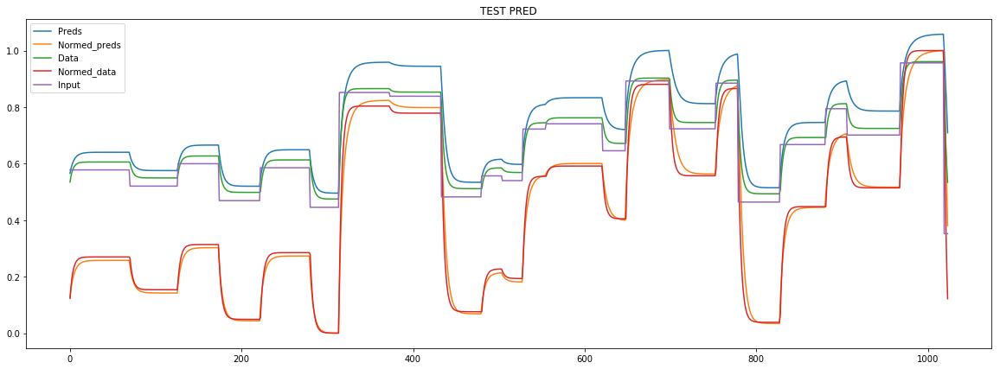

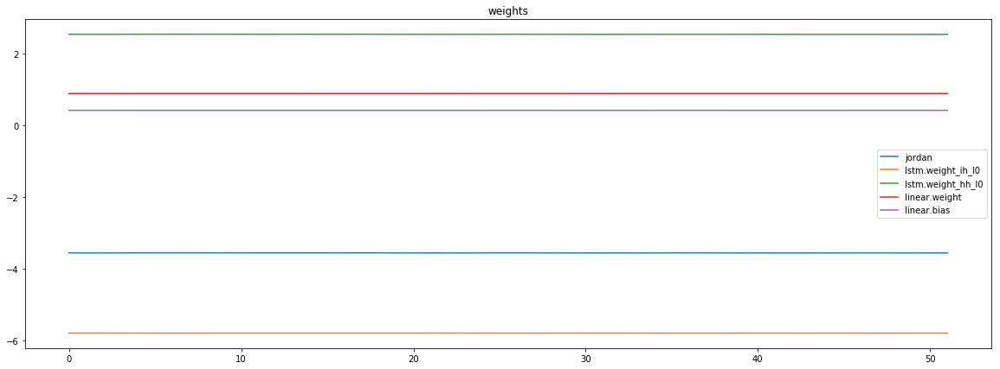

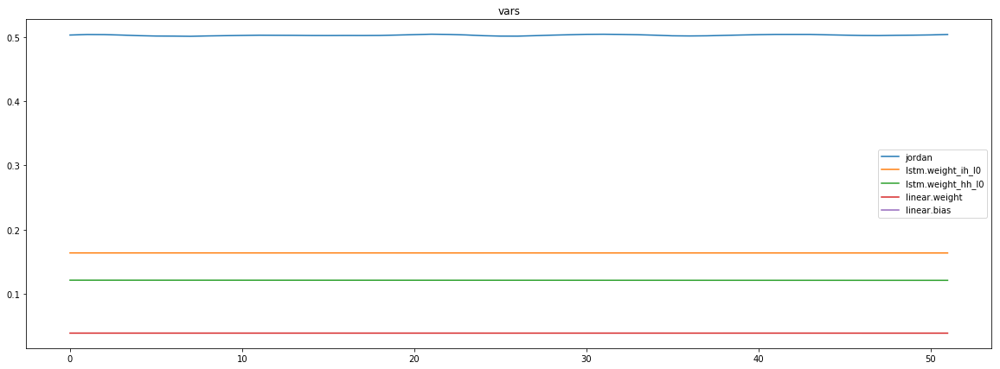

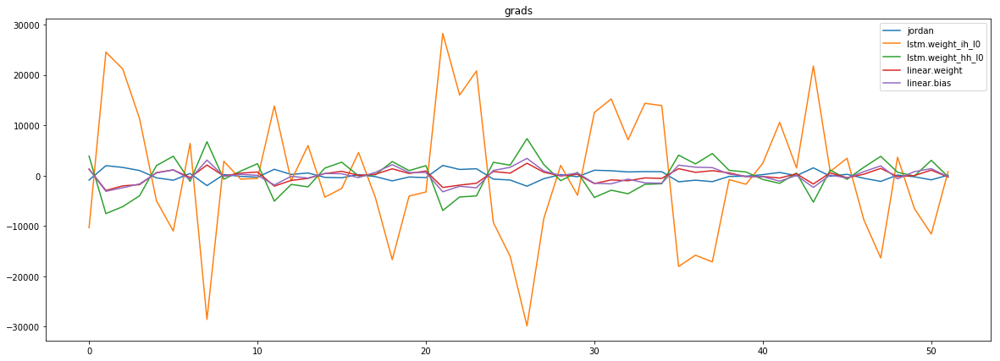

mean_p1 : -1.6889684383685772
mean_p2 : 9.352930050629835
mean_p3 : 9.676717684819149


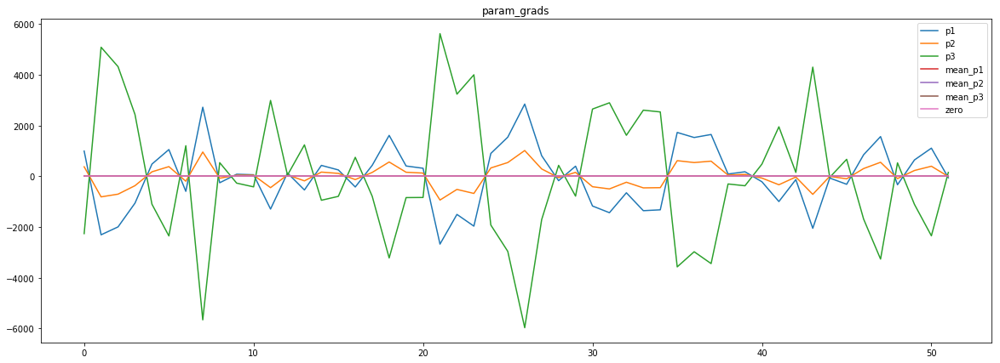

loss rate [3.1623809545688886e-05]
Epoch [26] 
     train_loss[8528.428006685697] 
     eval_train[8528.678842397836] 
     eval_test[8732.853648792614]



aux preds: -0.9906776547431946           -1.9771766662597656           -0.5958743691444397
main loss 0.0
aux loss 8528.291090745191
jord loss 0.0
combined loss 8528.291090745191 



Parameter containing:
tensor([[-0.9907, -1.9772, -0.5959]], requires_grad=True)


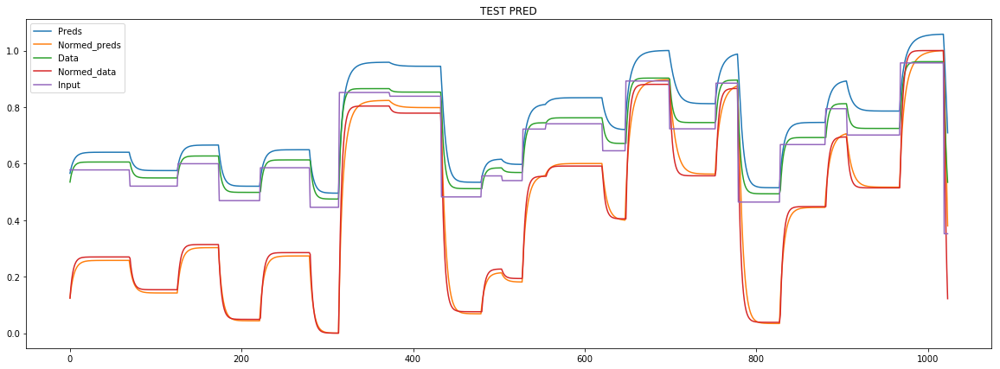

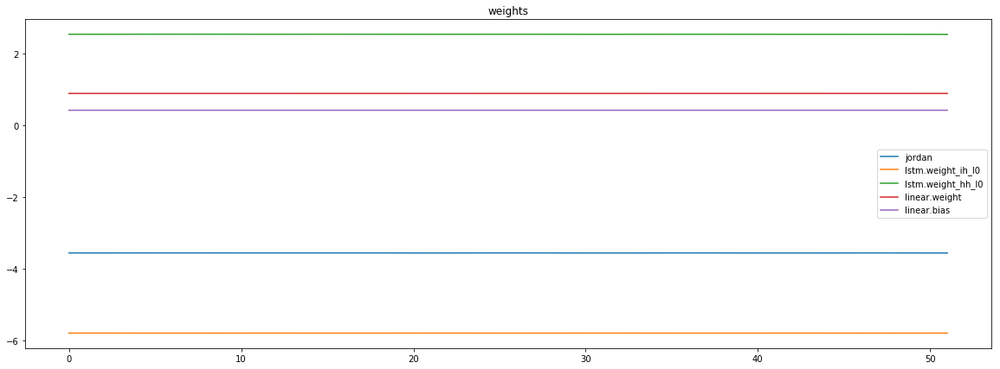

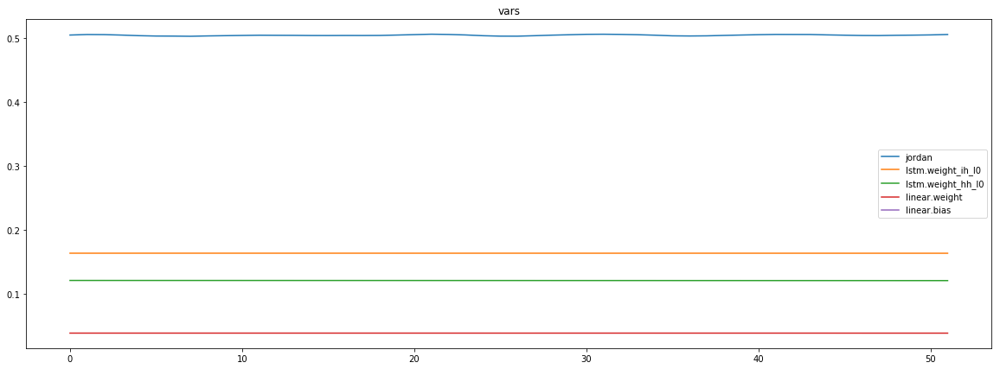

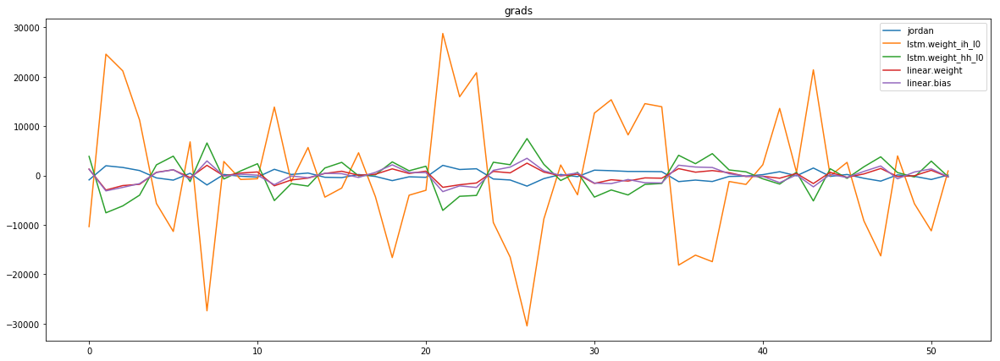

mean_p1 : -2.9337551410381613
mean_p2 : 8.866822352776161
mean_p3 : 11.049976422236515


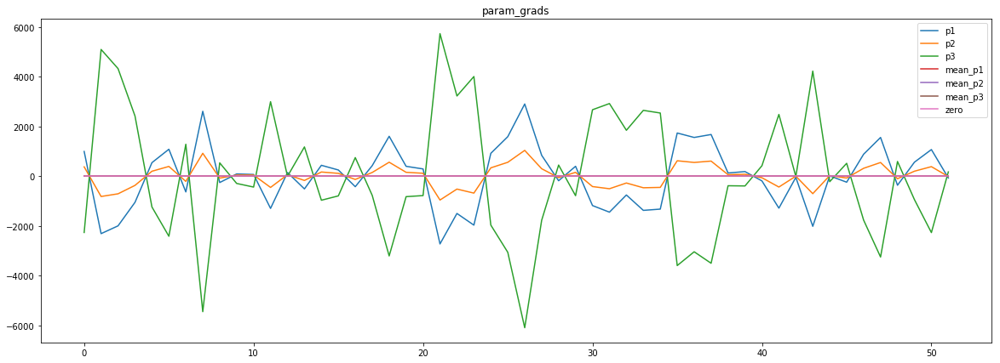

Epoch    27: reducing learning rate of group 0 to 6.4000e-04.
Epoch    27: reducing learning rate of group 1 to 6.4000e-05.
Epoch    27: reducing learning rate of group 2 to 6.4000e-05.
loss rate [3.36574894927999e-05]
Epoch [27] 
     train_loss[8528.291090745191] 
     eval_train[8528.52890249399] 
     eval_test[8732.695978338068]



aux preds: -0.9894953370094299           -1.9769492149353027           -0.5969774127006531
main loss 0.0
aux loss 8527.144888070914
jord loss 0.0
combined loss 8527.144888070914 



Parameter containing:
tensor([[-0.9895, -1.9769, -0.5970]], requires_grad=True)


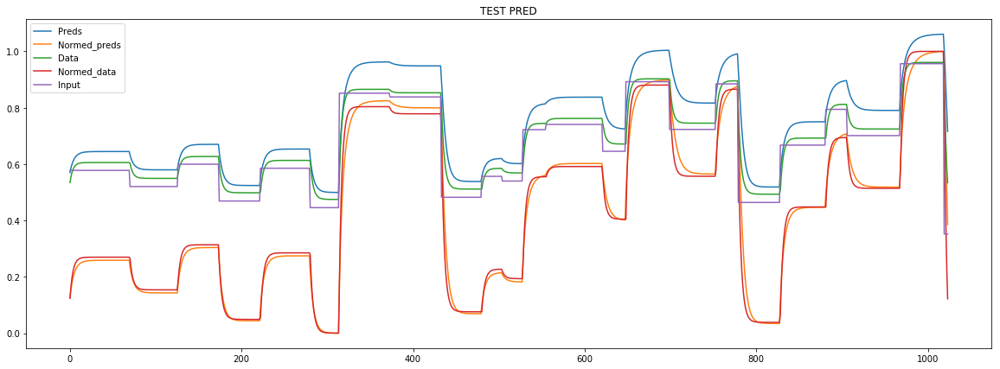

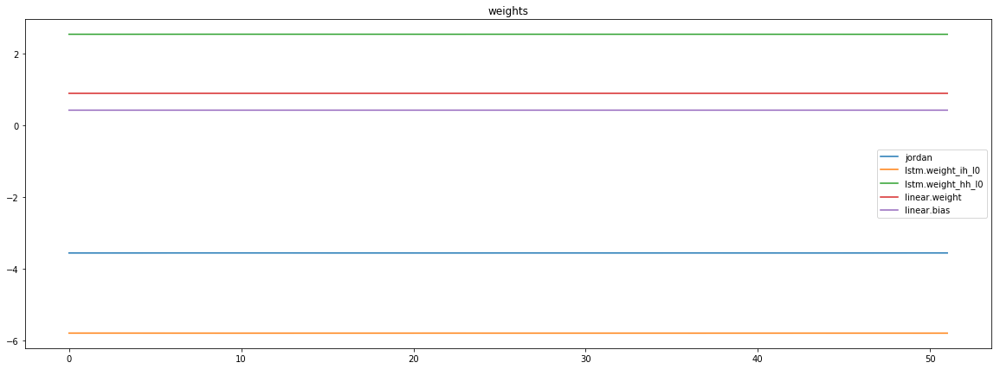

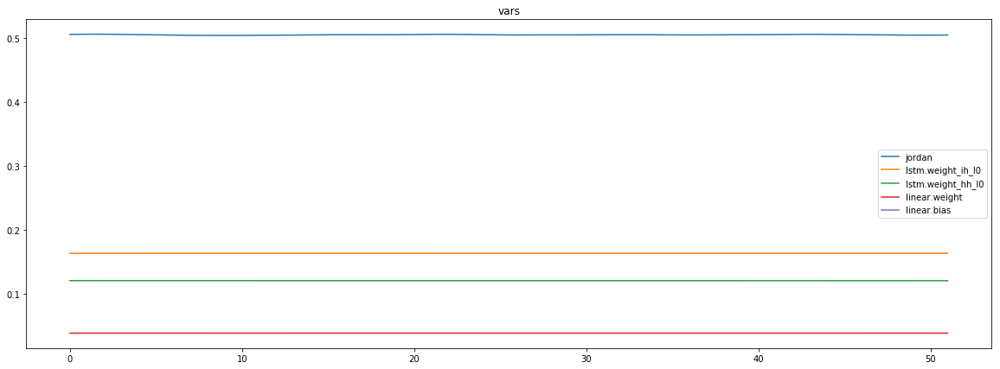

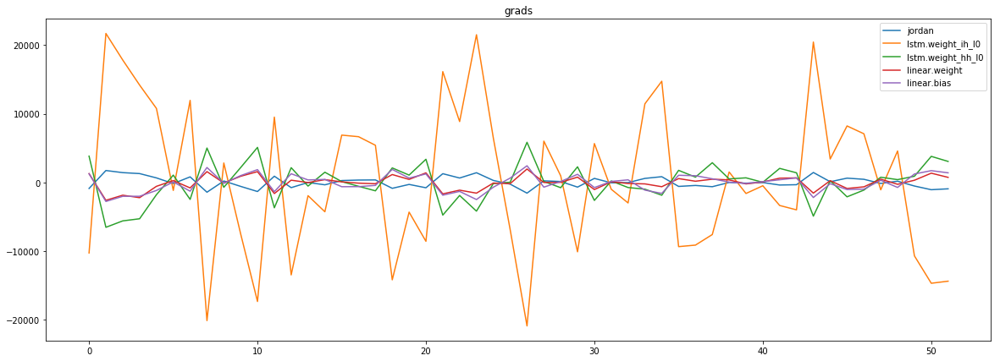

mean_p1 : -27.466732318584736
mean_p2 : 1.1766537519601674
mean_p3 : 54.73921144925631


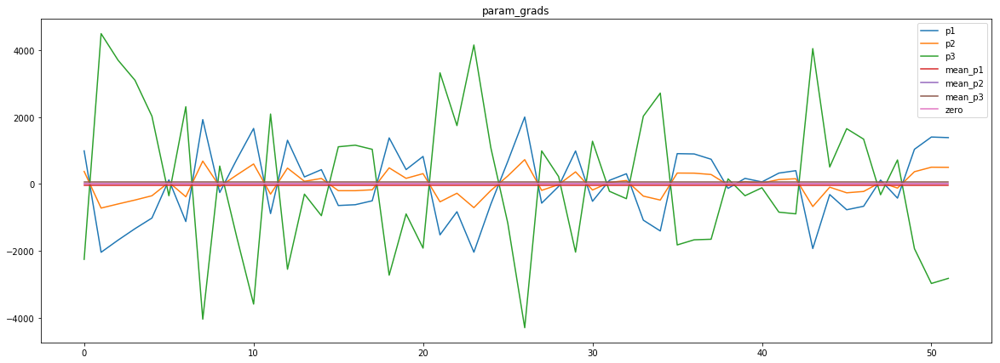

loss rate [0.0002623979932089293]
Epoch [28] 
     train_loss[8527.144888070914] 
     eval_train[8526.685499924879] 
     eval_test[8730.556218927557]



aux preds: -0.9894058704376221           -1.977850079536438           -0.5970692038536072
main loss 0.0
aux loss 8527.057241586539
jord loss 0.0
combined loss 8527.057241586539 



Parameter containing:
tensor([[-0.9894, -1.9779, -0.5971]], requires_grad=True)


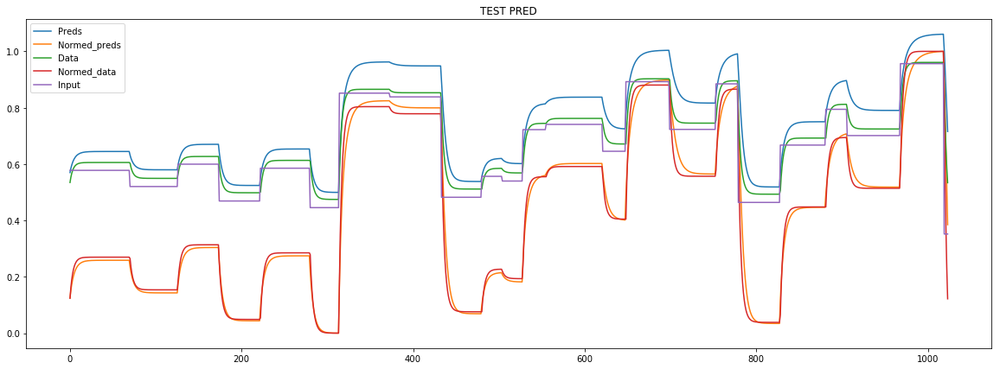

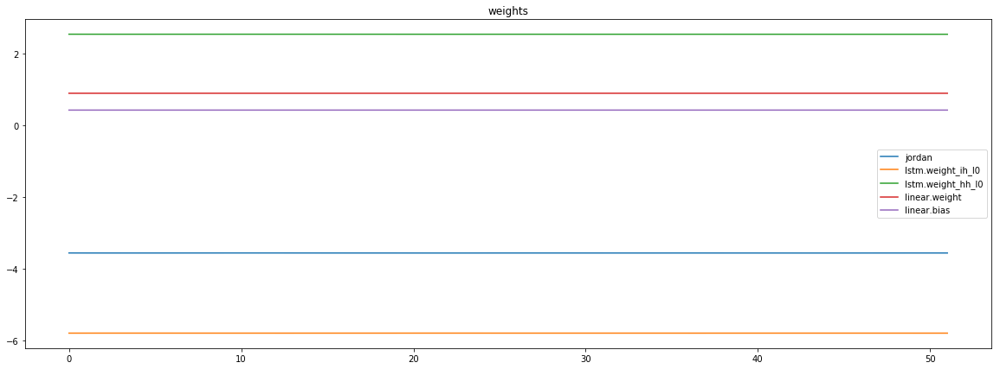

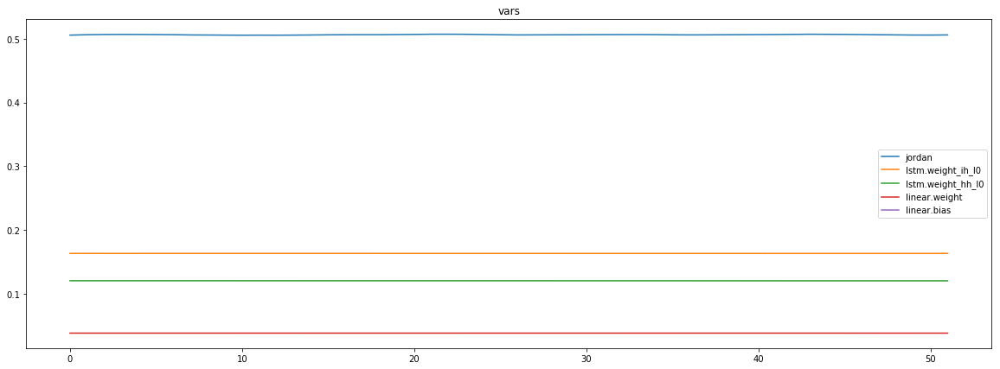

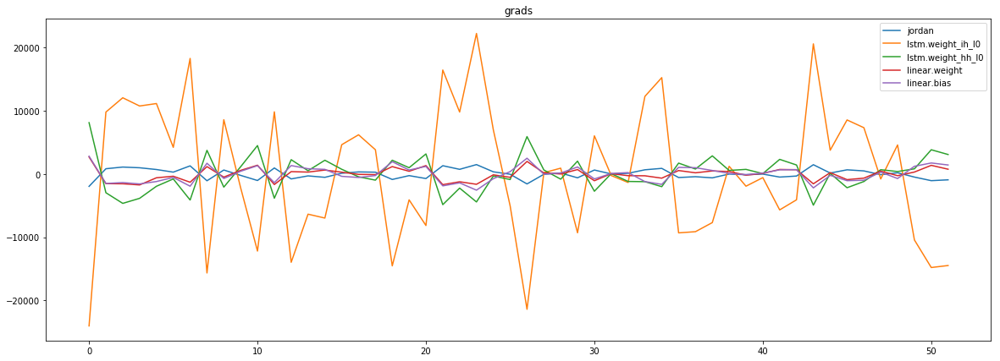

mean_p1 : -3.498606094947228
mean_p2 : 9.578105706434984
mean_p3 : 8.950506943922777


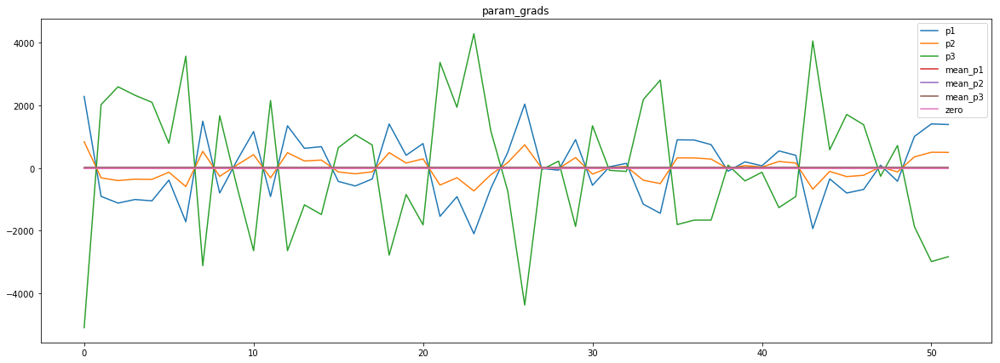

loss rate [0.00018092052317142393]
Epoch [29] 
     train_loss[8527.057241586539] 
     eval_train[8526.614398662861] 
     eval_test[8730.45547762784]



aux preds: -0.9893734455108643           -1.9787853956222534           -0.5971558094024658
main loss 0.0
aux loss 8526.989614633414
jord loss 0.0
combined loss 8526.989614633414 



Parameter containing:
tensor([[-0.9894, -1.9788, -0.5972]], requires_grad=True)


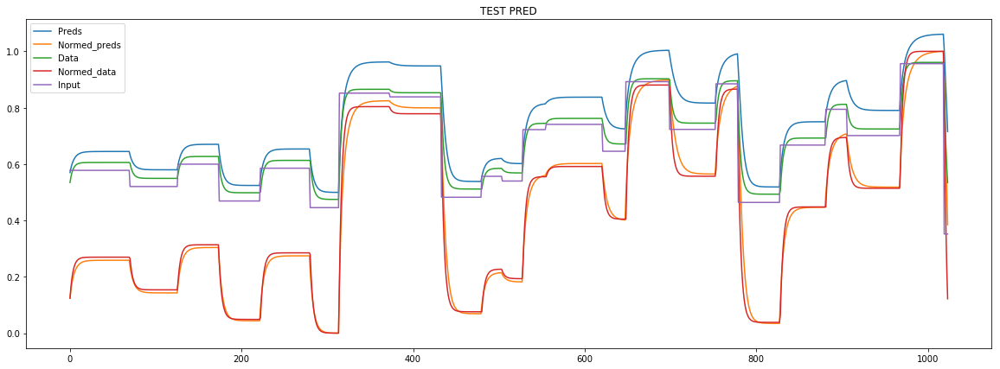

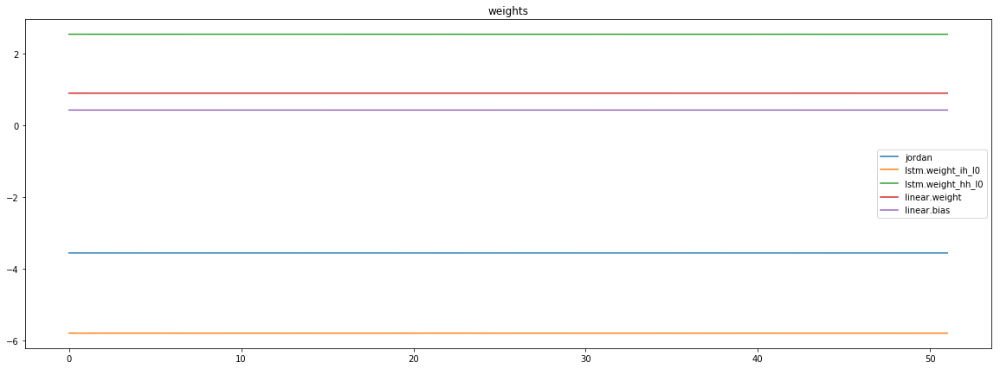

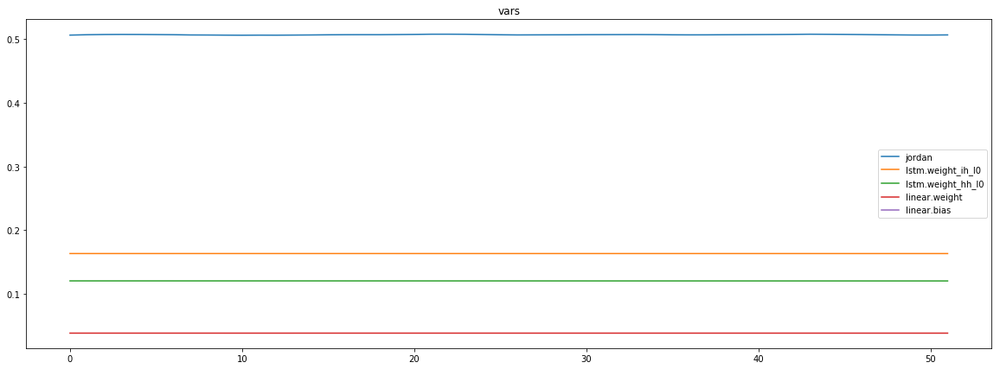

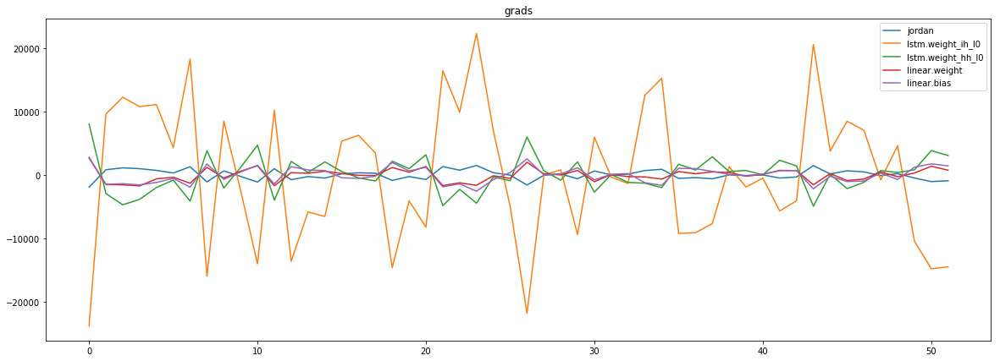

mean_p1 : -1.3908824553856483
mean_p2 : 10.122025673206036
mean_p3 : 7.719668168288011


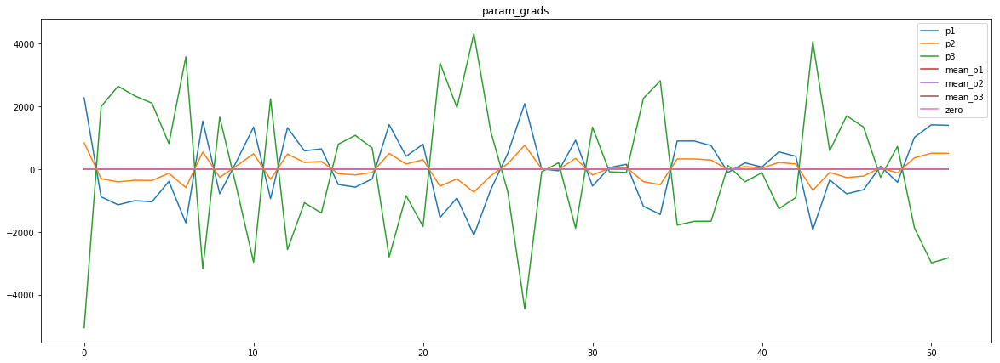

loss rate [9.888630108367824e-05]
Epoch [30] 
     train_loss[8526.989614633414] 
     eval_train[8526.537362905648] 
     eval_test[8730.372492009943]



aux preds: -0.9893631339073181           -1.9797300100326538           -0.5972474217414856
main loss 0.0
aux loss 8526.909142127404
jord loss 0.0
combined loss 8526.909142127404 



Parameter containing:
tensor([[-0.9894, -1.9797, -0.5972]], requires_grad=True)


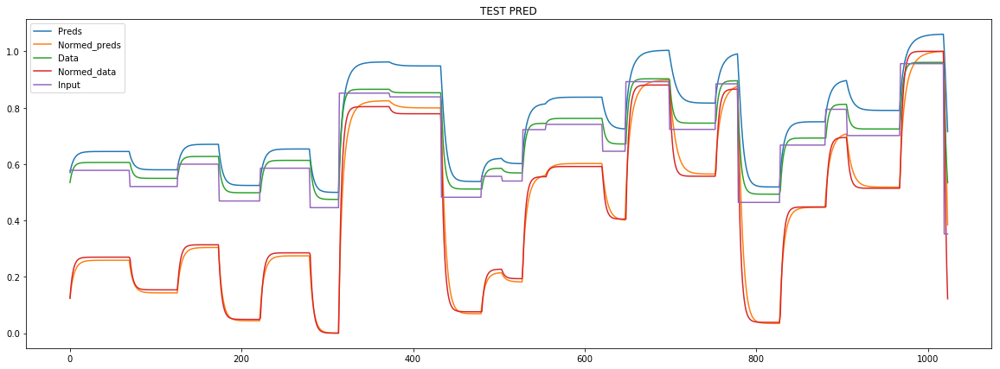

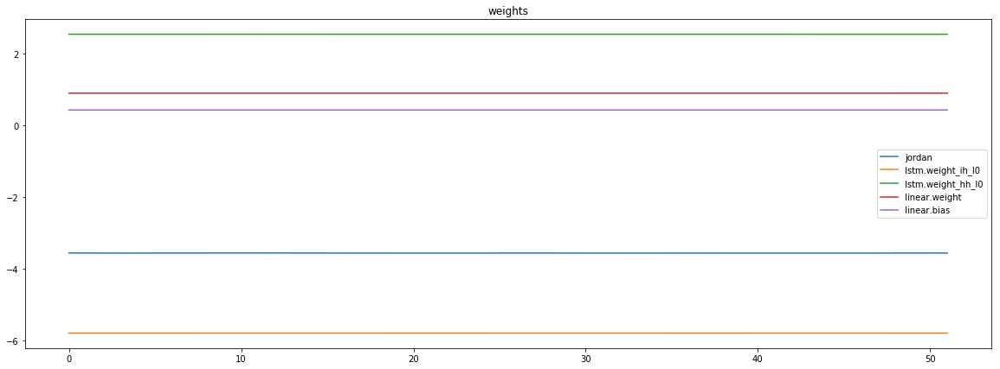

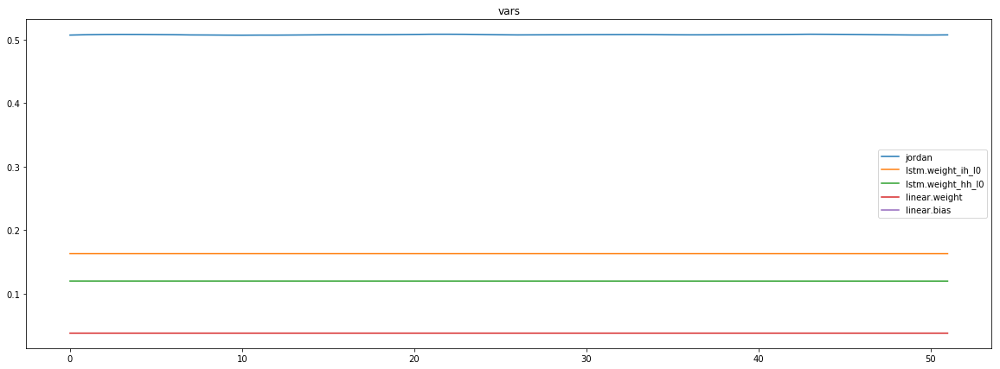

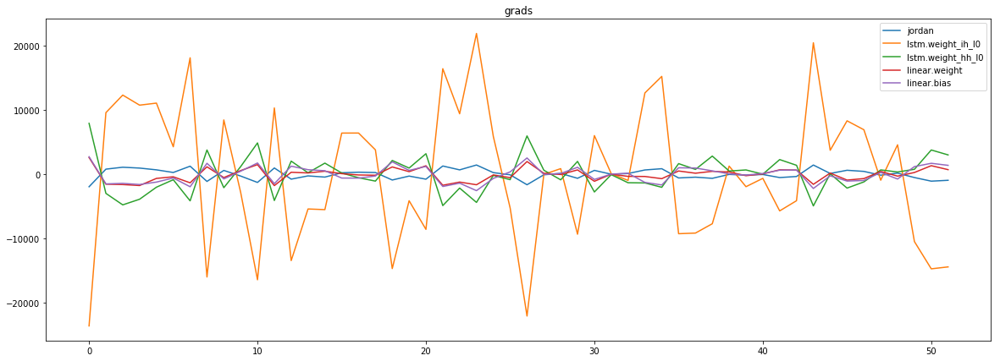

mean_p1 : -0.3819029698005089
mean_p2 : 10.386516644404484
mean_p3 : 7.3299892865694485


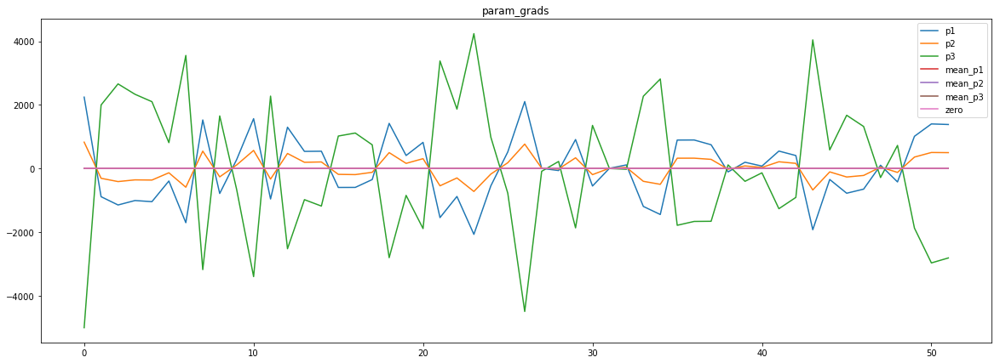

loss rate [1.854452107752369e-05]
Epoch [31] 
     train_loss[8526.909142127404] 
     eval_train[8526.459115835336] 
     eval_test[8730.299493963068]



aux preds: -0.9893488883972168           -1.9806671142578125           -0.5973414182662964
main loss 0.0
aux loss 8526.843458909254
jord loss 0.0
combined loss 8526.843458909254 



Parameter containing:
tensor([[-0.9893, -1.9807, -0.5973]], requires_grad=True)


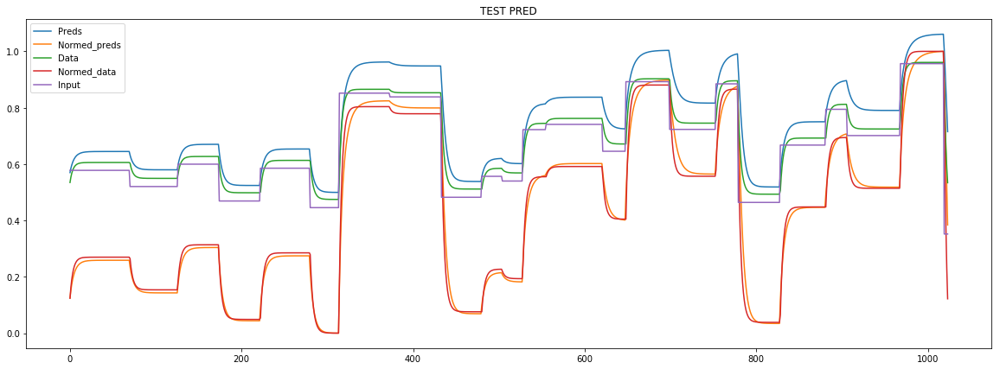

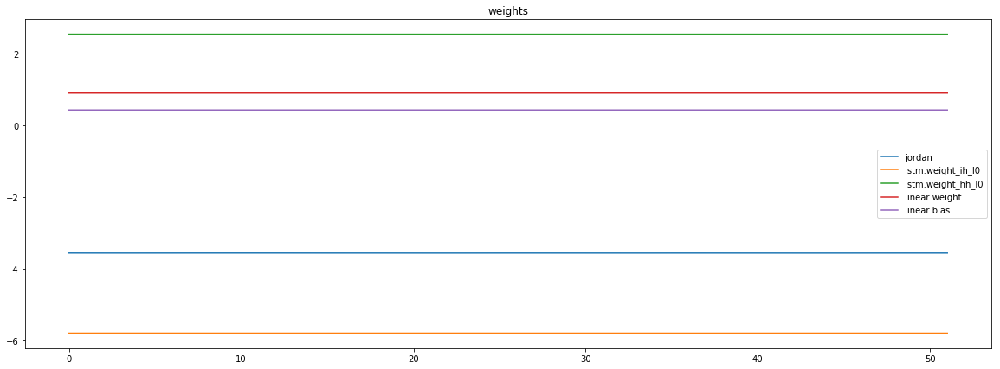

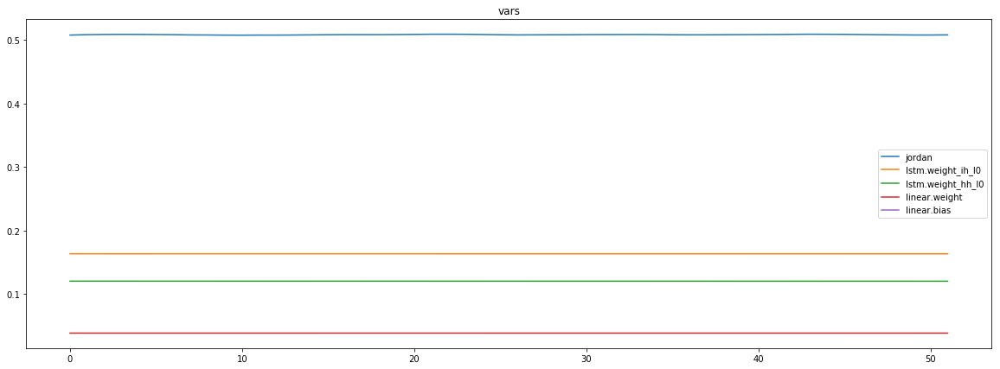

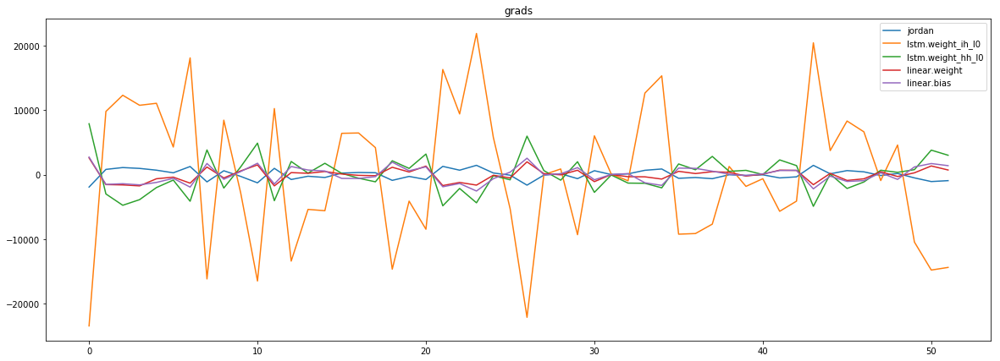

mean_p1 : -0.13928864552424505
mean_p2 : 10.450004724355844
mean_p3 : 6.768629294175368


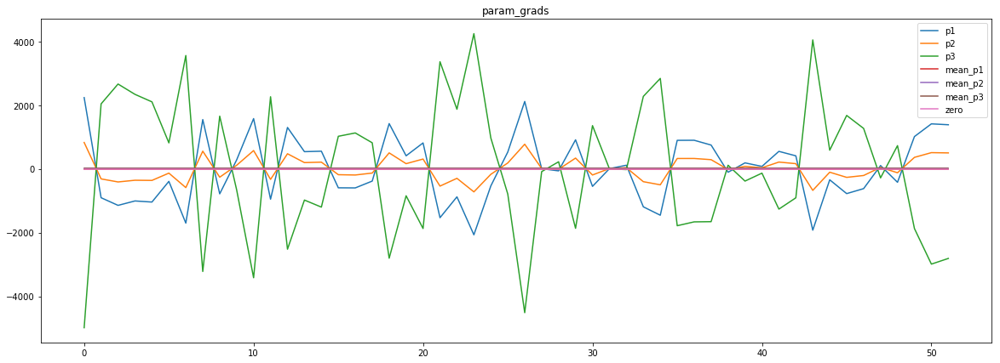

loss rate [1.676599094779796e-05]
Epoch [32] 
     train_loss[8526.843458909254] 
     eval_train[8526.386897160457] 
     eval_test[8730.229447798296]



aux preds: -0.9893207550048828           -1.9815853834152222           -0.5974509119987488
main loss 0.0
aux loss 8526.784395658053
jord loss 0.0
combined loss 8526.784395658053 



Parameter containing:
tensor([[-0.9893, -1.9816, -0.5975]], requires_grad=True)


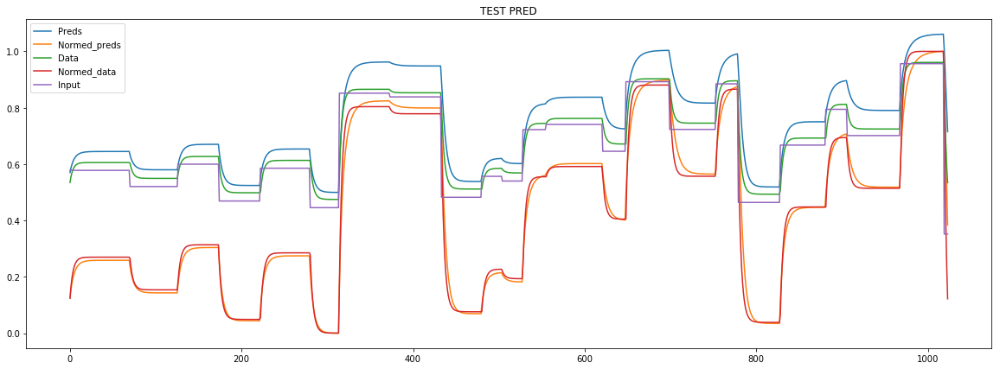

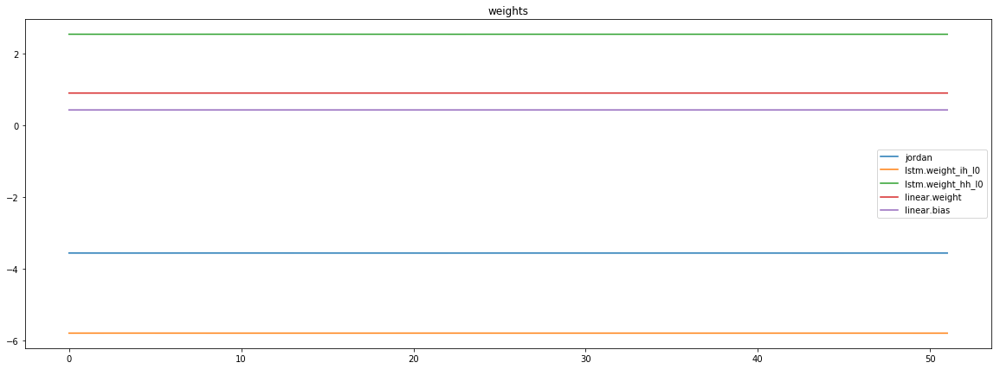

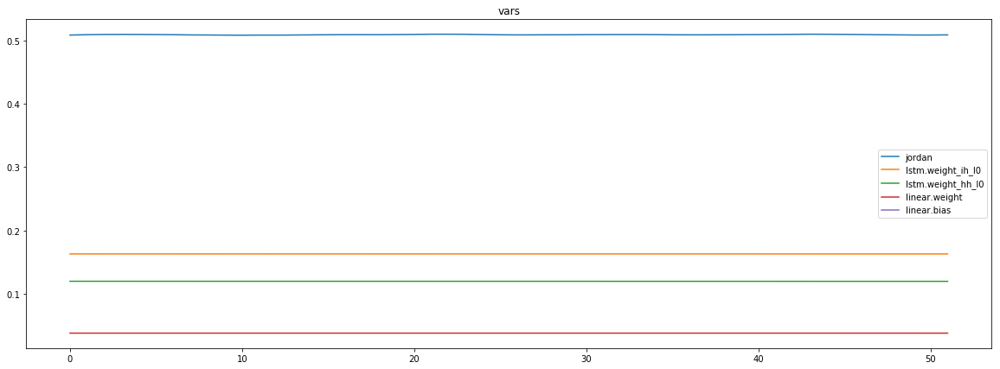

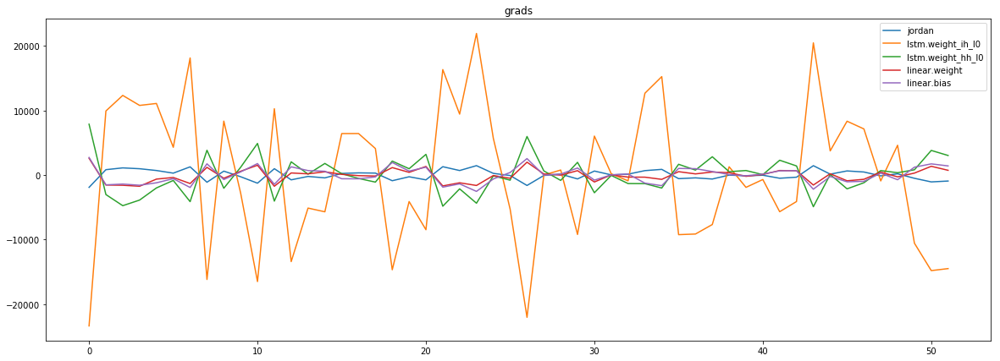

mean_p1 : -0.778380430661715
mean_p2 : 10.183895697960487
mean_p3 : 8.181827765244703


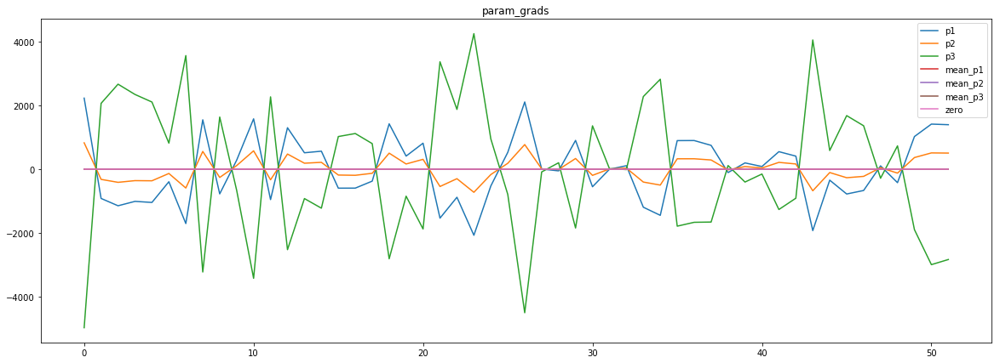

loss rate [1.4519634473075804e-05]
Epoch [33] 
     train_loss[8526.784395658053] 
     eval_train[8526.338669996996] 
     eval_test[8730.173717151989]



aux preds: -0.9893142580986023           -1.9825206995010376           -0.5975391268730164
main loss 0.0
aux loss 8526.719134990986
jord loss 0.0
combined loss 8526.719134990986 



Parameter containing:
tensor([[-0.9893, -1.9825, -0.5975]], requires_grad=True)


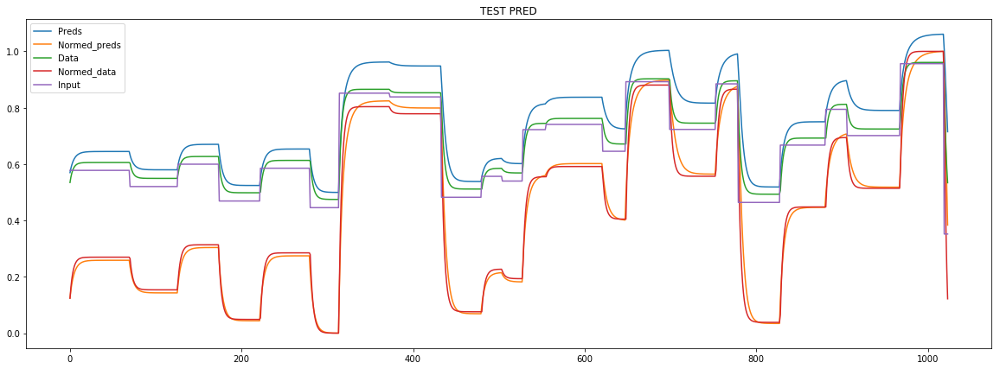

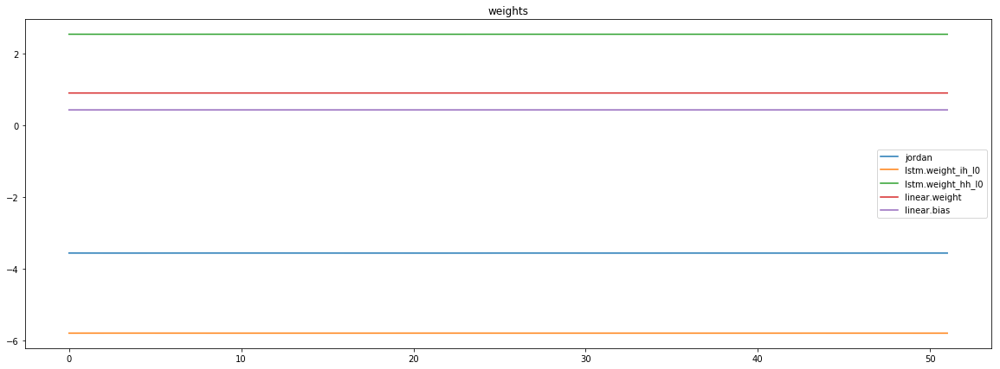

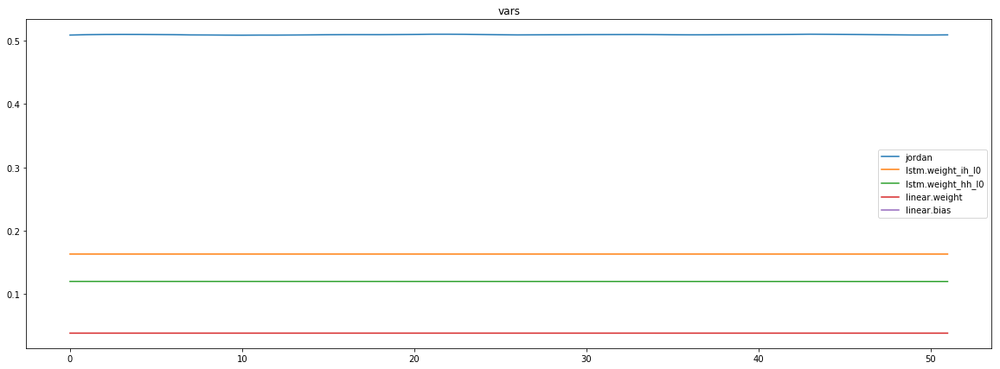

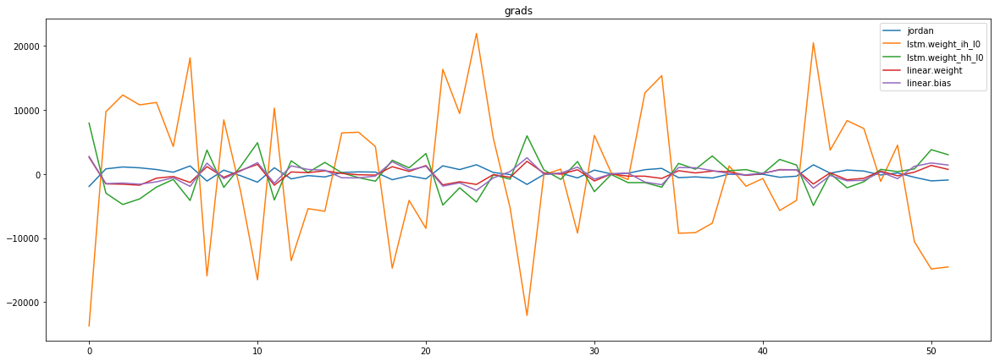

mean_p1 : 0.112304137303279
mean_p2 : 10.475972945873554
mean_p3 : 6.41494450202355


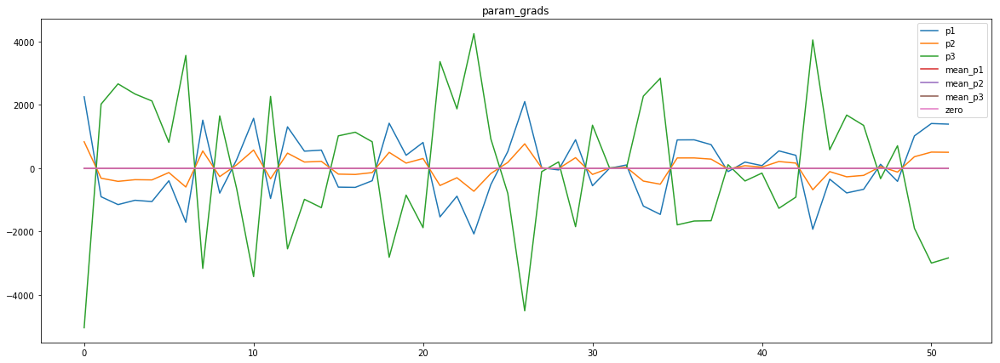

loss rate [1.55129243571972e-05]
Epoch [34] 
     train_loss[8526.719134990986] 
     eval_train[8526.25555889423] 
     eval_test[8730.098788174715]



aux preds: -0.989292323589325           -1.9834332466125488           -0.5976431965827942
main loss 0.0
aux loss 8526.658099834736
jord loss 0.0
combined loss 8526.658099834736 



Parameter containing:
tensor([[-0.9893, -1.9834, -0.5976]], requires_grad=True)


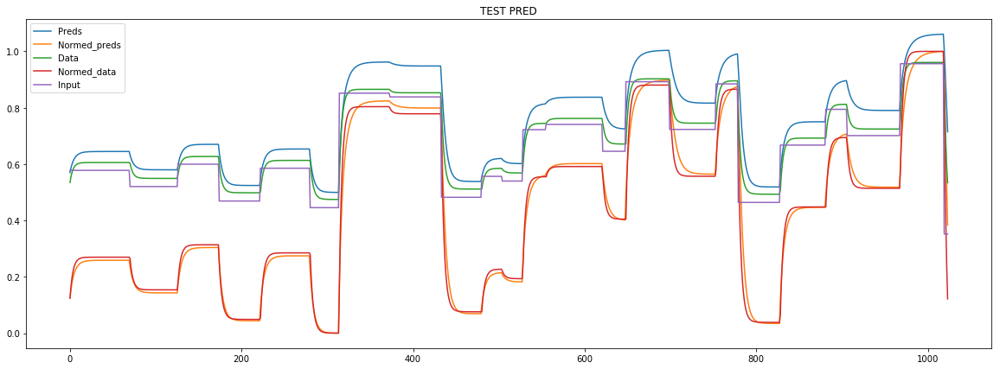

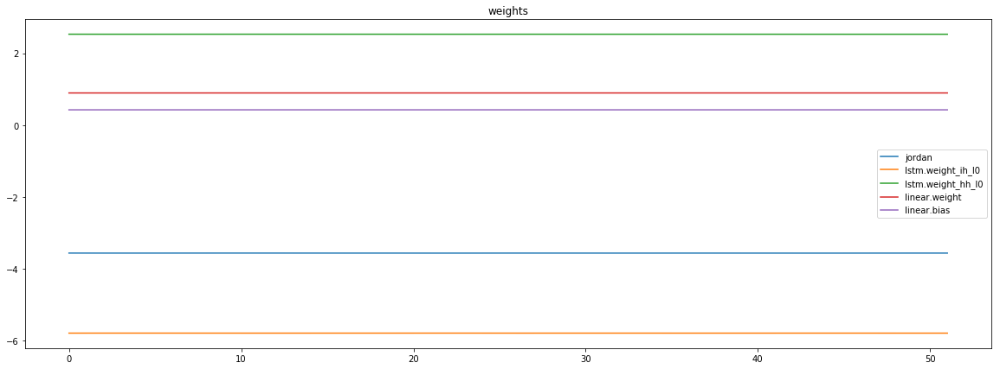

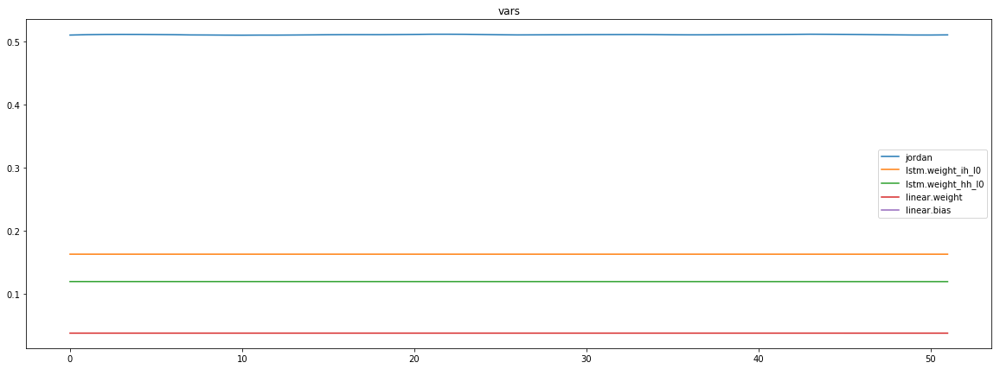

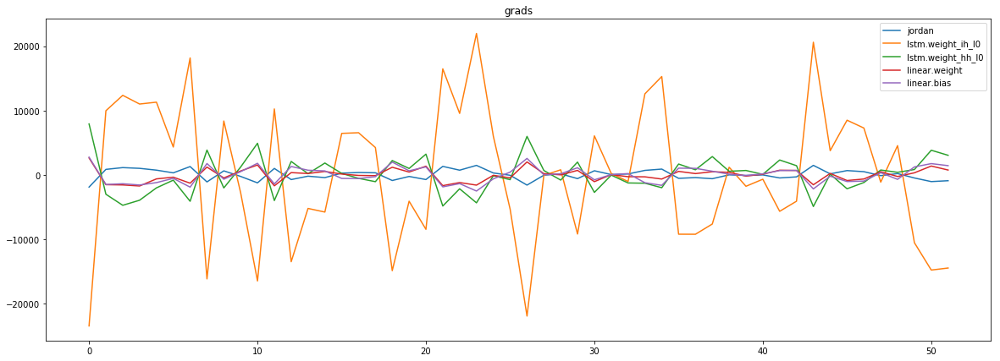

mean_p1 : -0.8467599795414851
mean_p2 : 10.086594920891981
mean_p3 : 8.451012538029598


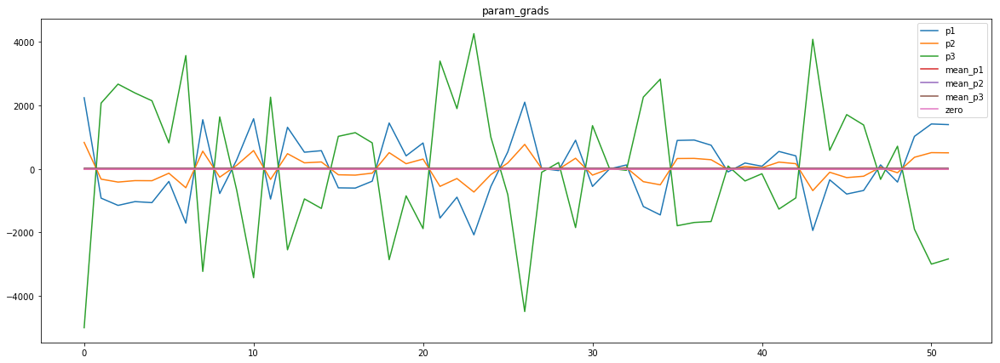

loss rate [1.4741882451541066e-05]
Epoch [35] 
     train_loss[8526.658099834736] 
     eval_train[8526.200523963342] 
     eval_test[8730.038618607954]



aux preds: -0.9892786145210266           -1.9843484163284302           -0.597740650177002
main loss 0.0
aux loss 8526.594191331129
jord loss 0.0
combined loss 8526.594191331129 



Parameter containing:
tensor([[-0.9893, -1.9843, -0.5977]], requires_grad=True)


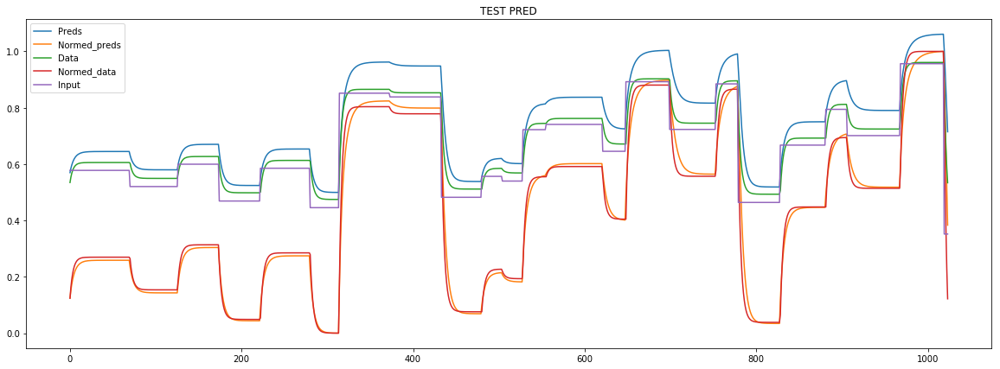

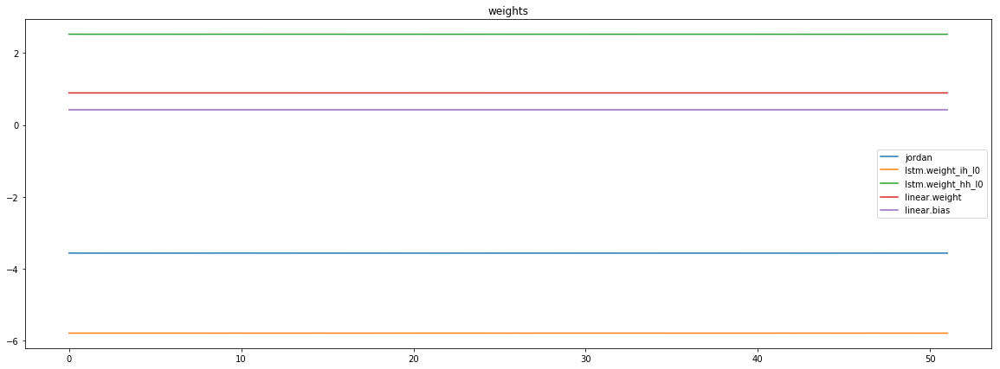

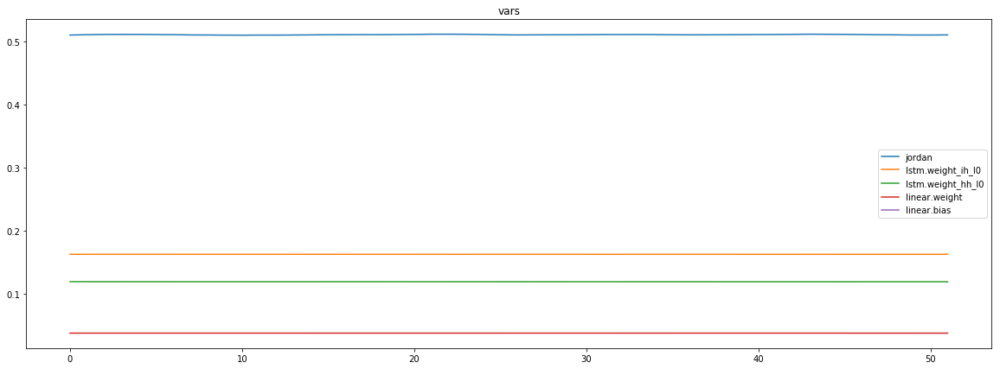

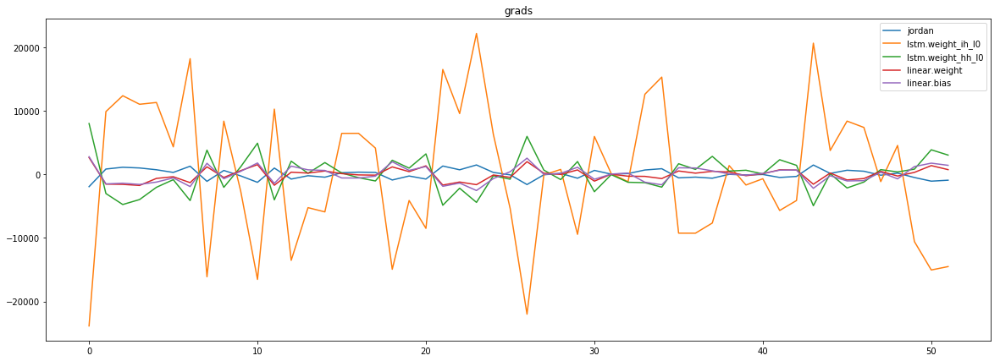

mean_p1 : -0.22513187848604643
mean_p2 : 10.283623640353863
mean_p3 : 7.250268055842473


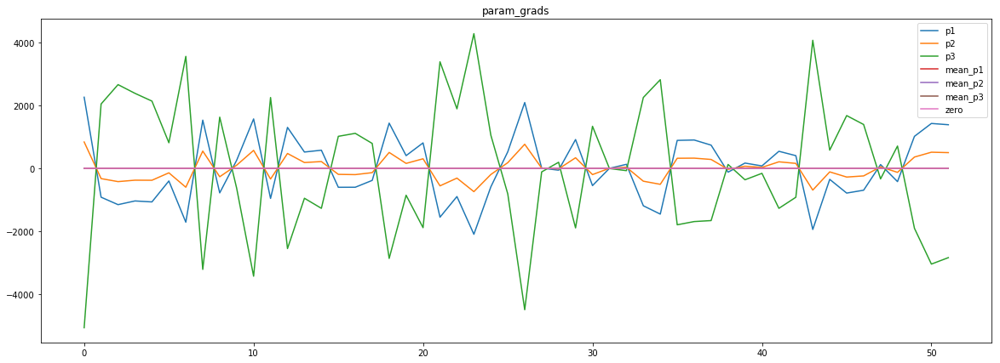

Epoch    36: reducing learning rate of group 0 to 2.5600e-04.
Epoch    36: reducing learning rate of group 1 to 2.5600e-05.
Epoch    36: reducing learning rate of group 2 to 2.5600e-05.
loss rate [1.4912324421967327e-05]
Epoch [36] 
     train_loss[8526.594191331129] 
     eval_train[8526.13613656851] 
     eval_test[8729.973521839489]



aux preds: -0.9892919659614563           -1.9847815036773682           -0.5977457761764526
main loss 0.0
aux loss 8526.14443734976
jord loss 0.0
combined loss 8526.14443734976 



Parameter containing:
tensor([[-0.9893, -1.9848, -0.5977]], requires_grad=True)


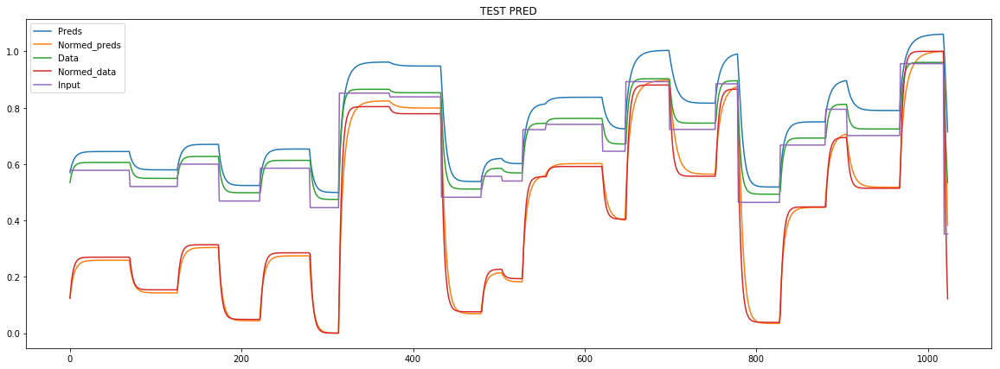

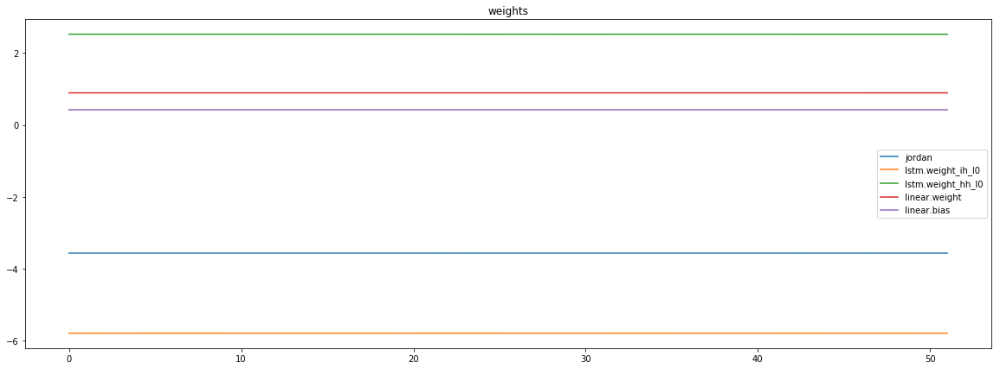

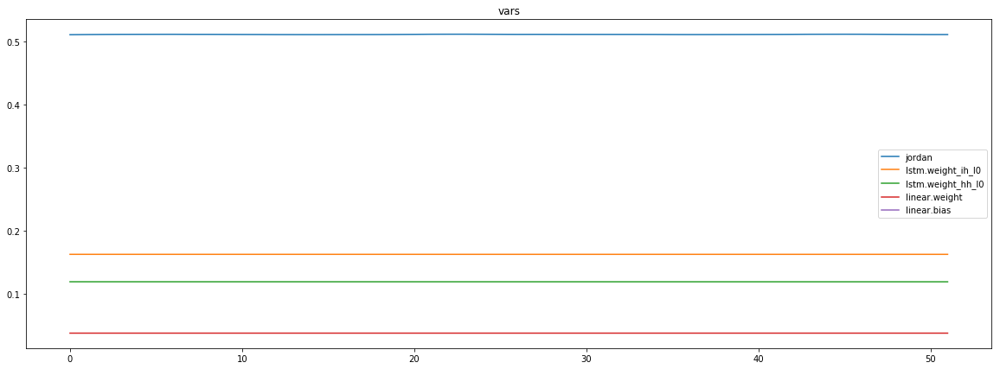

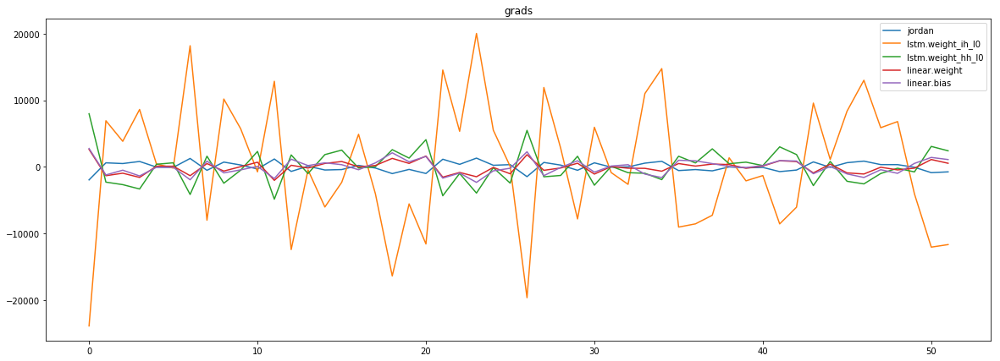

mean_p1 : -15.089858495272123
mean_p2 : 5.441909423241248
mean_p3 : 35.20176075055049


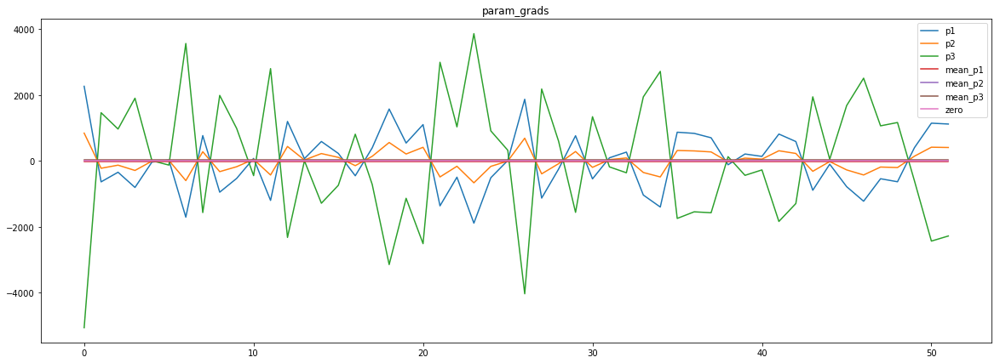

loss rate [1.7059009217890164e-05]
Epoch [37] 
     train_loss[8526.14443734976] 
     eval_train[8526.001643254207] 
     eval_test[8729.888050426136]



aux preds: -0.9892821907997131           -1.98521089553833           -0.5977858304977417
main loss 0.0
aux loss 8526.090247521033
jord loss 0.0
combined loss 8526.090247521033 



Parameter containing:
tensor([[-0.9893, -1.9852, -0.5978]], requires_grad=True)


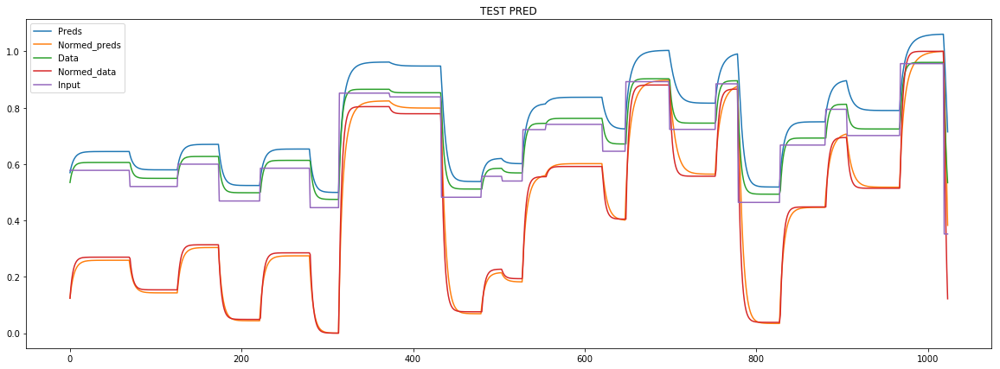

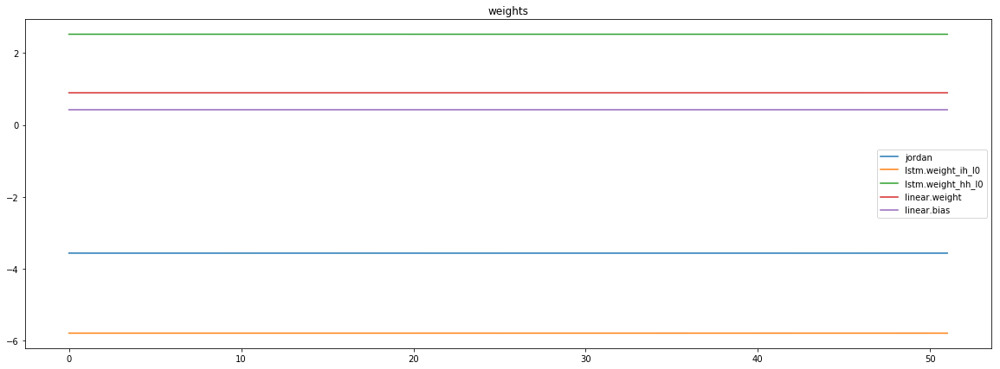

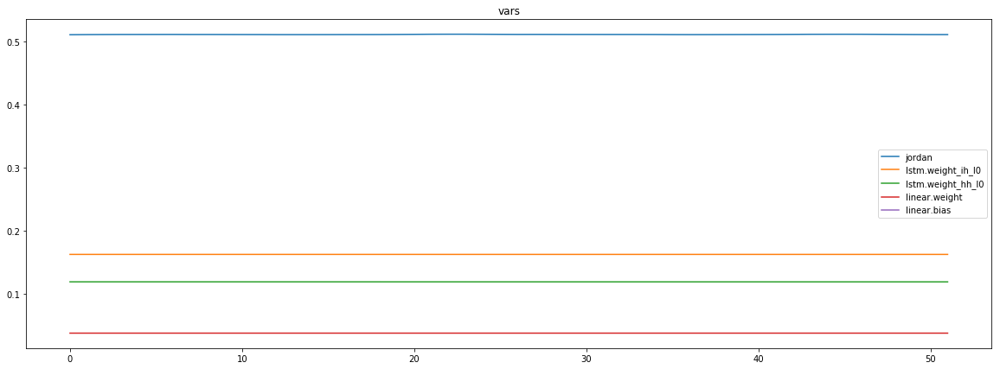

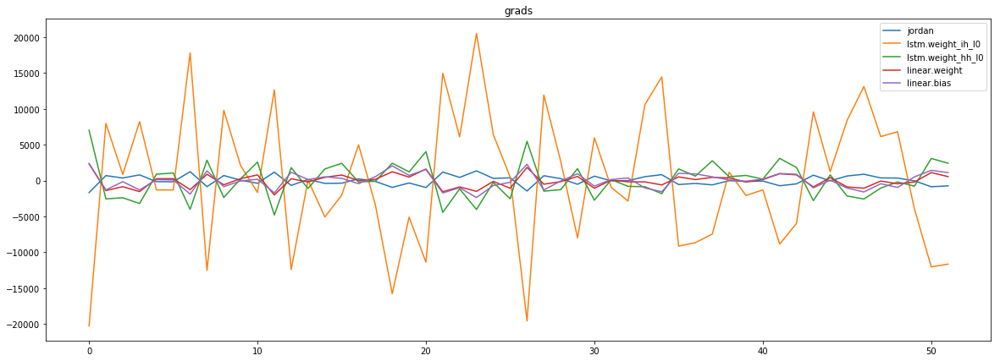

mean_p1 : -2.7089482087355394
mean_p2 : 9.815202474594116
mean_p3 : 10.35093014056866


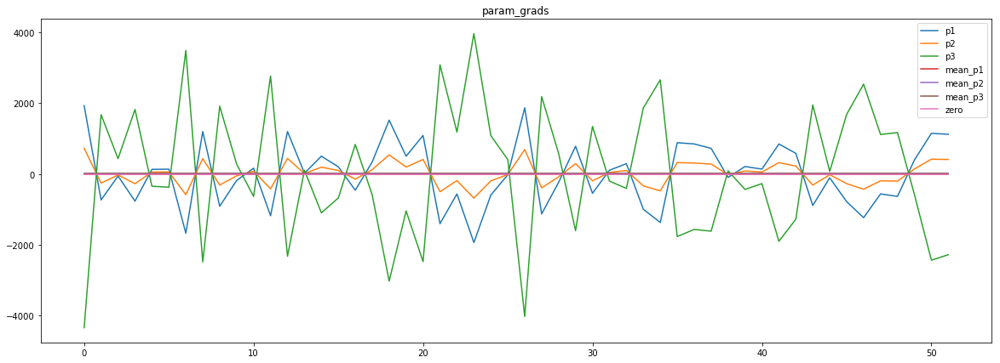

loss rate [1.2846477970396286e-05]
Epoch [38] 
     train_loss[8526.090247521033] 
     eval_train[8525.971369816707] 
     eval_test[8729.85458096591]



aux preds: -0.9892753958702087           -1.9856419563293457           -0.5978262424468994
main loss 0.0
aux loss 8526.062950721154
jord loss 0.0
combined loss 8526.062950721154 



Parameter containing:
tensor([[-0.9893, -1.9856, -0.5978]], requires_grad=True)


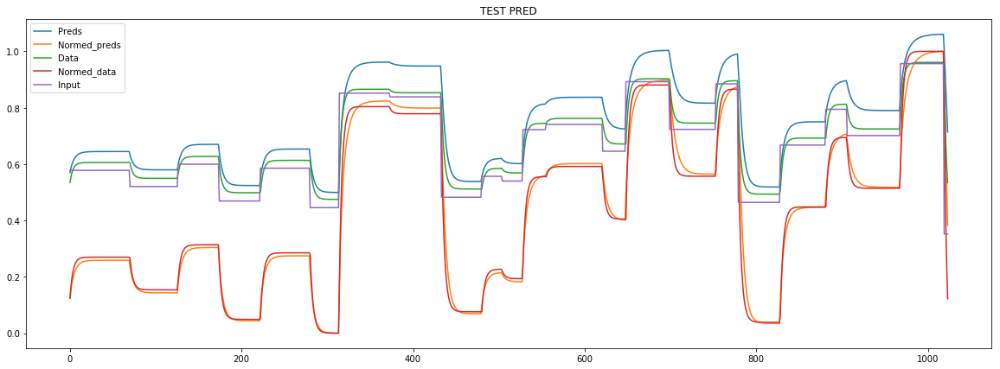

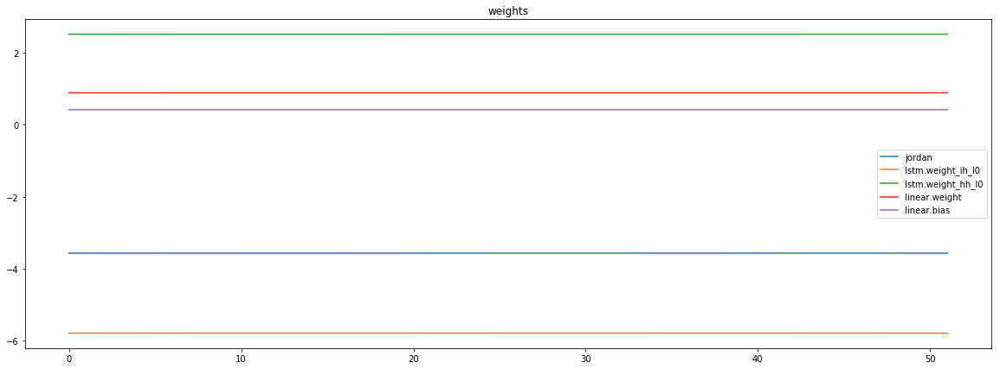

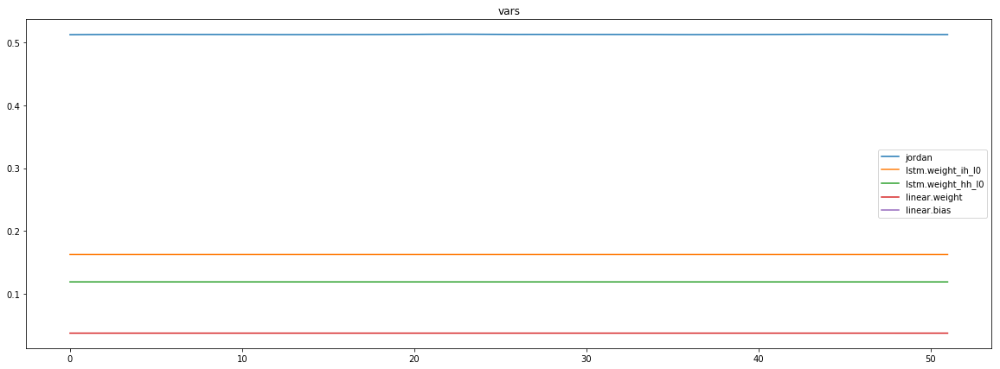

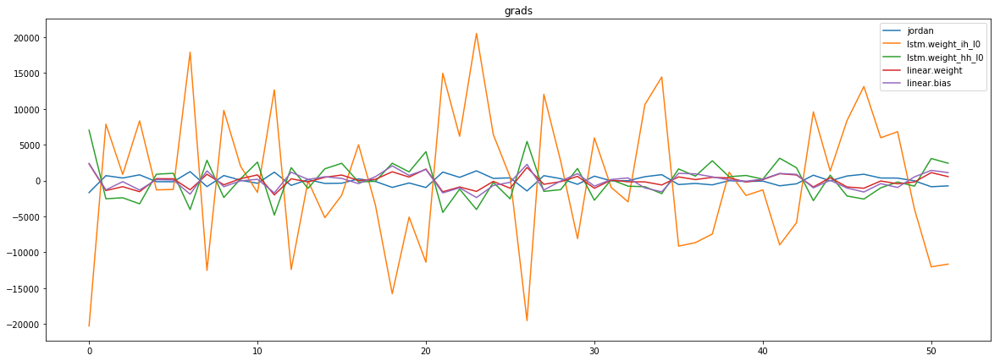

mean_p1 : -2.411031796382024
mean_p2 : 9.878901610007652
mean_p3 : 10.128522872924805


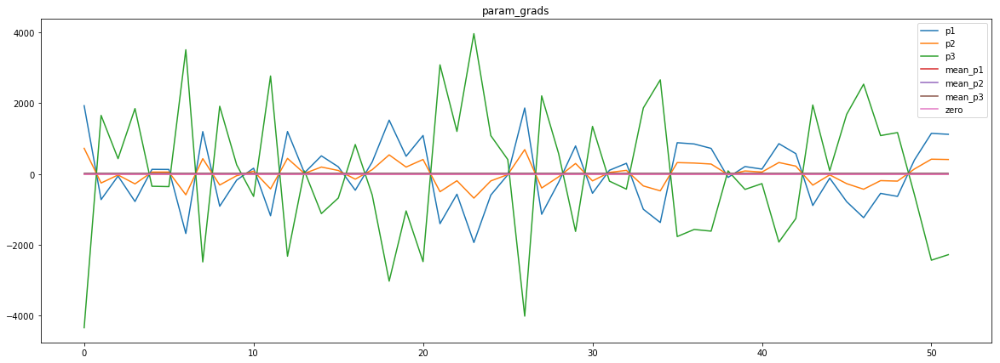

loss rate [9.531324826395071e-06]
Epoch [39] 
     train_loss[8526.062950721154] 
     eval_train[8525.942223182092] 
     eval_test[8729.82217684659]



aux preds: -0.9892701506614685           -1.9860721826553345           -0.5978680849075317
main loss 0.0
aux loss 8526.035043569711
jord loss 0.0
combined loss 8526.035043569711 



Parameter containing:
tensor([[-0.9893, -1.9861, -0.5979]], requires_grad=True)


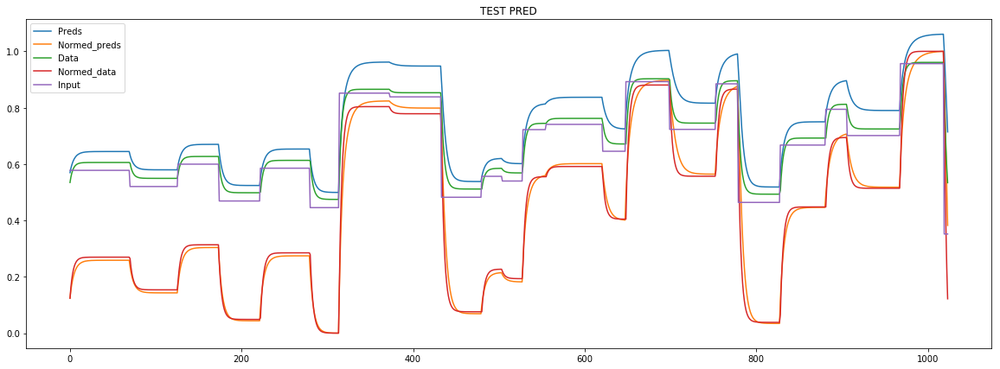

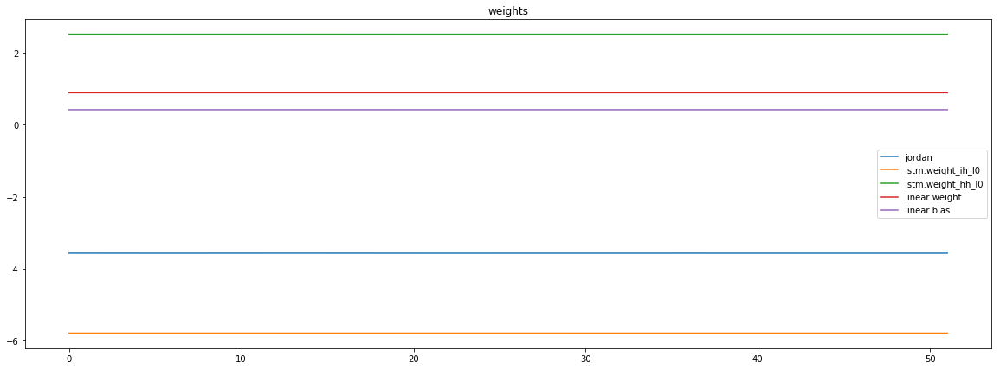

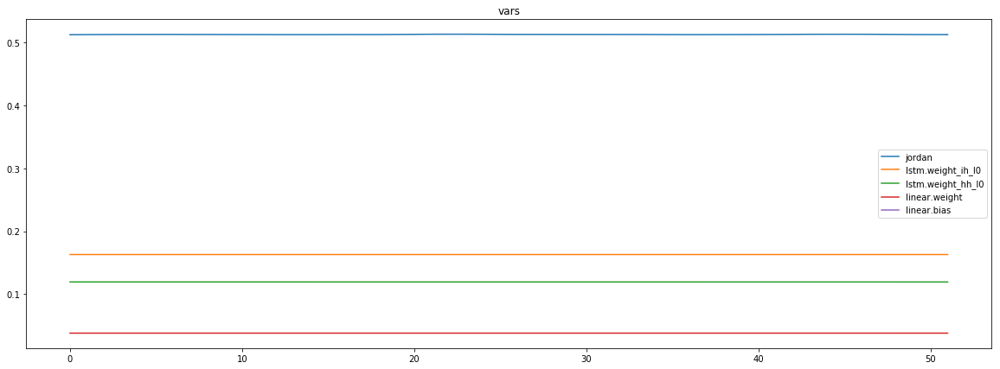

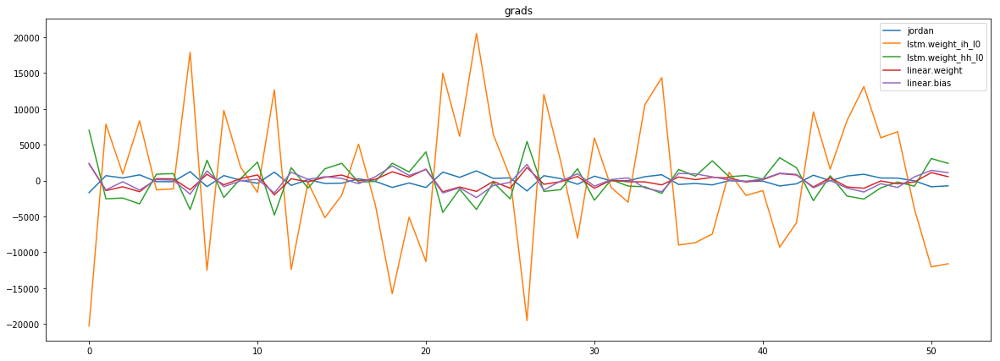

mean_p1 : -2.494377796466534
mean_p2 : 9.786923078390268
mean_p3 : 10.757303824791542


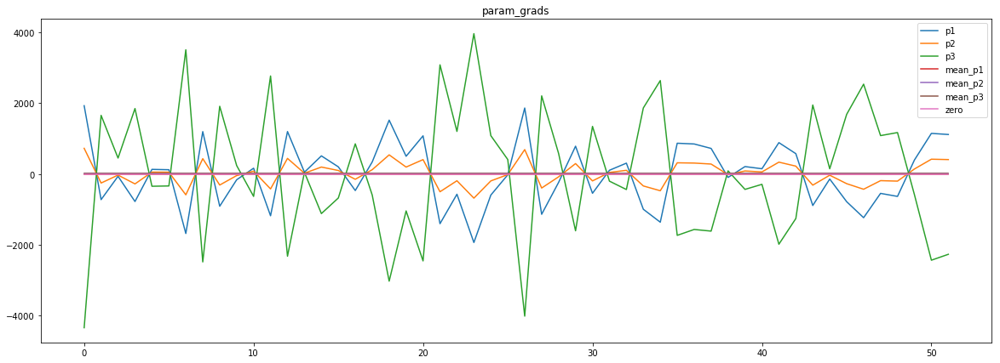

loss rate [7.243238557386178e-06]
Epoch [40] 
     train_loss[8526.035043569711] 
     eval_train[8525.915424053486] 
     eval_test[8729.791703657671]



aux preds: -0.9892699122428894           -1.986505389213562           -0.5979068279266357
main loss 0.0
aux loss 8526.005587064303
jord loss 0.0
combined loss 8526.005587064303 



Parameter containing:
tensor([[-0.9893, -1.9865, -0.5979]], requires_grad=True)


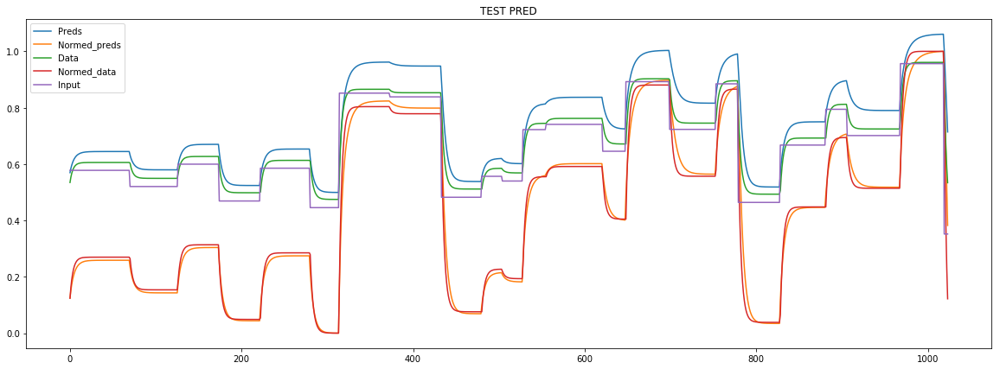

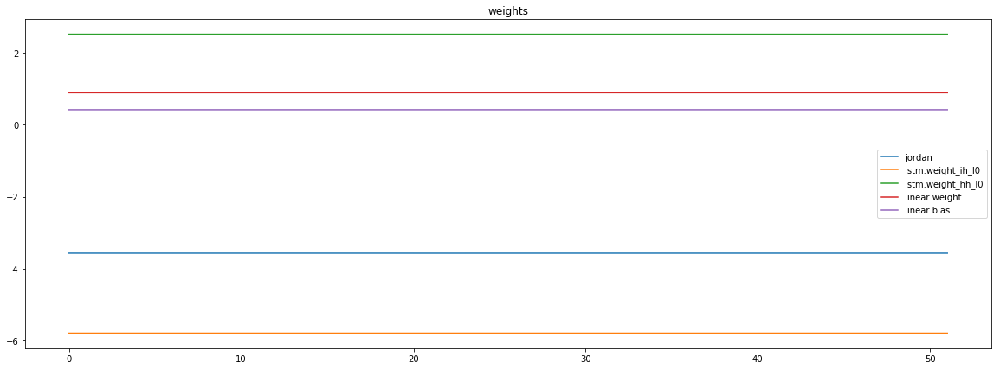

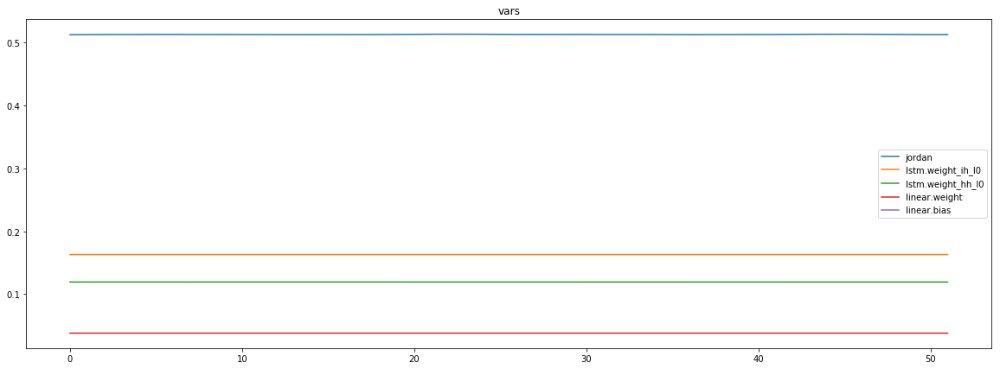

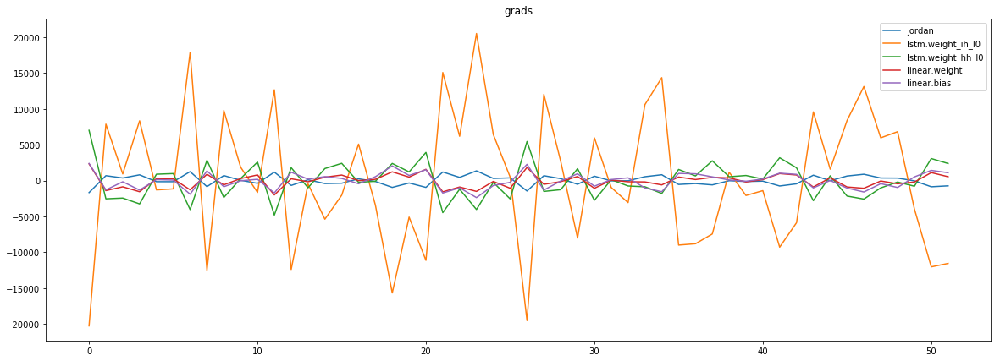

mean_p1 : -2.1829725412222056
mean_p2 : 9.870585441589355
mean_p3 : 10.320686945548424


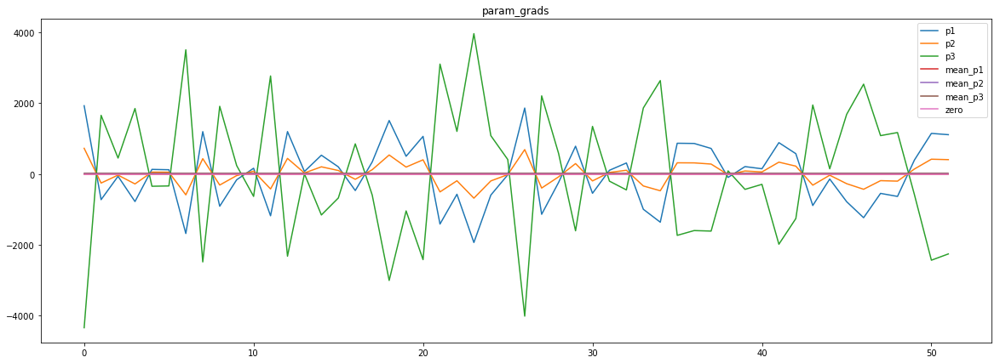

loss rate [7.1822478772132214e-06]
Epoch [41] 
     train_loss[8526.005587064303] 
     eval_train[8525.883779672477] 
     eval_test[8729.760120738636]



aux preds: -0.9892661571502686           -1.986933946609497           -0.5979506969451904
main loss 0.0
aux loss 8525.976487379809
jord loss 0.0
combined loss 8525.976487379809 



Parameter containing:
tensor([[-0.9893, -1.9869, -0.5980]], requires_grad=True)


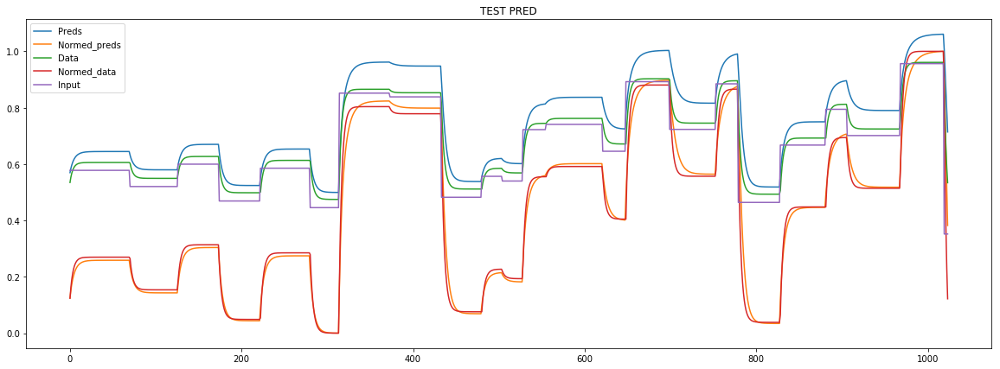

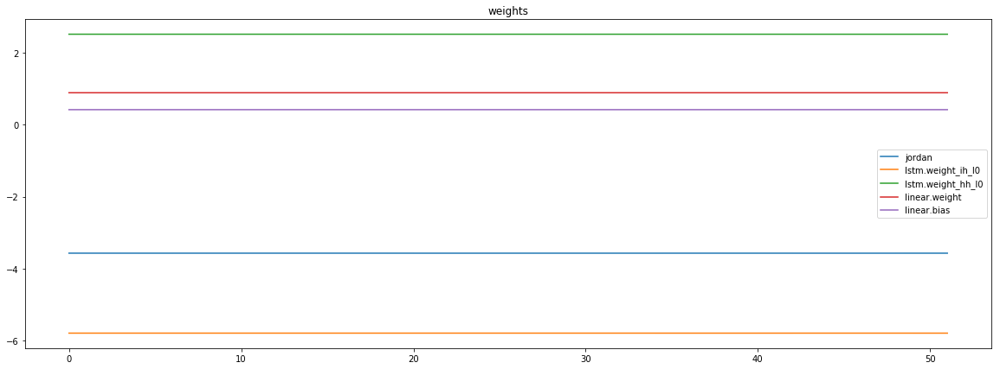

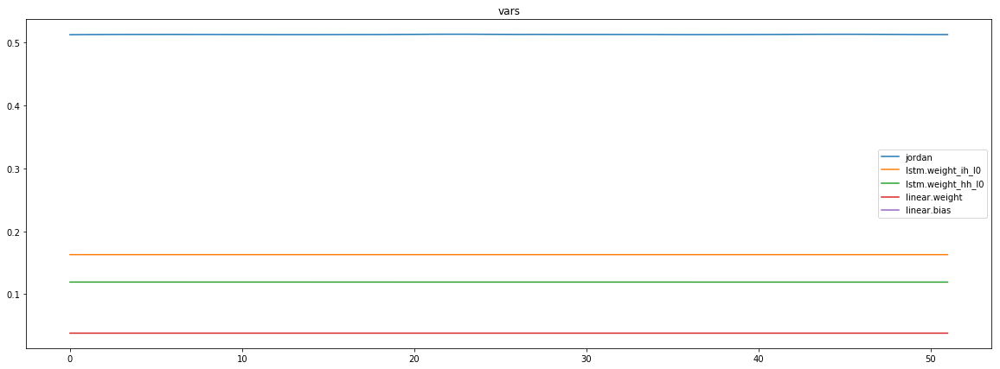

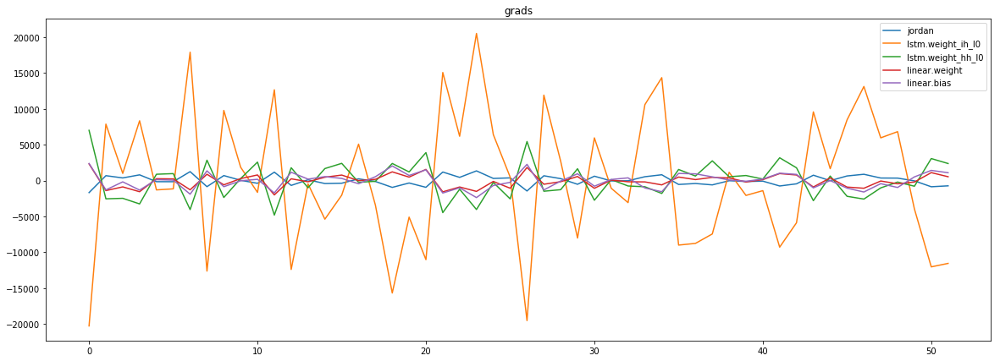

mean_p1 : -2.38093141409067
mean_p2 : 9.774762300344614
mean_p3 : 10.981058084047758


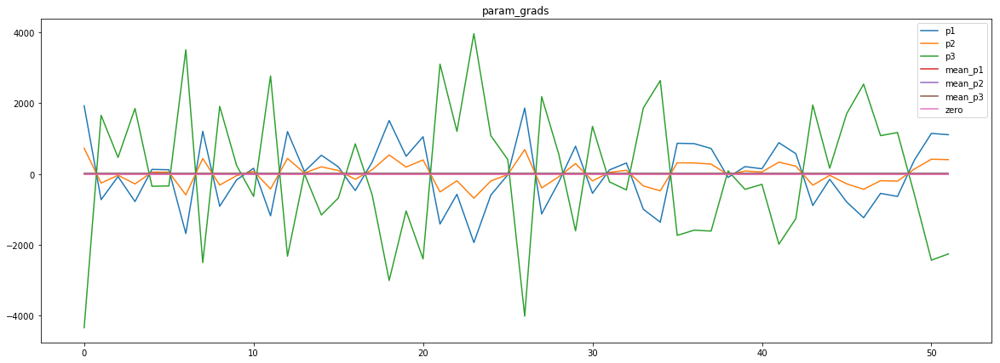

loss rate [6.9441358551136645e-06]
Epoch [42] 
     train_loss[8525.976487379809] 
     eval_train[8525.859177809496] 
     eval_test[8729.730712890625]



aux preds: -0.9892677664756775           -1.9873660802841187           -0.5979896783828735
main loss 0.0
aux loss 8525.947434645434
jord loss 0.0
combined loss 8525.947434645434 



Parameter containing:
tensor([[-0.9893, -1.9874, -0.5980]], requires_grad=True)


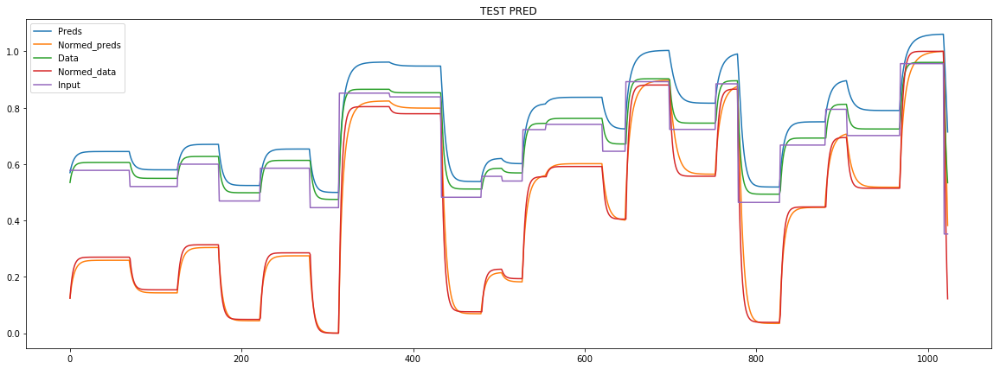

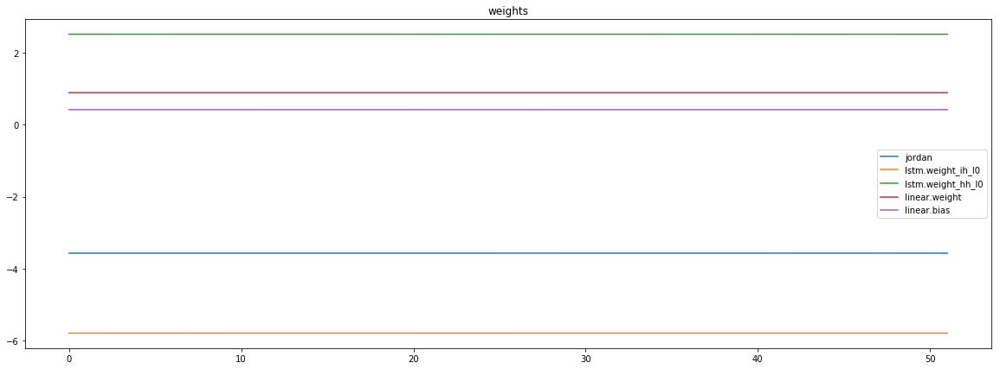

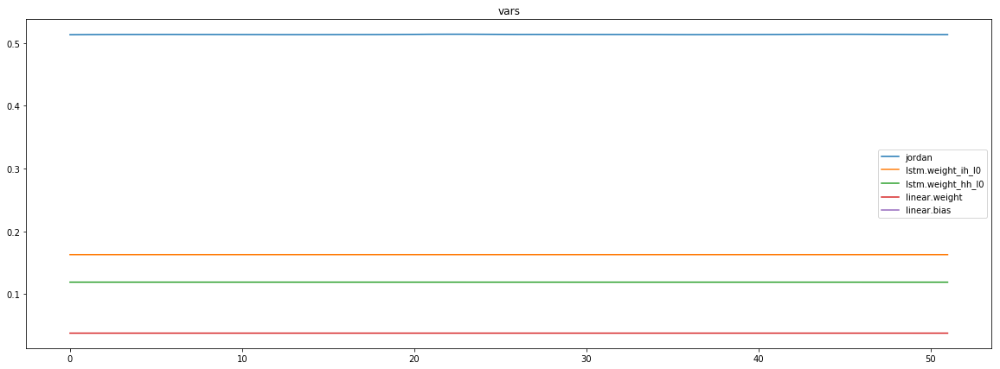

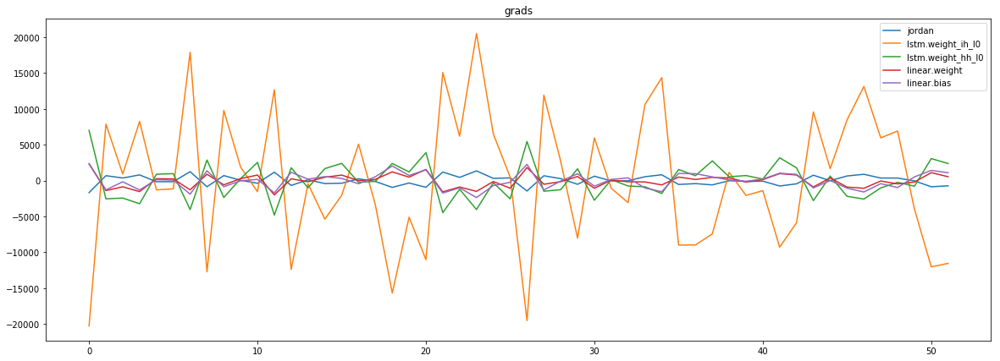

mean_p1 : -2.0349045533400316
mean_p2 : 9.872803908128004
mean_p3 : 10.363337425085215


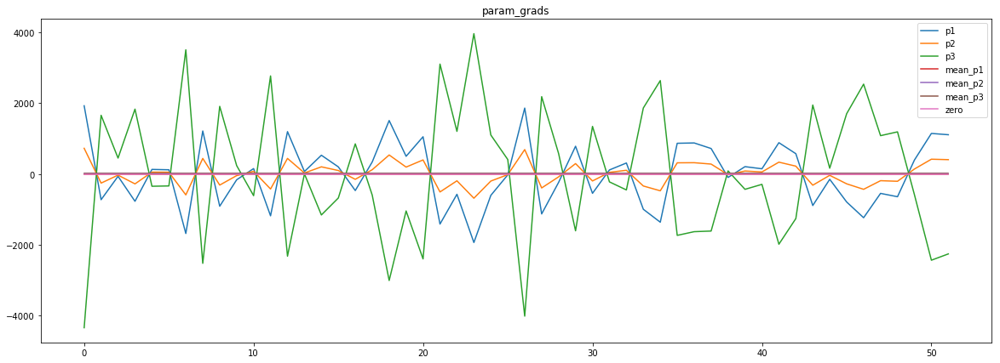

loss rate [6.9678892359315014e-06]
Epoch [43] 
     train_loss[8525.947434645434] 
     eval_train[8525.827955979566] 
     eval_test[8729.700017755682]



aux preds: -0.9892714619636536           -1.987798810005188           -0.5980283617973328
main loss 0.0
aux loss 8525.917339618389
jord loss 0.0
combined loss 8525.917339618389 



Parameter containing:
tensor([[-0.9893, -1.9878, -0.5980]], requires_grad=True)


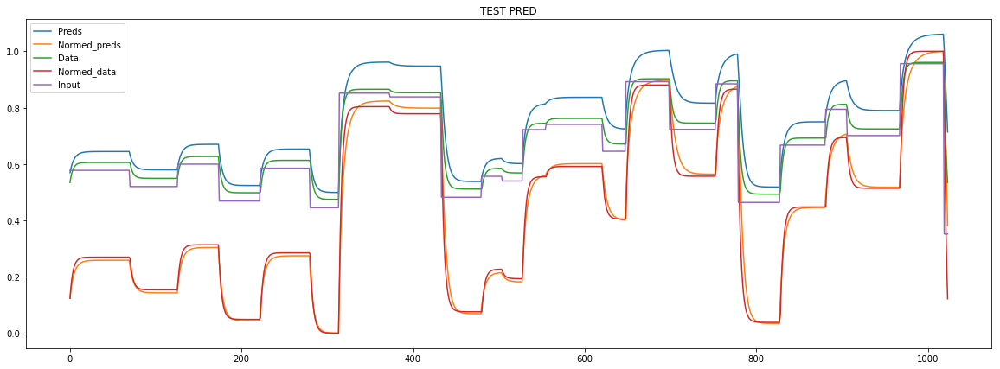

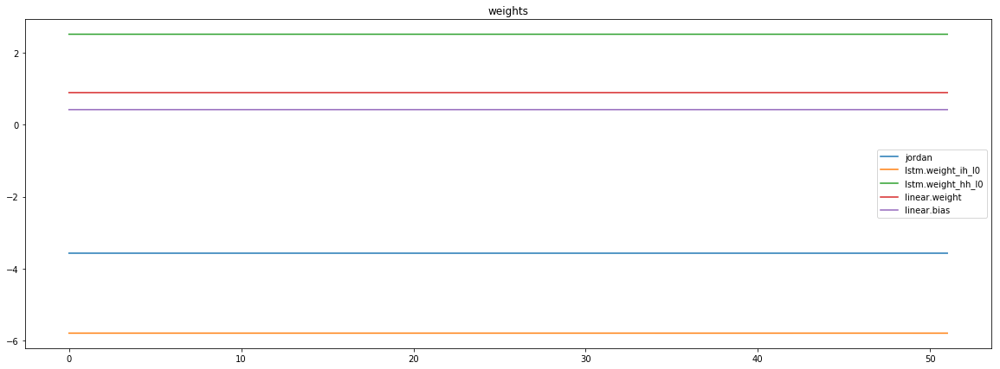

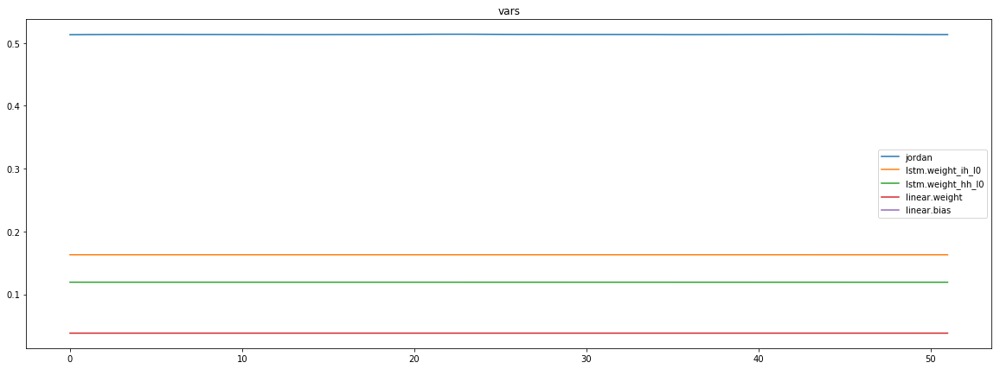

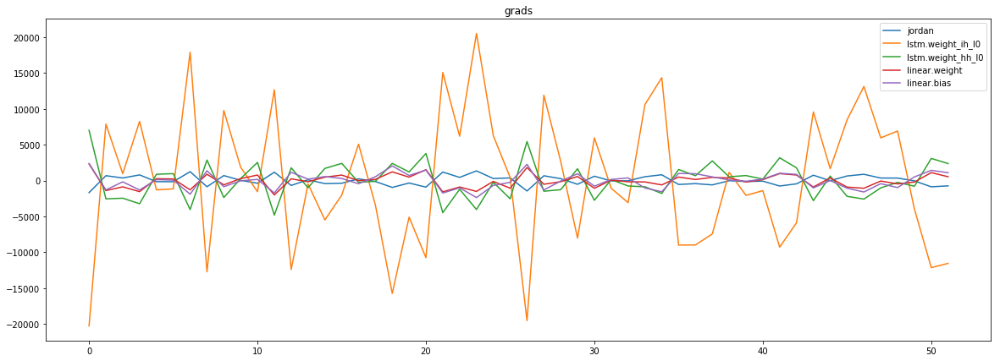

mean_p1 : -1.6555905708899865
mean_p2 : 9.978570406253521
mean_p3 : 9.815409348561214


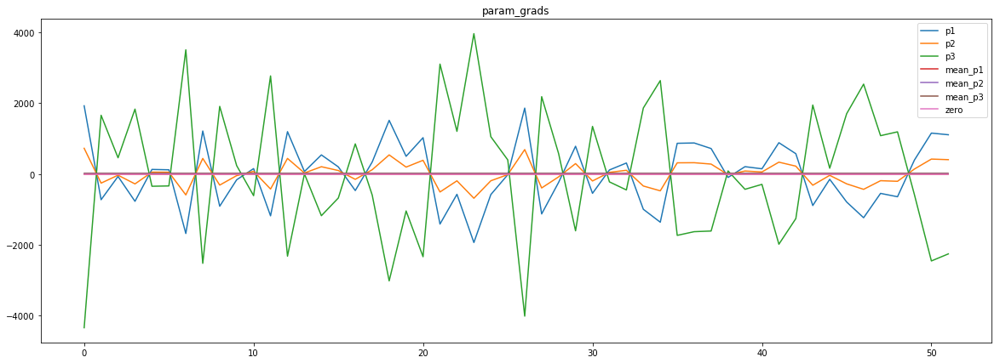

loss rate [7.031474019147943e-06]
Epoch [44] 
     train_loss[8525.917339618389] 
     eval_train[8525.796396108773] 
     eval_test[8729.668900923296]



aux preds: -0.9892753958702087           -1.9882304668426514           -0.598068118095398
main loss 0.0
aux loss 8525.887498121996
jord loss 0.0
combined loss 8525.887498121996 



Parameter containing:
tensor([[-0.9893, -1.9882, -0.5981]], requires_grad=True)


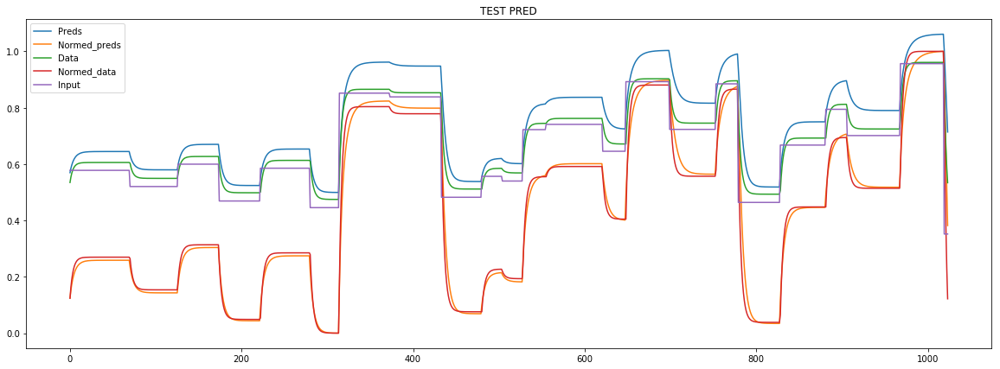

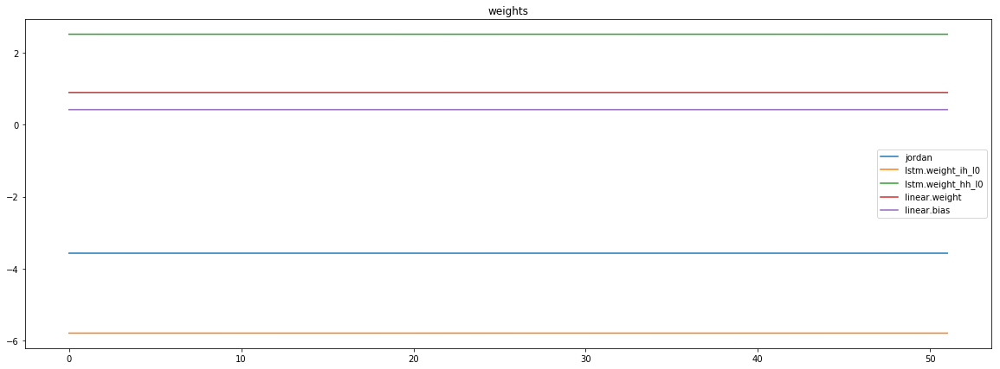

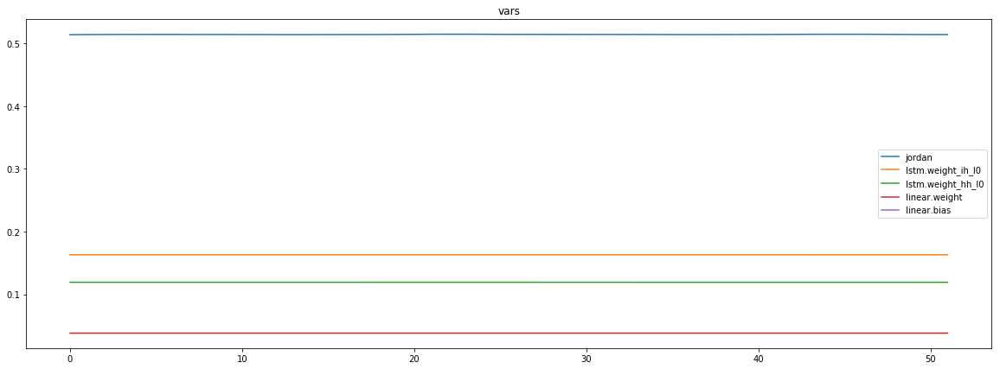

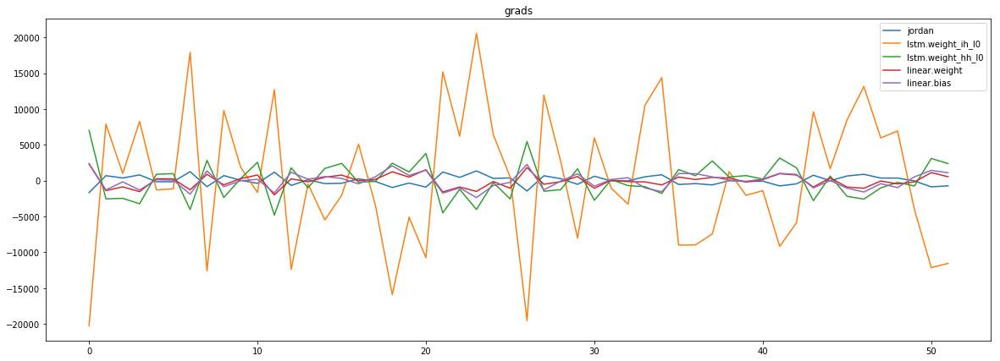

mean_p1 : -1.705384767972506
mean_p2 : 9.938229157374455
mean_p3 : 10.080465115033663


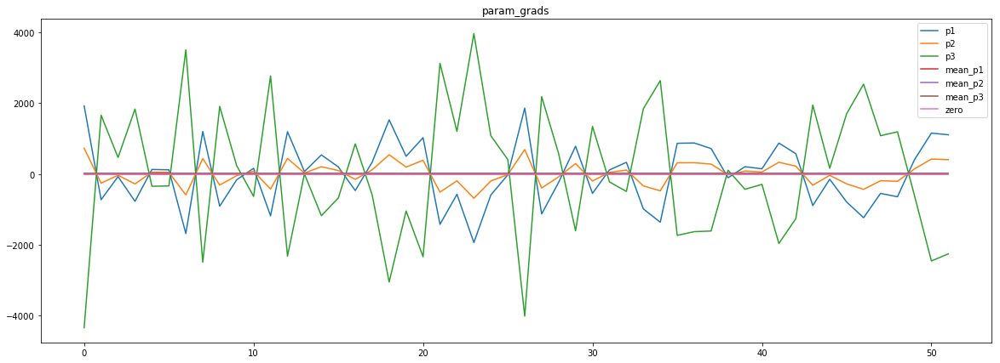

Epoch    45: reducing learning rate of group 0 to 1.0240e-04.
Epoch    45: reducing learning rate of group 1 to 1.0240e-05.
Epoch    45: reducing learning rate of group 2 to 1.0240e-05.
loss rate [6.947598504281061e-06]
Epoch [45] 
     train_loss[8525.887498121996] 
     eval_train[8525.76650766226] 
     eval_test[8729.639226740057]



aux preds: -0.9893666505813599           -1.9885022640228271           -0.598002016544342
main loss 0.0
aux loss 8525.712026742789
jord loss 0.0
combined loss 8525.712026742789 



Parameter containing:
tensor([[-0.9894, -1.9885, -0.5980]], requires_grad=True)


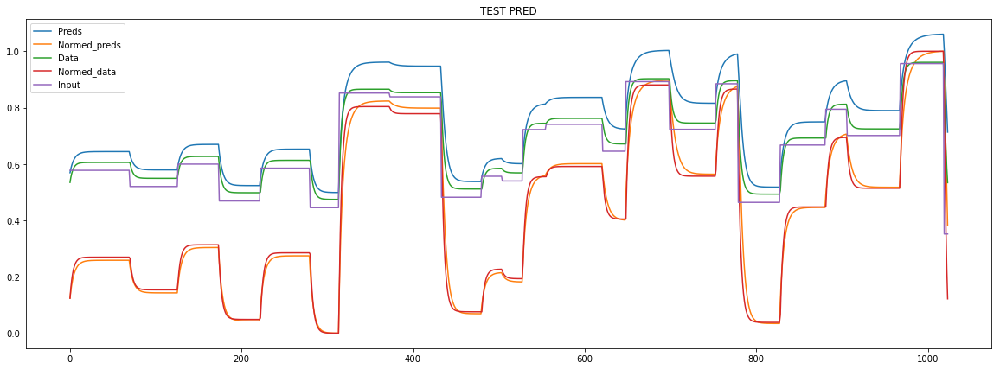

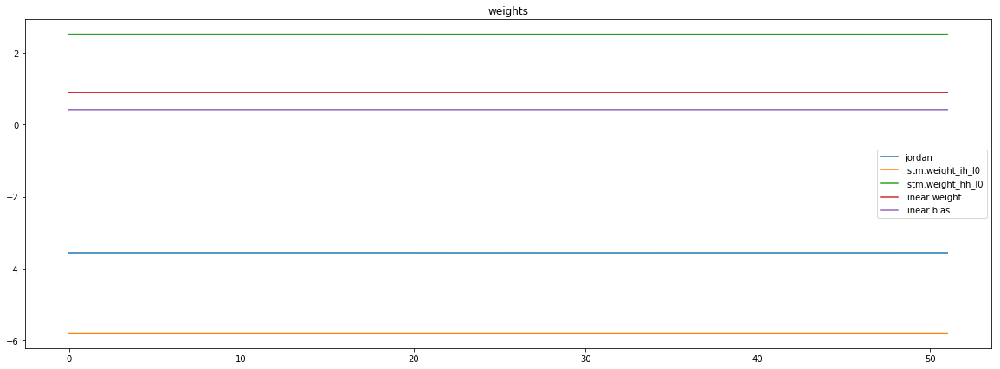

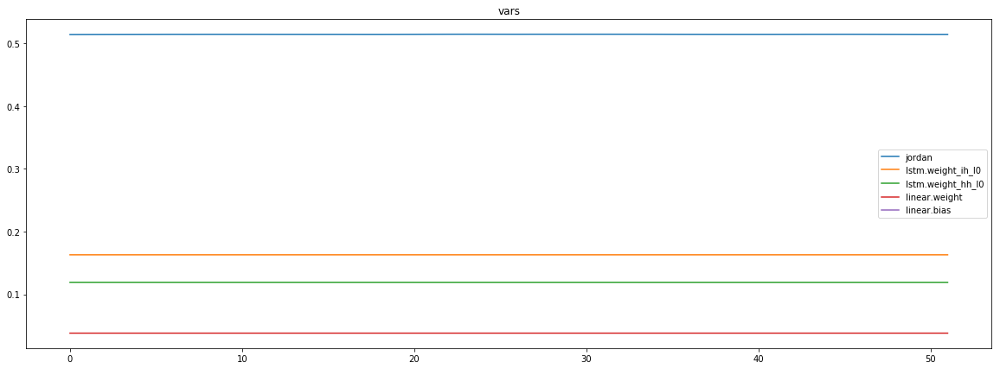

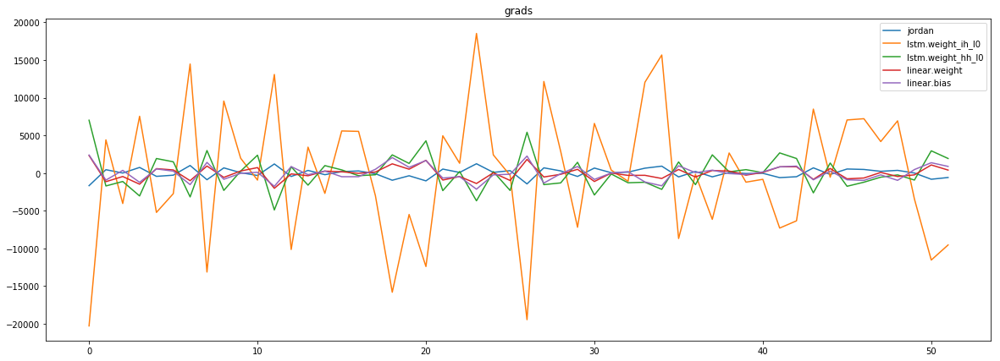

mean_p1 : 17.408282940204327
mean_p2 : 16.82236231290377
mean_p3 : -28.309998292189377


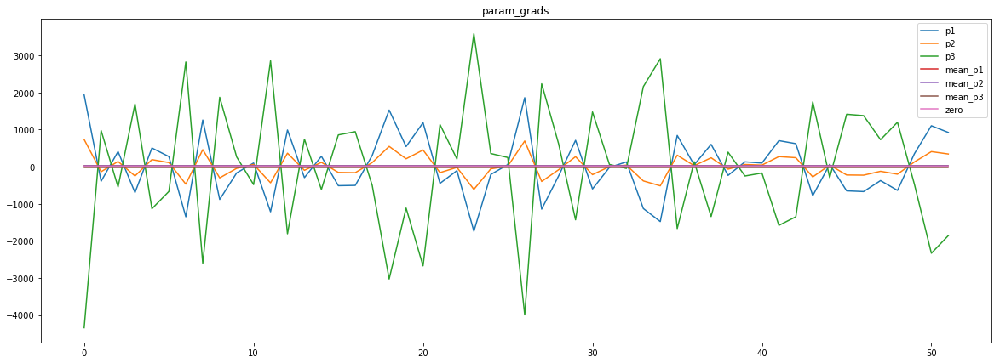

loss rate [7.478991337461771e-06]
Epoch [46] 
     train_loss[8525.712026742789] 
     eval_train[8525.649461012621] 
     eval_test[8729.60409268466]



aux preds: -0.9893679022789001           -1.9886915683746338           -0.5980255007743835
main loss 0.0
aux loss 8525.695941631611
jord loss 0.0
combined loss 8525.695941631611 



Parameter containing:
tensor([[-0.9894, -1.9887, -0.5980]], requires_grad=True)


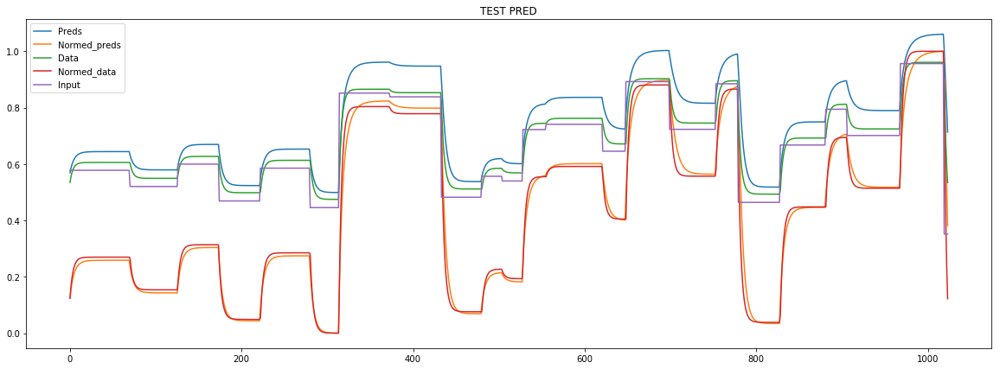

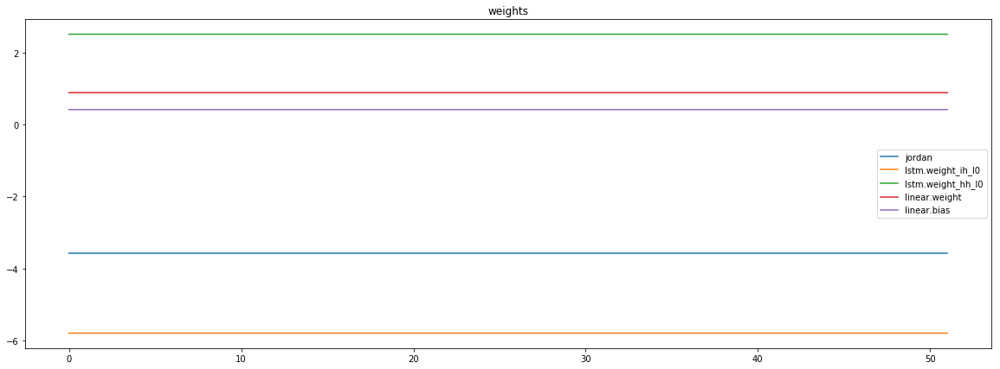

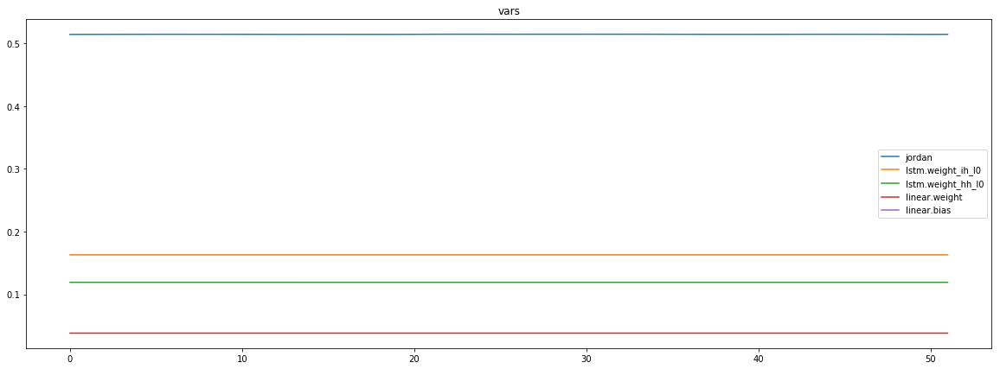

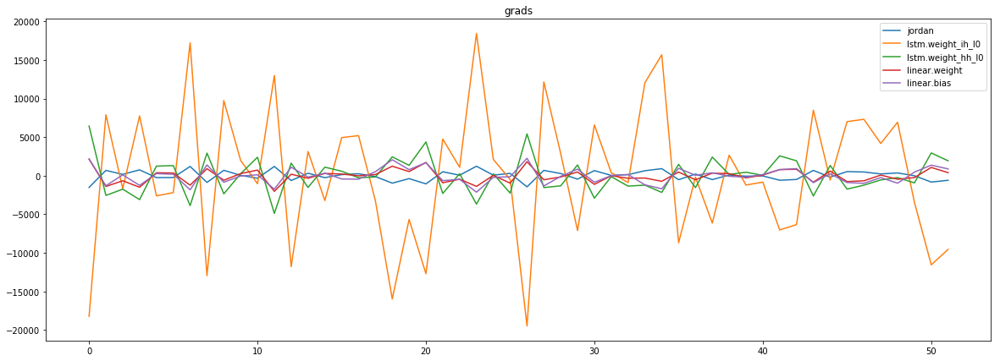

mean_p1 : 0.0698560568002554
mean_p2 : 10.659367598020113
mean_p3 : 7.807691354017991


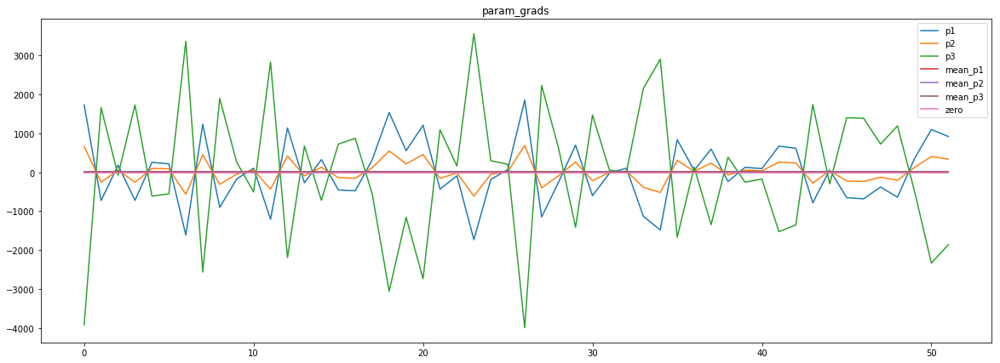

loss rate [5.084885256634308e-06]
Epoch [47] 
     train_loss[8525.695941631611] 
     eval_train[8525.637404221754] 
     eval_test[8729.593017578125]



aux preds: -0.9893702864646912           -1.9888819456100464           -0.5980474948883057
main loss 0.0
aux loss 8525.683546799879
jord loss 0.0
combined loss 8525.683546799879 



Parameter containing:
tensor([[-0.9894, -1.9889, -0.5980]], requires_grad=True)


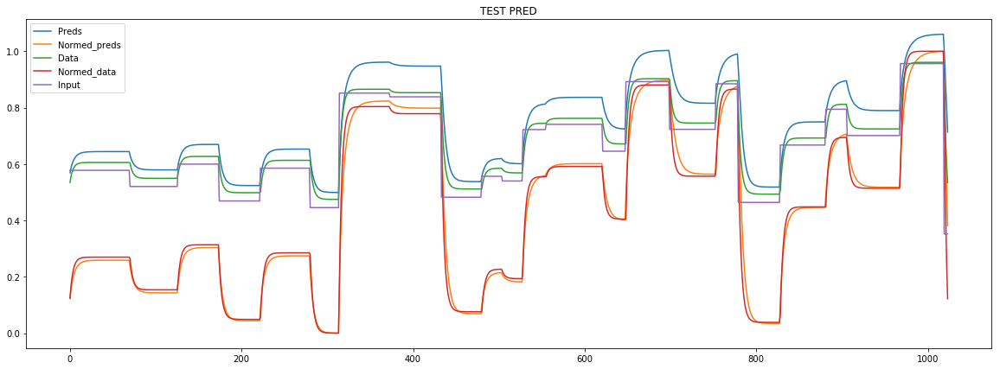

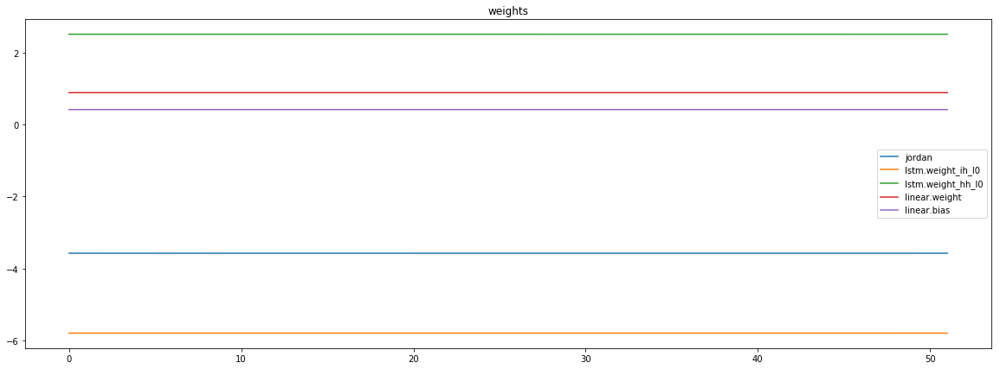

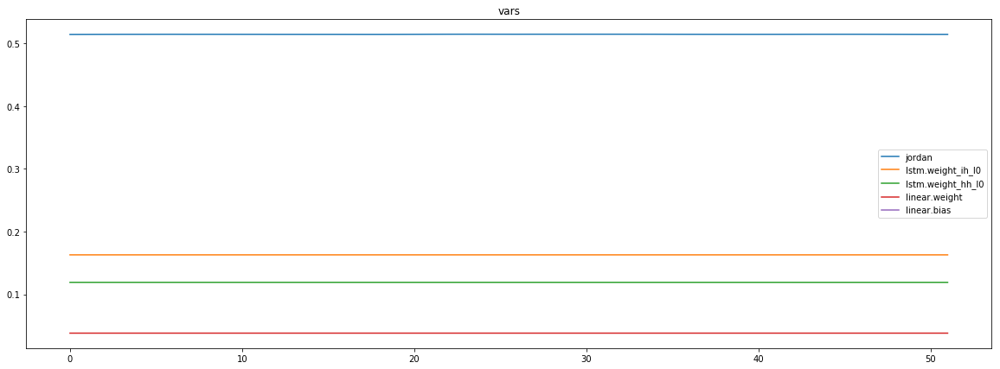

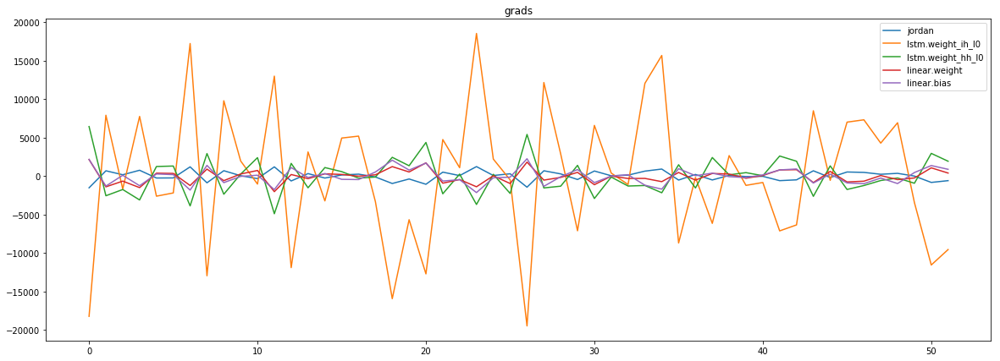

mean_p1 : 0.16881884061373198
mean_p2 : 10.702744208849394
mean_p3 : 7.399306370661809


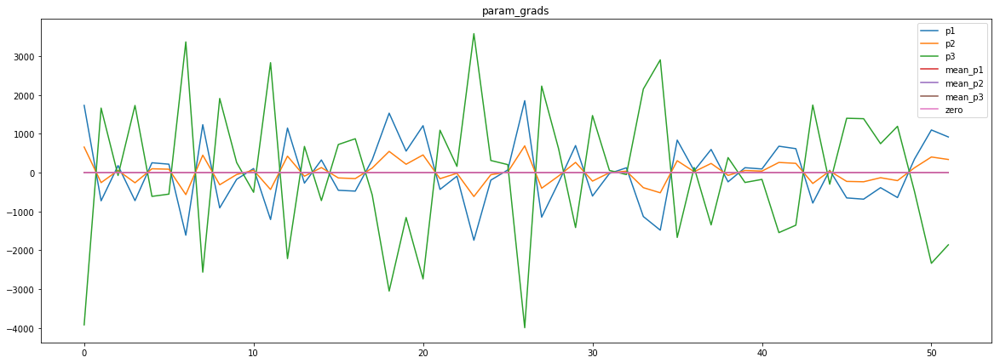

loss rate [3.471291726619974e-06]
Epoch [48] 
     train_loss[8525.683546799879] 
     eval_train[8525.624070387621] 
     eval_test[8729.581809303978]



aux preds: -0.9893720746040344           -1.9890714883804321           -0.5980694890022278
main loss 0.0
aux loss 8525.670842097355
jord loss 0.0
combined loss 8525.670842097355 



Parameter containing:
tensor([[-0.9894, -1.9891, -0.5981]], requires_grad=True)


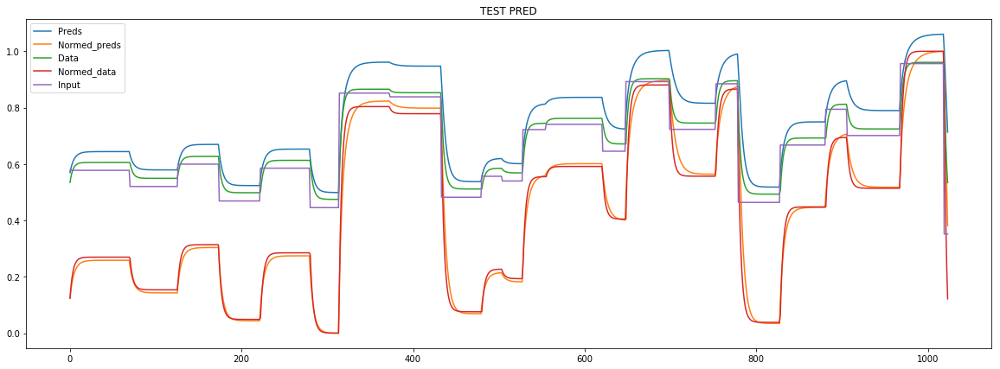

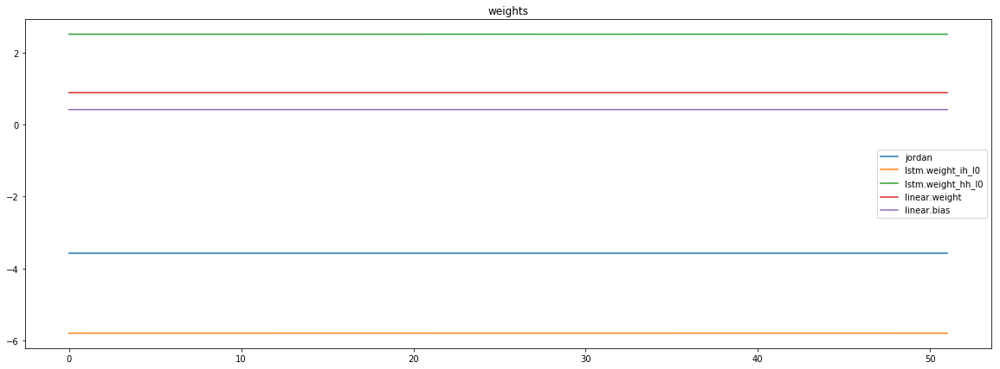

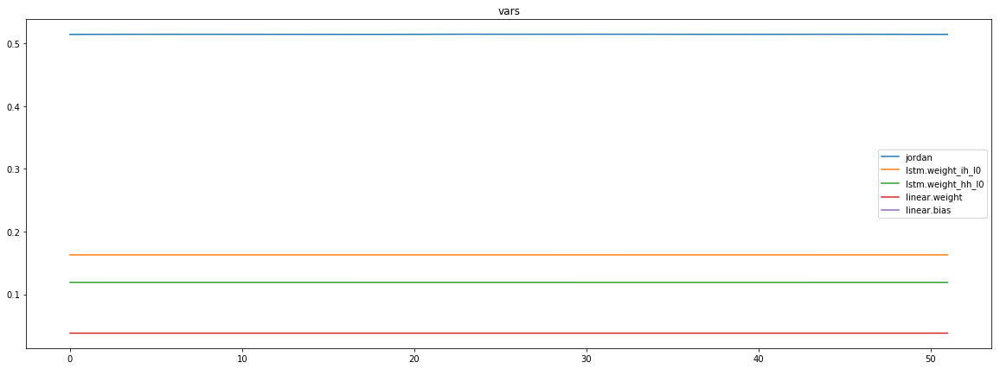

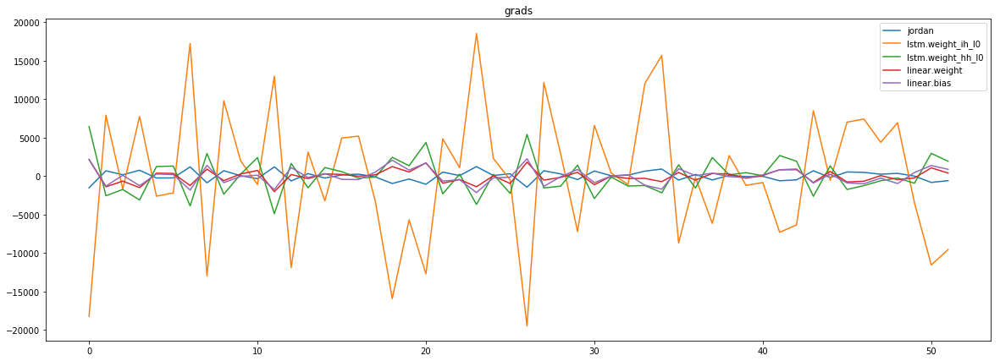

mean_p1 : 0.025564120366023138
mean_p2 : 10.655844174898588
mean_p3 : 7.526194939246545


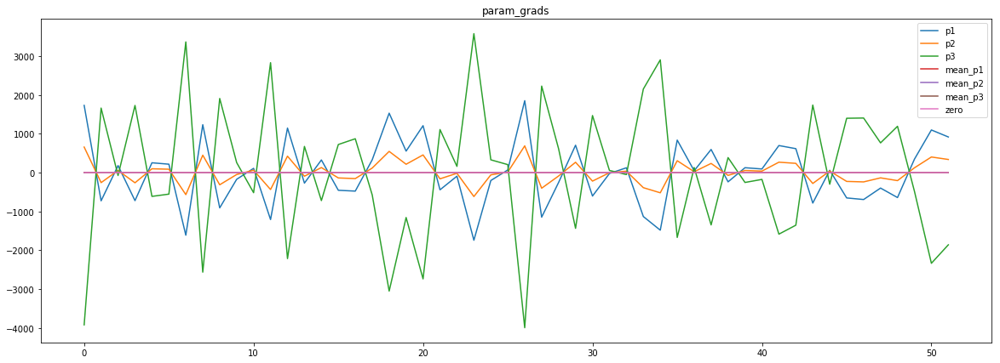

loss rate [2.633983969935194e-06]
Epoch [49] 
     train_loss[8525.670842097355] 
     eval_train[8525.61102764423] 
     eval_test[8729.569979580965]



aux preds: -0.9893739223480225           -1.9892607927322388           -0.598091185092926
main loss 0.0
aux loss 8525.658034104566
jord loss 0.0
combined loss 8525.658034104566 



Parameter containing:
tensor([[-0.9894, -1.9893, -0.5981]], requires_grad=True)


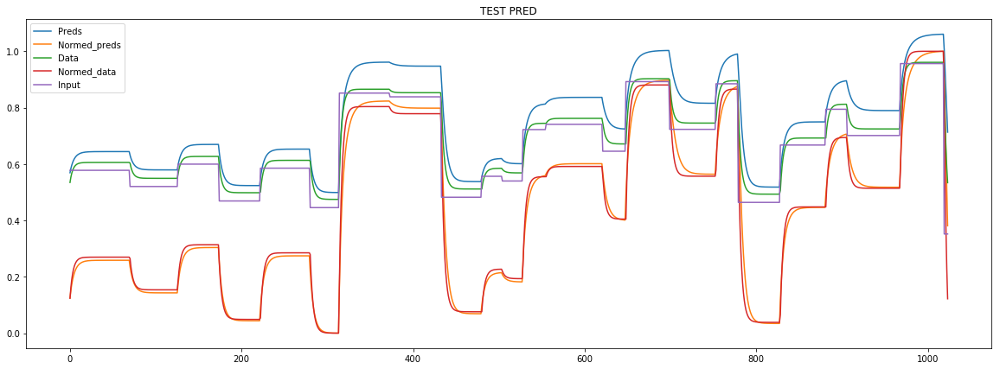

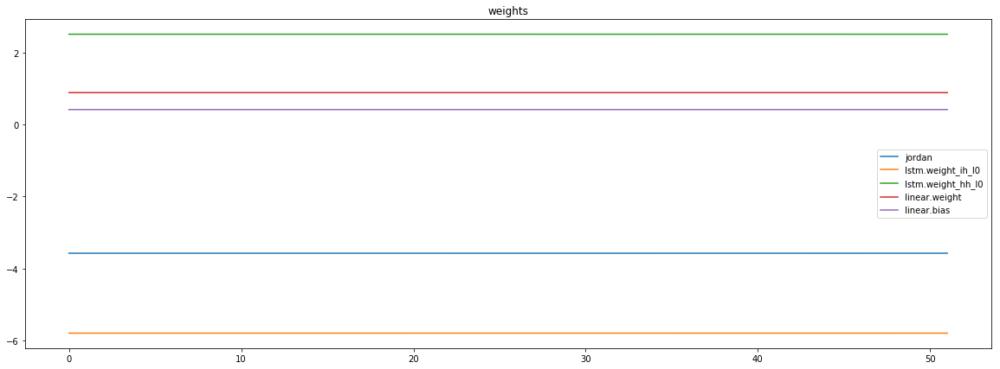

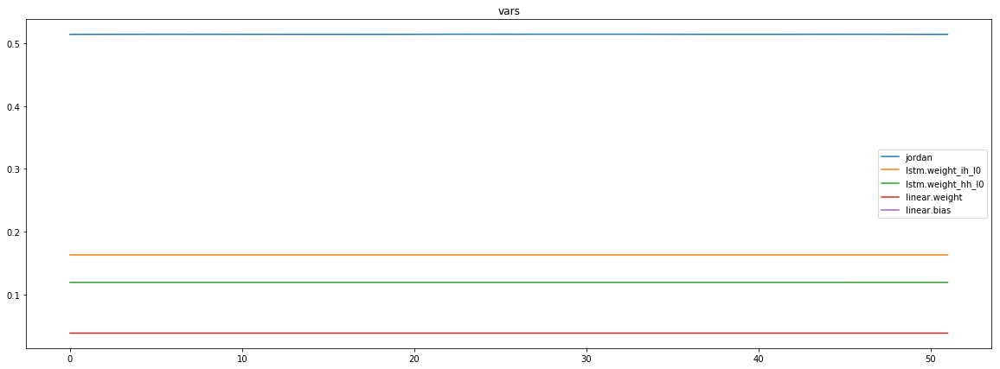

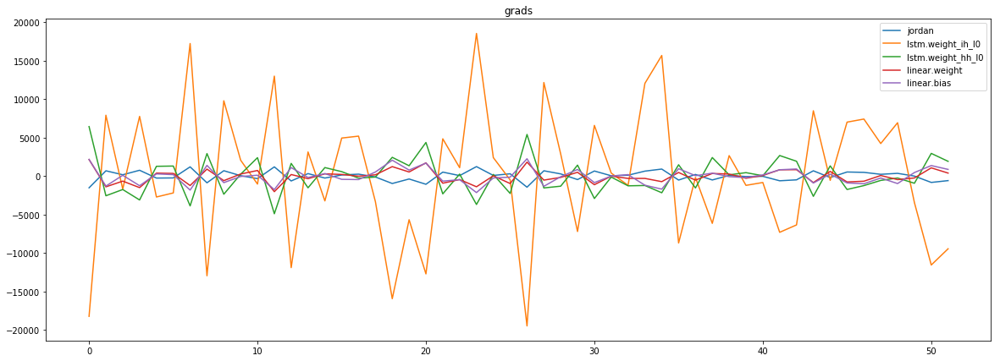

mean_p1 : 0.03794501377986027
mean_p2 : 10.658461717458872
mean_p3 : 7.399462113013635


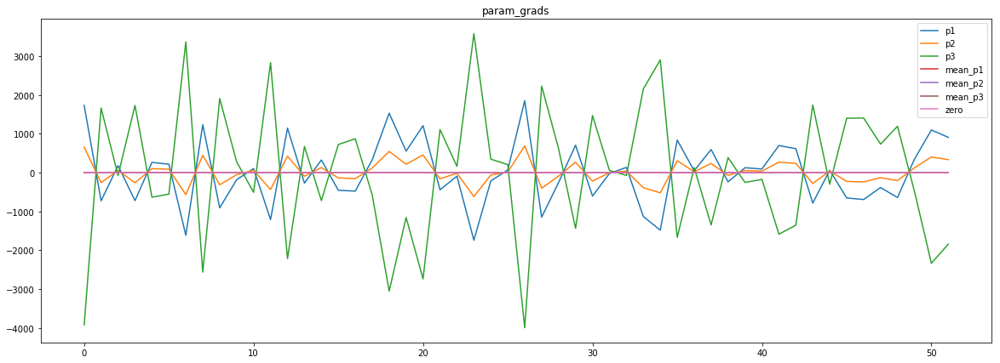

loss rate [2.6941589277296174e-06]
Epoch [50] 
     train_loss[8525.658034104566] 
     eval_train[8525.598031850961] 
     eval_test[8729.558083274147]



aux preds: -0.989375650882721           -1.9894500970840454           -0.5981127023696899
main loss 0.0
aux loss 8525.644766000602
jord loss 0.0
combined loss 8525.644766000602 



Parameter containing:
tensor([[-0.9894, -1.9895, -0.5981]], requires_grad=True)


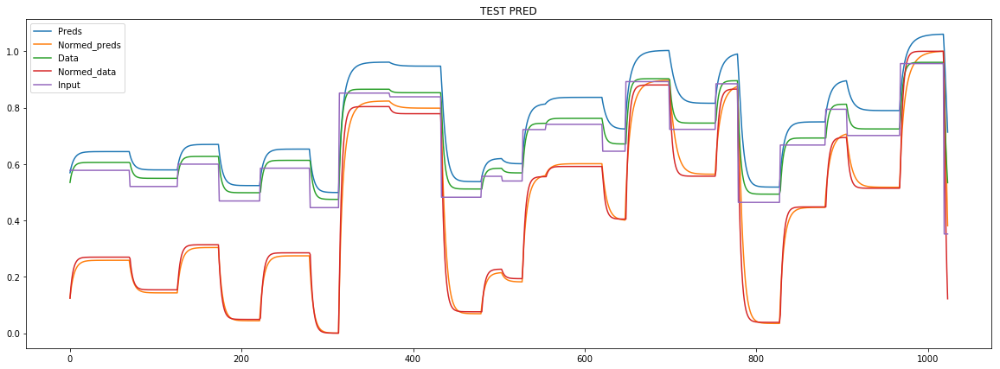

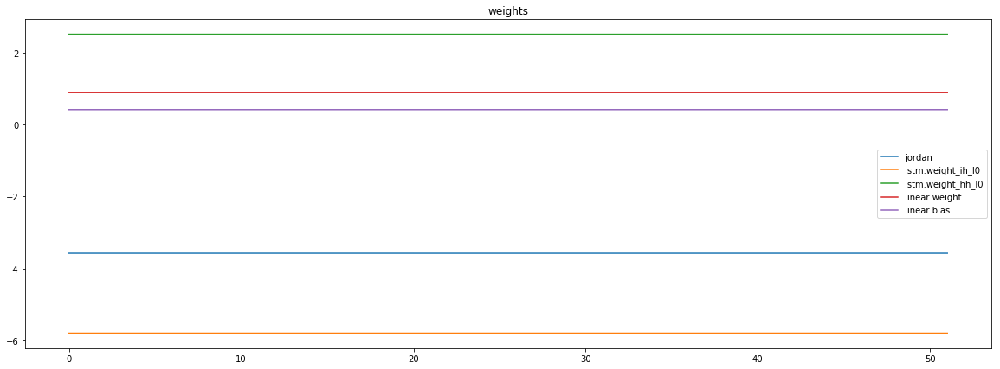

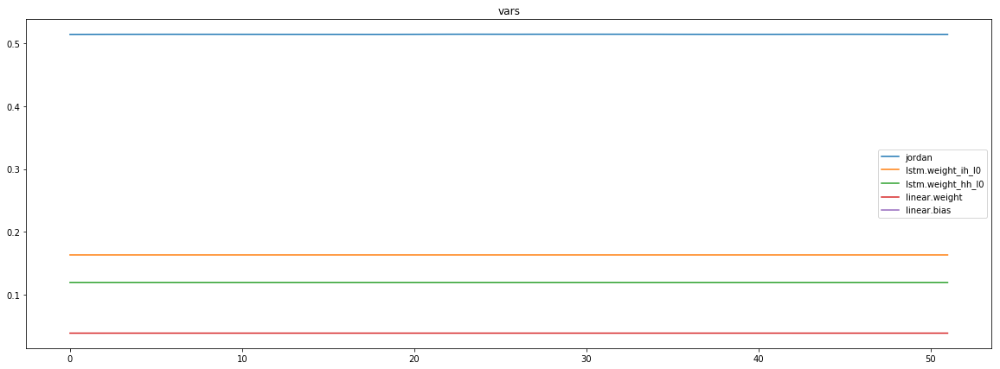

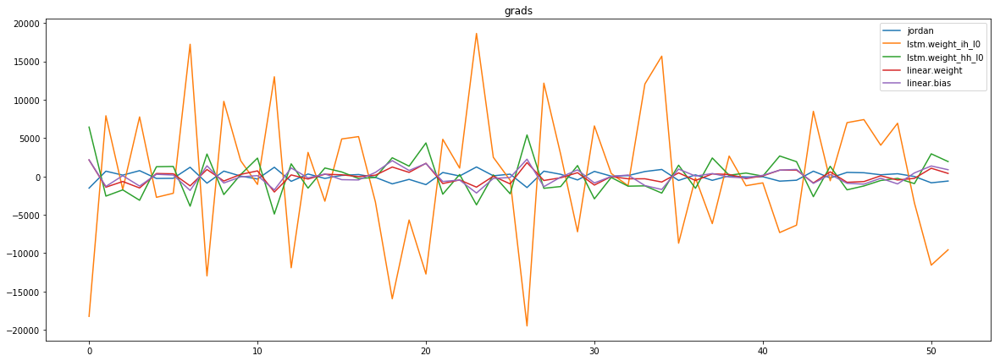

mean_p1 : 0.2380521847651555
mean_p2 : 10.727524445607113
mean_p3 : 6.916519238398625


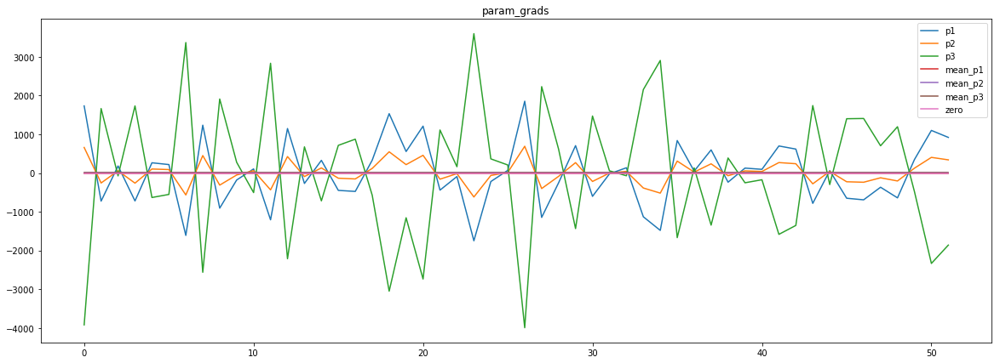

loss rate [2.702637395657348e-06]
Epoch [51] 
     train_loss[8525.644766000602] 
     eval_train[8525.584763746996] 
     eval_test[8729.546364524147]



aux preds: -0.9893772006034851           -1.9896390438079834           -0.59813392162323
main loss 0.0
aux loss 8525.631807767428
jord loss 0.0
combined loss 8525.631807767428 



Parameter containing:
tensor([[-0.9894, -1.9896, -0.5981]], requires_grad=True)


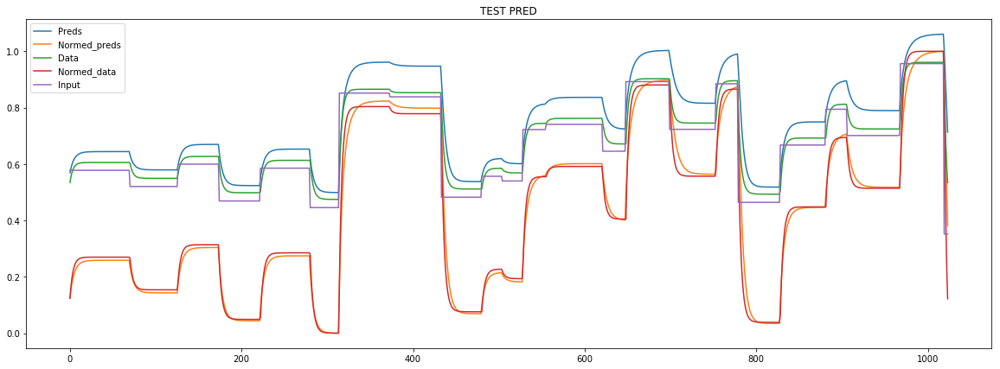

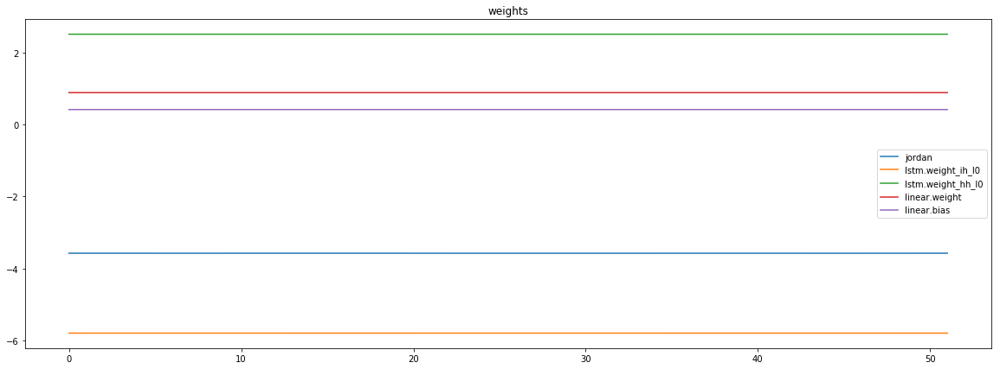

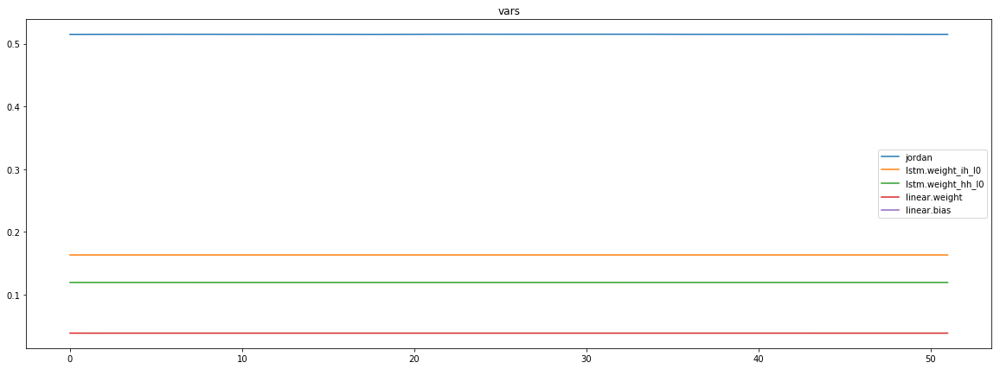

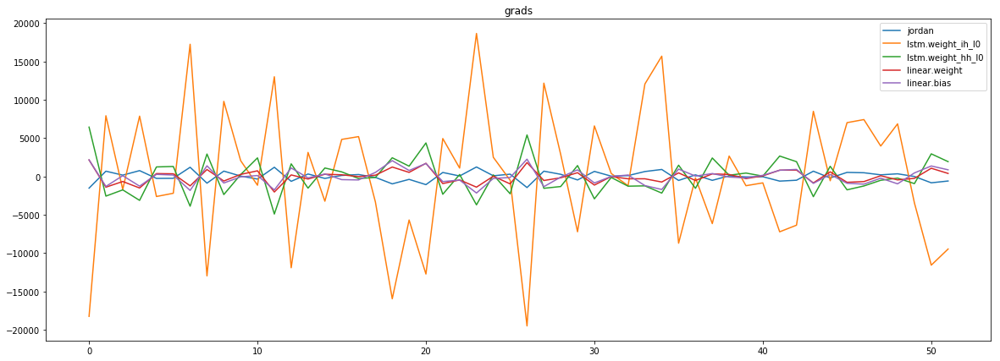

mean_p1 : -0.06481258685772236
mean_p2 : 10.622381155307476
mean_p3 : 7.376570261441744


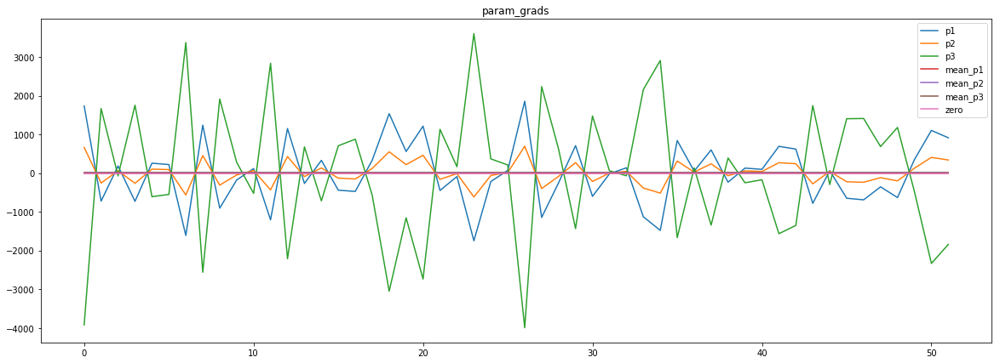

loss rate [2.780610002139916e-06]
Epoch [52] 
     train_loss[8525.631807767428] 
     eval_train[8525.57157076322] 
     eval_test[8729.533868963068]



aux preds: -0.9893767833709717           -1.9898262023925781           -0.5981568694114685
main loss 0.0
aux loss 8525.61885892428
jord loss 0.0
combined loss 8525.61885892428 



Parameter containing:
tensor([[-0.9894, -1.9898, -0.5982]], requires_grad=True)


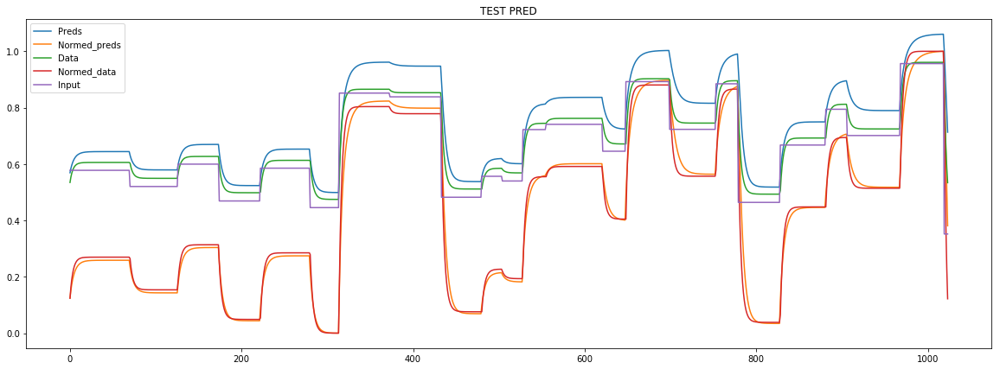

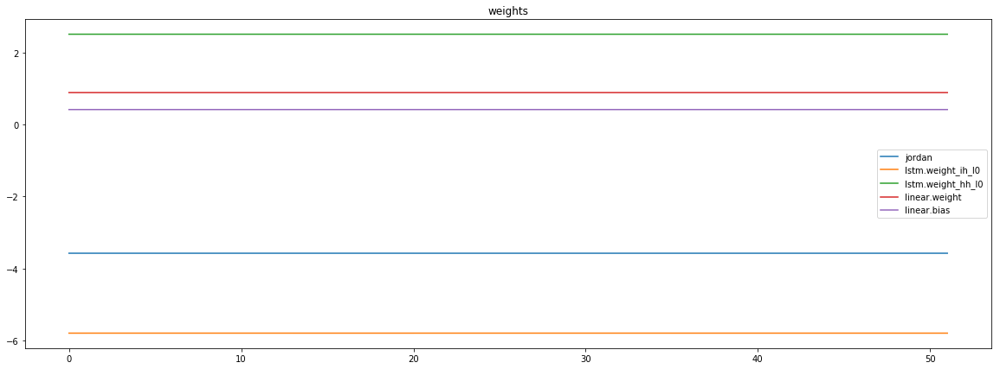

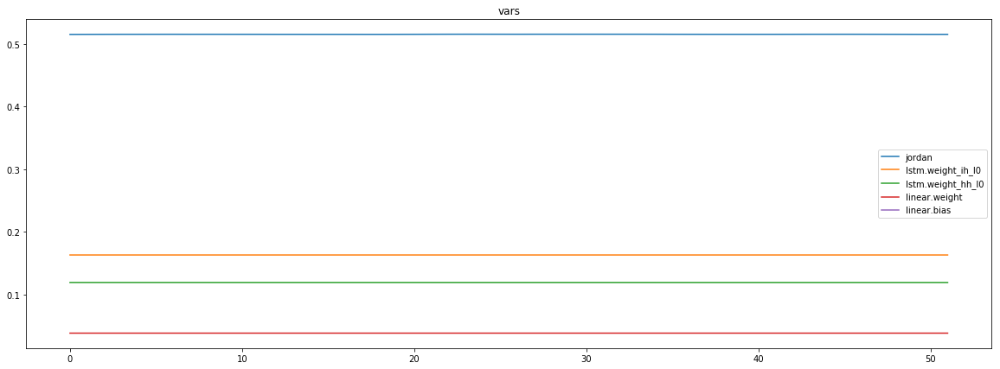

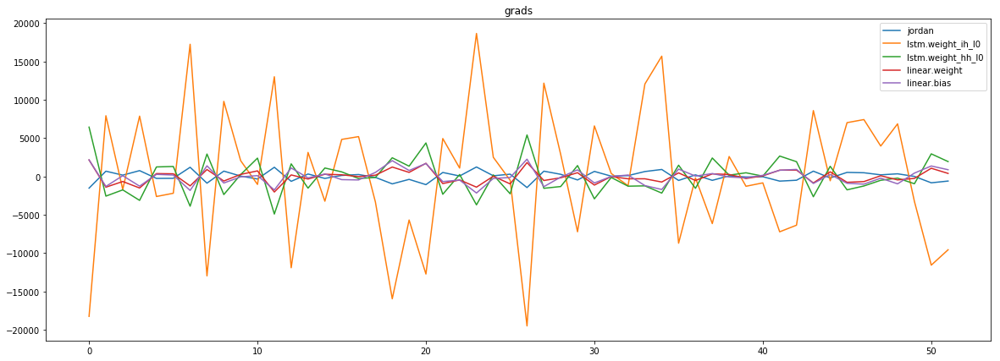

mean_p1 : -0.3924568616426908
mean_p2 : 10.506965004480803
mean_p3 : 7.981131260211651


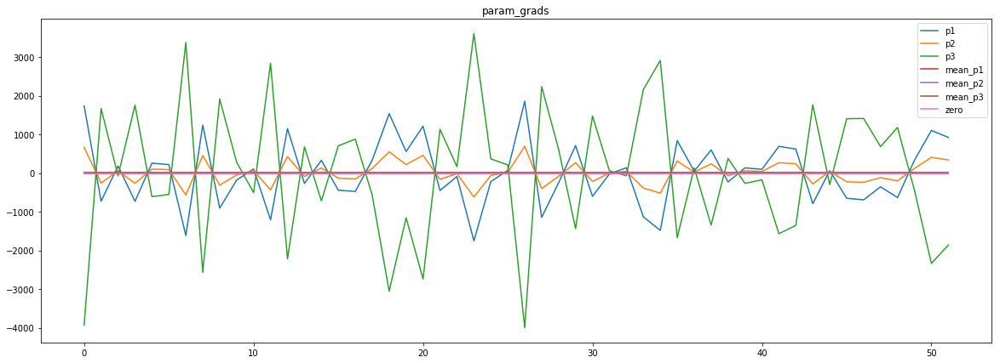

loss rate [2.769596469498481e-06]
Epoch [53] 
     train_loss[8525.61885892428] 
     eval_train[8525.55926983173] 
     eval_test[8729.521928267046]



aux preds: -0.9893763661384583           -1.9900126457214355           -0.5981795787811279
main loss 0.0
aux loss 8525.606041541467
jord loss 0.0
combined loss 8525.606041541467 



Parameter containing:
tensor([[-0.9894, -1.9900, -0.5982]], requires_grad=True)


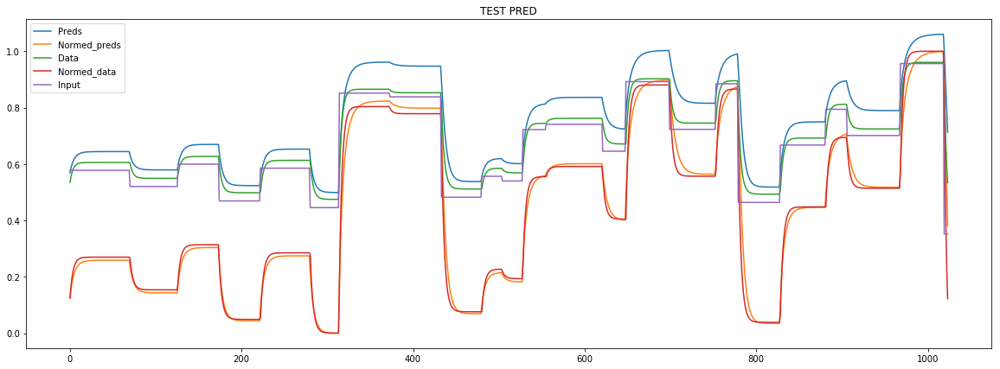

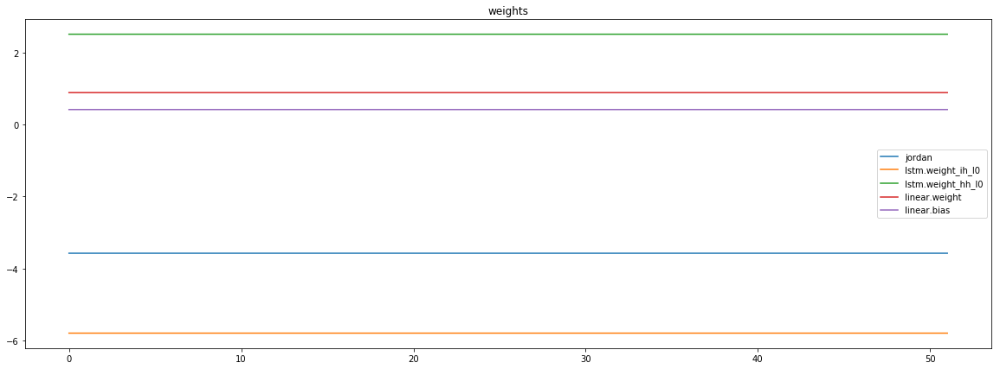

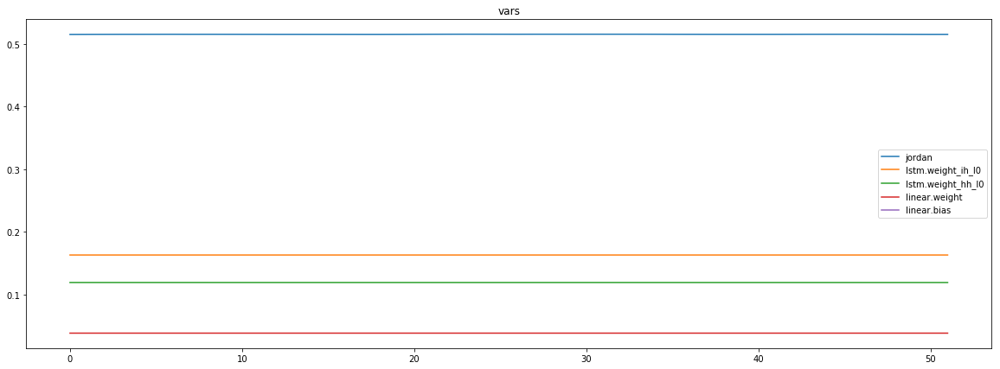

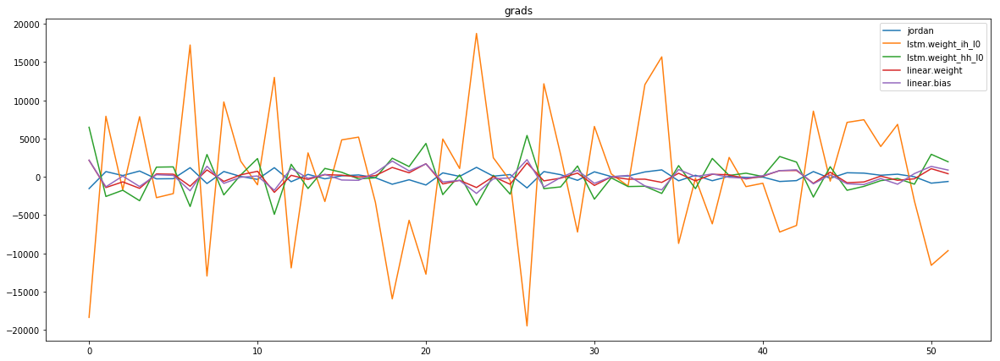

mean_p1 : -0.3521535579974835
mean_p2 : 10.527445077896118
mean_p3 : 7.714410928579477


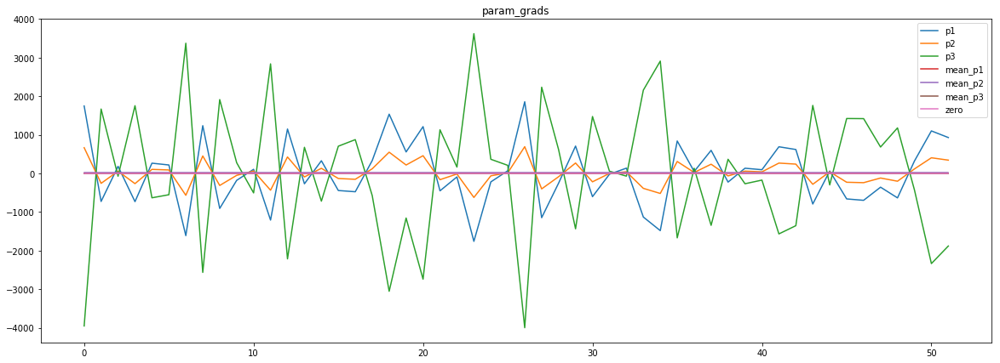

Epoch    54: reducing learning rate of group 0 to 4.0960e-05.
Epoch    54: reducing learning rate of group 1 to 4.0960e-06.
Epoch    54: reducing learning rate of group 2 to 4.0960e-06.
loss rate [2.8509594203196542e-06]
Epoch [54] 
     train_loss[8525.606041541467] 
     eval_train[8525.546828049879] 
     eval_test[8729.509166370739]



aux preds: -0.989412248134613           -1.990124225616455           -0.5981522798538208
main loss 0.0
aux loss 8525.549720177283
jord loss 0.0
combined loss 8525.549720177283 



Parameter containing:
tensor([[-0.9894, -1.9901, -0.5982]], requires_grad=True)


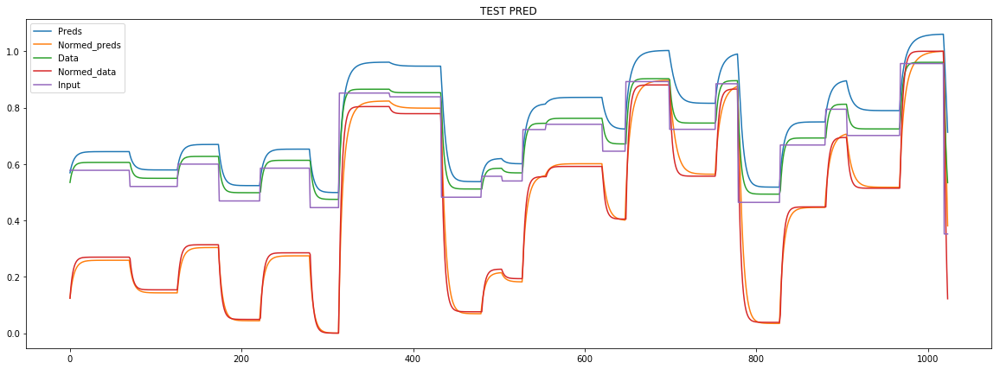

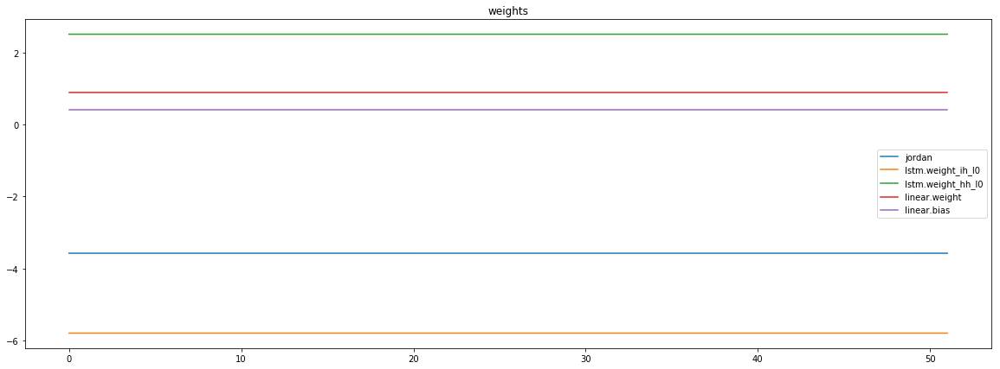

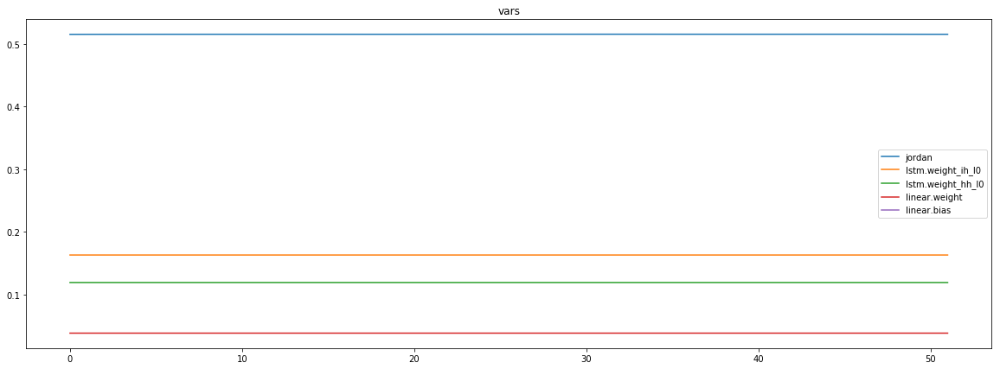

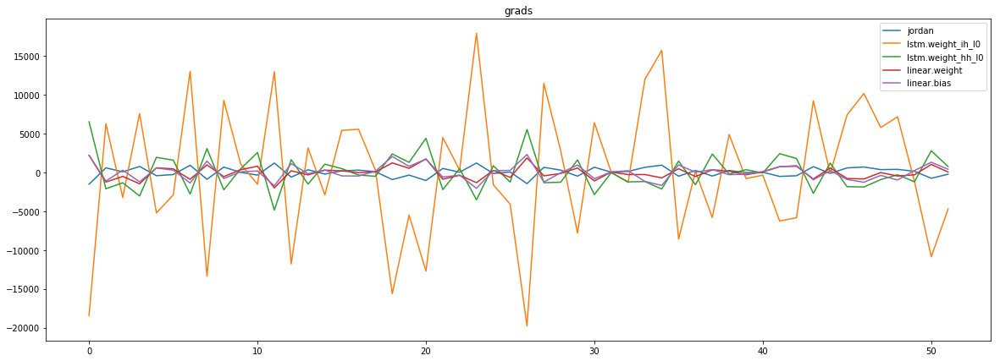

mean_p1 : 2.580390838476328
mean_p2 : 11.59695118207198
mean_p3 : 0.1706265669602614


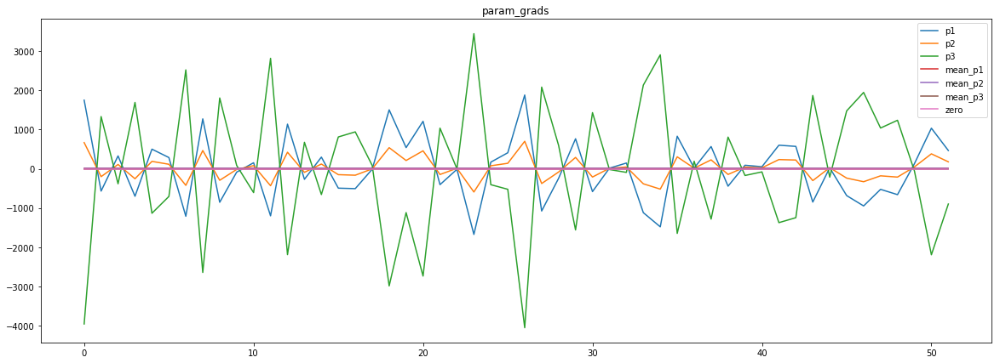

loss rate [1.6568470820876868e-06]
Epoch [55] 
     train_loss[8525.549720177283] 
     eval_train[8525.517033503605] 
     eval_test[8729.507191051136]



aux preds: -0.9894112944602966           -1.9901987314224243           -0.5981634259223938
main loss 0.0
aux loss 8525.541278545674
jord loss 0.0
combined loss 8525.541278545674 



Parameter containing:
tensor([[-0.9894, -1.9902, -0.5982]], requires_grad=True)


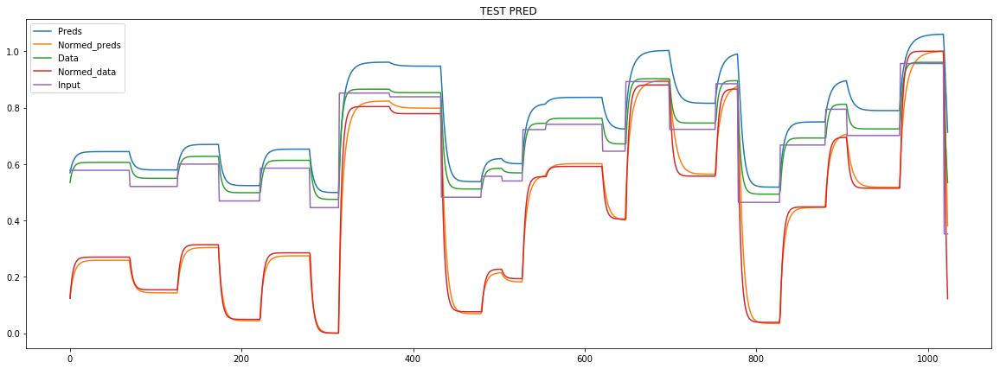

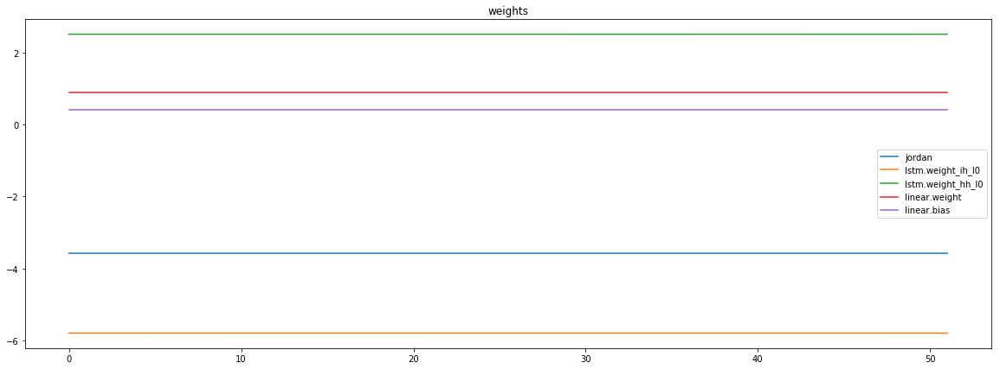

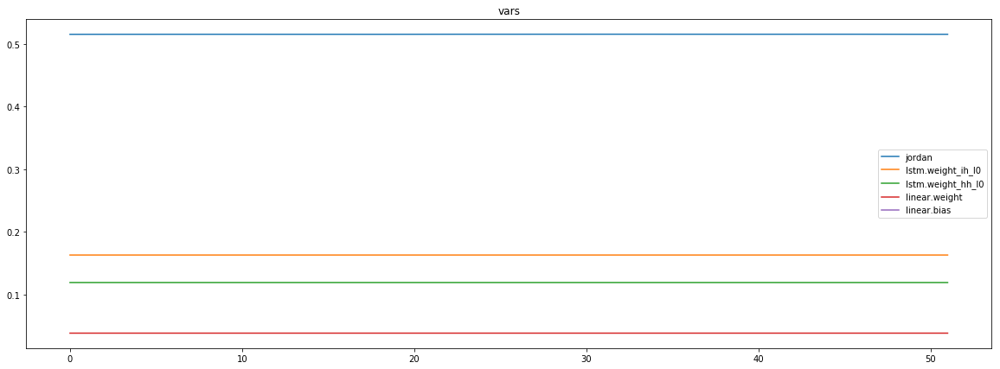

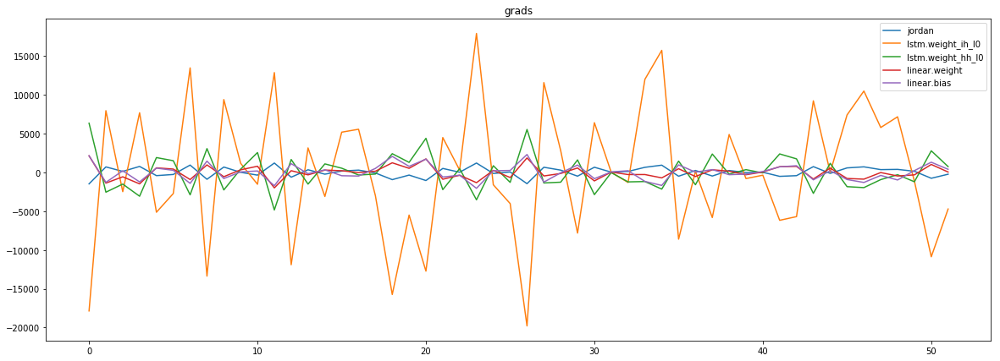

mean_p1 : 1.1397138008704553
mean_p2 : 11.007475669567402
mean_p3 : 5.054415996258076


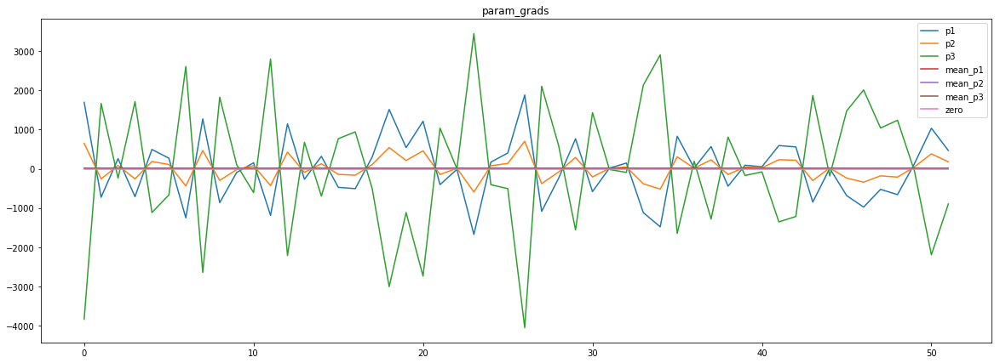

loss rate [1.2508996338755907e-06]
Epoch [56] 
     train_loss[8525.541278545674] 
     eval_train[8525.511803260217] 
     eval_test[8729.501842151989]



aux preds: -0.9894105195999146           -1.9902739524841309           -0.5981744527816772
main loss 0.0
aux loss 8525.536076472355
jord loss 0.0
combined loss 8525.536076472355 



Parameter containing:
tensor([[-0.9894, -1.9903, -0.5982]], requires_grad=True)


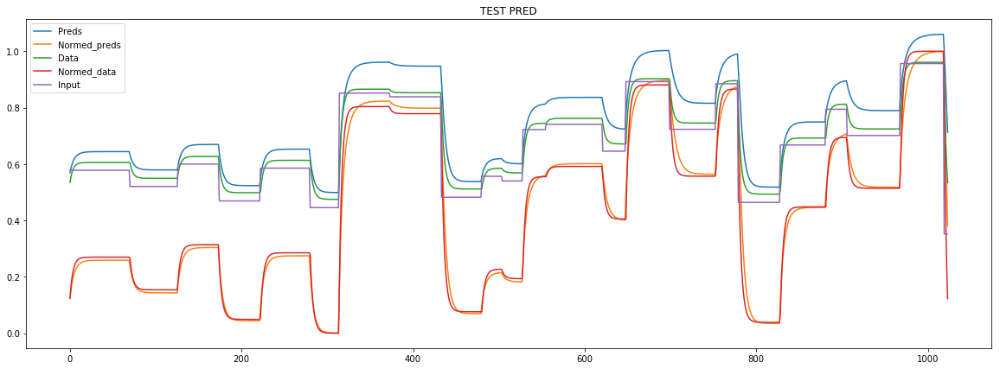

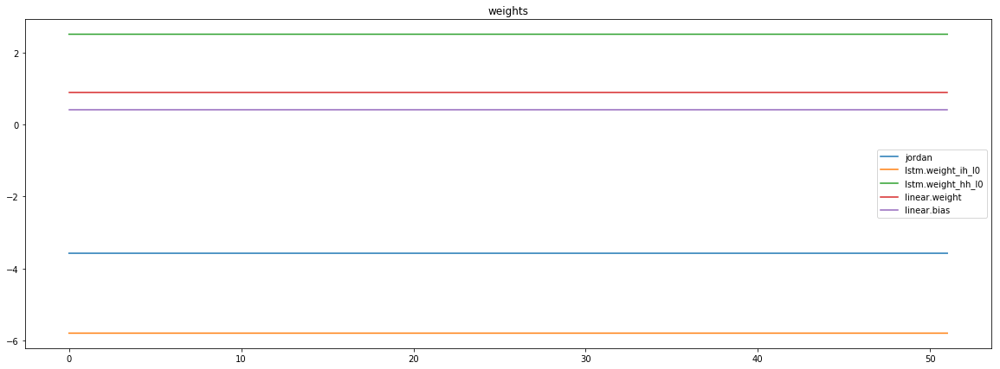

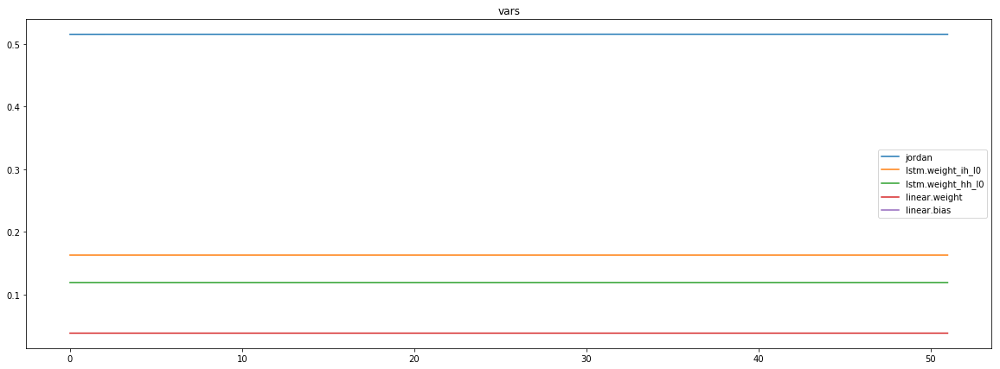

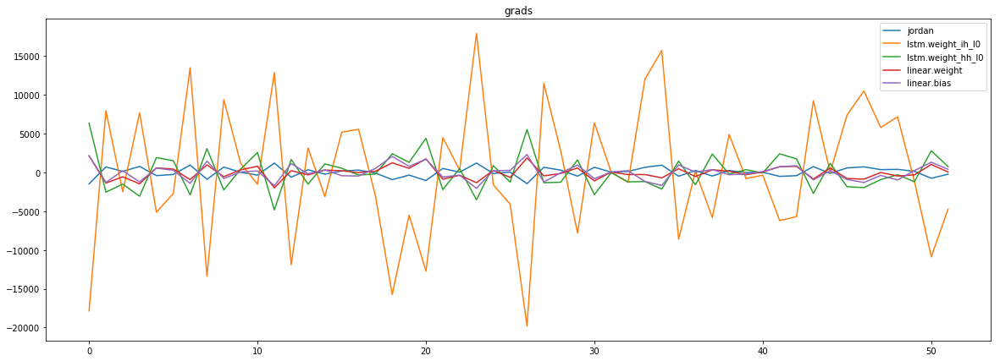

mean_p1 : 1.5170529622298021
mean_p2 : 11.14348789361807
mean_p3 : 4.175063426677998


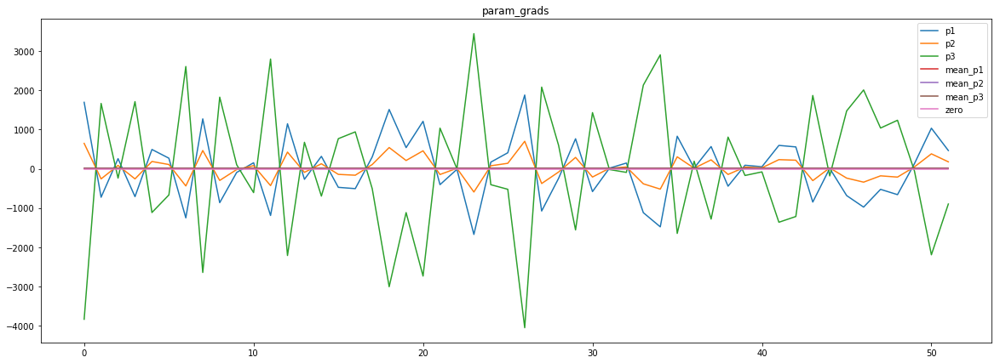

loss rate [1.0864868298376962e-06]
Epoch [57] 
     train_loss[8525.536076472355] 
     eval_train[8525.506375826322] 
     eval_test[8729.49658203125]



aux preds: -0.9894097447395325           -1.9903489351272583           -0.5981854796409607
main loss 0.0
aux loss 8525.530742938701
jord loss 0.0
combined loss 8525.530742938701 



Parameter containing:
tensor([[-0.9894, -1.9903, -0.5982]], requires_grad=True)


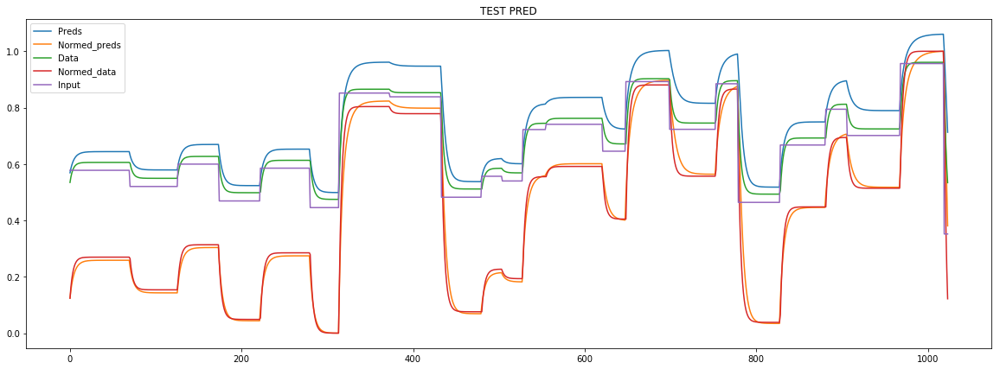

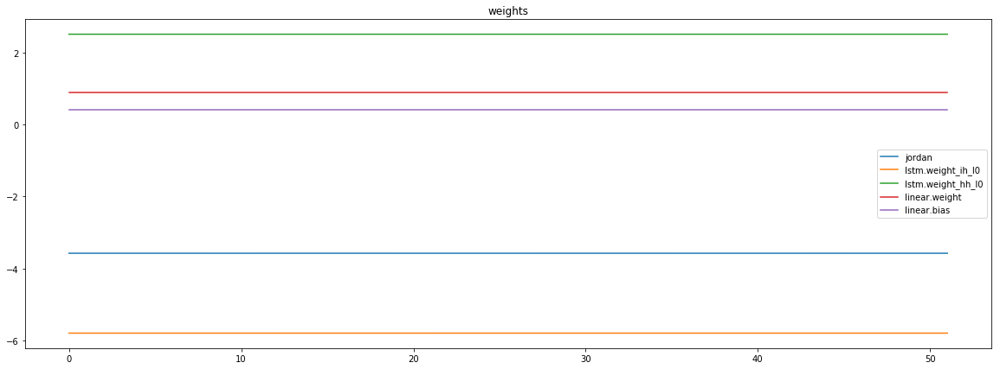

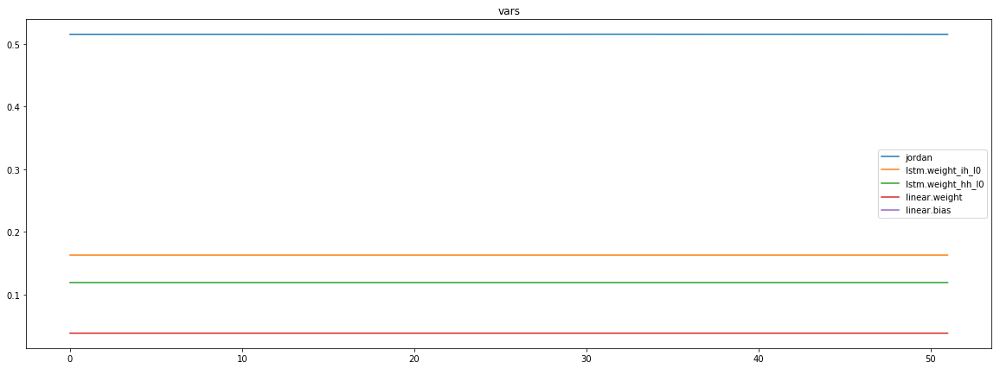

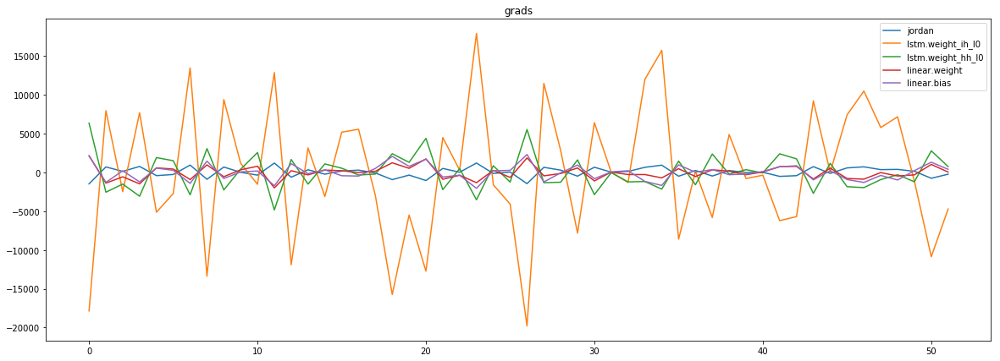

mean_p1 : 1.5058772013737605
mean_p2 : 11.137501386495737
mean_p3 : 4.208009426410381


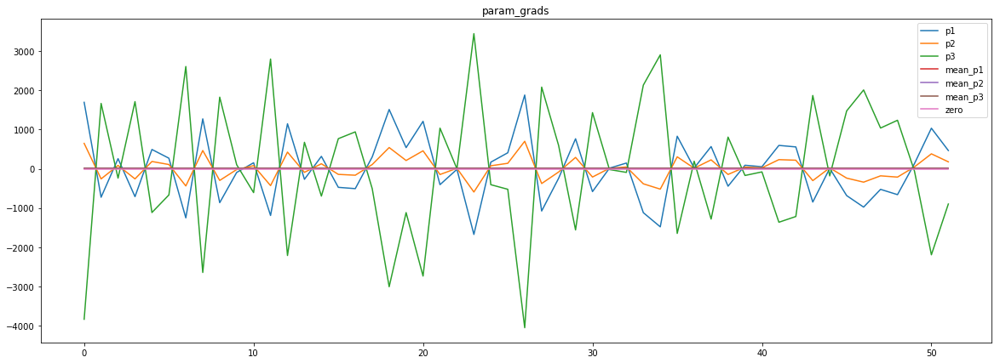

loss rate [1.2008990463163727e-06]
Epoch [58] 
     train_loss[8525.530742938701] 
     eval_train[8525.500910832332] 
     eval_test[8729.491388494318]



aux preds: -0.9894086122512817           -1.9904239177703857           -0.5981967449188232
main loss 0.0
aux loss 8525.525475135217
jord loss 0.0
combined loss 8525.525475135217 



Parameter containing:
tensor([[-0.9894, -1.9904, -0.5982]], requires_grad=True)


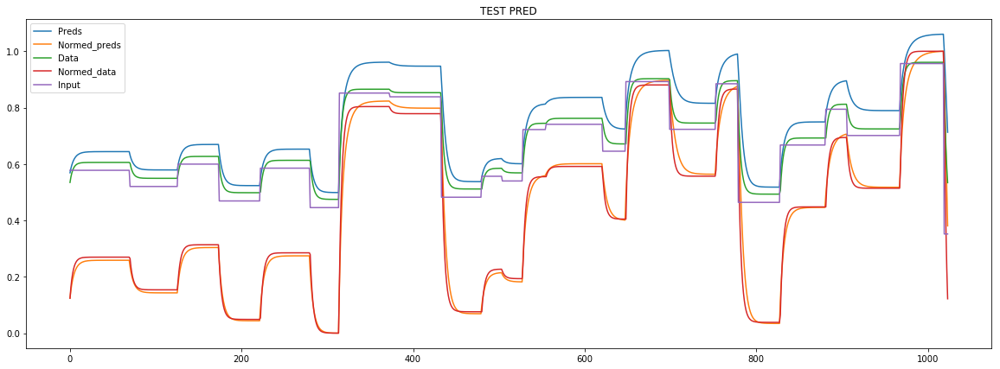

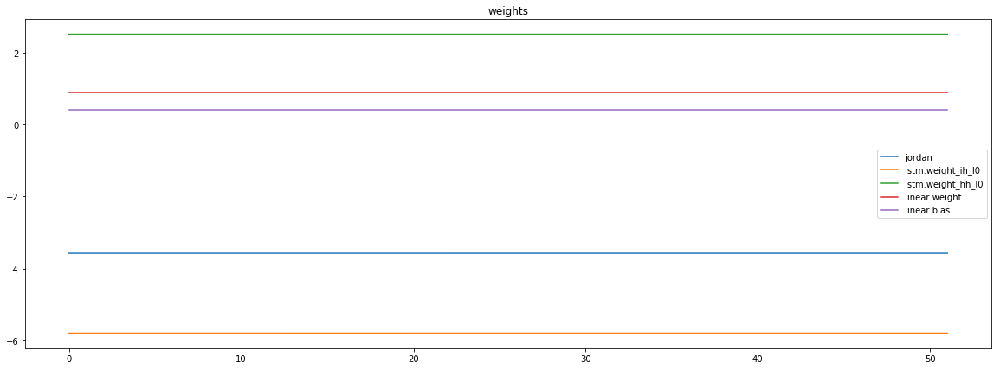

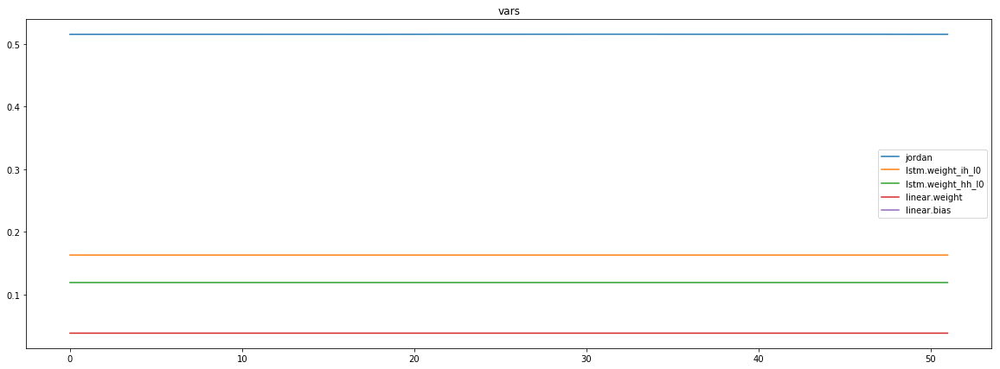

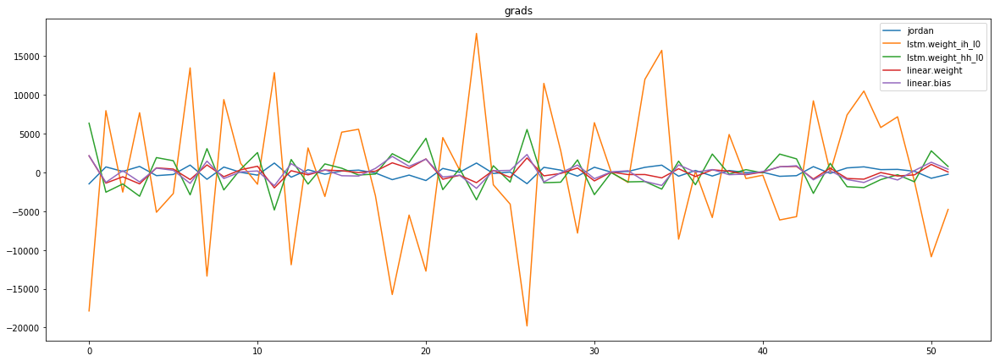

mean_p1 : 1.5274428954491248
mean_p2 : 11.139541644316454
mean_p3 : 4.206363347860483


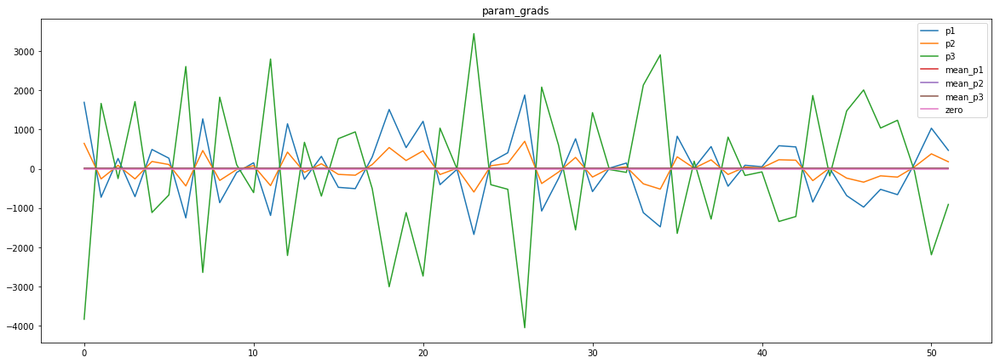

loss rate [1.2000522766619781e-06]
Epoch [59] 
     train_loss[8525.525475135217] 
     eval_train[8525.495539738582] 
     eval_test[8729.486128373579]


In [17]:
logging.info("Training process STARTED")

model.hidden = model.init_hidden()


for t in range(num_epochs):
    
    batch_local_hist = hist["train"]["batches"]
    long_term_hist = hist["train"]["epochs"]
    
    for i, data in enumerate(tqdm(train_dl)):
        
        model.hidden = model.init_hidden()
        
        y_pred, jordan = batch_iteration(
            iter_index=i,
            model=model,
            optimizer=optimizer,
            batch_data=data,
            backprop=True,
            hist_part=batch_local_hist
        )
        
    hist['mean_params_sample']['1'][t] = jordan[:, 0].item()
    hist['mean_params_sample']['2'][t] = jordan[:, 1].item()
    hist['mean_params_sample']['3'][t] = jordan[:, 2].item()
    
    print(f"aux preds: {hist['mean_params_sample']['1'][t]} \
          {hist['mean_params_sample']['2'][t]} \
          {hist['mean_params_sample']['3'][t]}")
    
    mean_losses = update_long_term_hist(batches_hist=batch_local_hist,
                                                            long_term_hist=long_term_hist)
    mean_main, mean_aux, mean_jord = mean_losses
    # TODO add w8 decay
    print(f"main loss {mean_main}")
    print(f"aux loss {mean_aux}")
    print(f"jord loss {mean_jord}")
    print(f"combined loss {sum(mean_losses)} ")
    
    # VISUALISE TRAINING PROGRESS
#     x_batch, y_batch, indexes = data
#     plot_shared_scale([
#         (y_pred[:, 0].detach().numpy(),"Preds" ),
#          (y_batch[:, 0].detach().numpy(), "Data"),
#          (x_batch[-1].detach().numpy(), "Input")
#         ],
#         title="TRAIN PREDICT")
          
#     residuals = y_batch[:, 0] - y_pred[:, 0]
#     plot_multiscale([
#         (residuals.detach().numpy(), "Red"),
#         (y_batch[:, 0].detach().numpy(), "Green"),
#         (y_pred[:, 0].detach().numpy(), "Brown")
#     ],
#         title="TRAIN RESID"
#     ) 
    # /VISUALISE TRAINING PROGRESS

    # EVAL
    with torch.no_grad():
          
          model = model.eval()
          
          for i, data in enumerate(tqdm(train_dl)):
              batch_local_hist = hist['eval_train']['batches']
              long_term_hist=hist["eval_train"]["epochs"]
              y_pred, jordan = batch_iteration(
                iter_index=i,
                model=model,
                optimizer=optimizer,
                batch_data=data,
                backprop=False,
                hist_part=batch_local_hist
              )
          
          update_long_term_hist(batches_hist=batch_local_hist,
                                long_term_hist=long_term_hist)
          
          
          for i, data in enumerate(tqdm(test_dl)):
              batch_local_hist = hist['eval_test']['batches']
              long_term_hist=hist["eval_test"]["epochs"]
          
              y_pred_test, jordan = batch_iteration(
                iter_index=i,
                model=model,
                optimizer=optimizer,
                batch_data=data,
                backprop=False,
                hist_part=batch_local_hist
              )
          
          update_long_term_hist(batches_hist=batch_local_hist,
                                long_term_hist=long_term_hist)
          
          model = model.train()
    # /EVAL
          
    # VISUALISE ITERATION PRED
    x_batch_test, y_batch_test, indexes = data
    print(jordan)
          
    sample_y_pred_test = y_pred_test[:, 0].detach().numpy().copy()
    sample_y_pred_test -= np.min(sample_y_pred_test)
    sample_y_pred_test /= (np.max(sample_y_pred_test) - np.min(sample_y_pred_test))
    normed_data = y_batch_test[:, 0].detach().numpy().copy()
    normed_data -= np.min(normed_data)
    normed_data /= (np.max(normed_data) - np.min(normed_data))
    plot_shared_scale([
            (y_pred_test[:, 0].detach().numpy(), "Preds"),
            (sample_y_pred_test,"Normed_preds" ),
             (y_batch_test[:, 0].detach().numpy(), "Data"),
             (normed_data, "Normed_data"),
             (x_batch_test[-1].detach().numpy(), "Input")
    ],
        title = 'TEST PRED'
    )
    
#           print(y_pred.detach().numpy() == y_batch().detach().numpy())
#     plt.plot(y_pred.detach().numpy())
#     plt.show()
    
          # /VISUALISE ITERATION PRED
   
               
    plot_shared_scale([(v,k)for k, v in hist['weights']['batches'].items()], title='weights')
    plot_shared_scale([(v,k)for k, v in hist['vars']['batches'].items()], title='vars')
    plot_shared_scale([(v,k)for k, v in hist['grads']['batches'].items()], title='grads')
    
    param_grads = [(v,k) for k, v in hist['param_grads']['batches'].items()]
    param_grads_means = [ (np.full(v.shape, np.mean(v)), 'mean_' + k ) for v,k in param_grads]
    for par_gr_mean, name in param_grads_means:
          print(f"{name} : {par_gr_mean[0]}")
    plot_shared_scale(param_grads + param_grads_means +
                      [(np.zeros(len(train_dl)), 'zero')], title='param_grads')
          
    visualise_resid = False
    if visualise_resid:
        residuals = y_batch_test[:, 0] - y_pred_test[:, 0]
        plot_multiscale(
                [
                 (residuals.detach().numpy(), "Red"), 
                 (y_batch_test[:, 0].detach().numpy(),"Green")
                ],
            title = 'TEST RESID'
        )
    
    
    # UPDATE LR
    val_loss = slice_loss_sum(hist['eval_test']['epochs'], t)
    scheduler.step(val_loss)
    hist['weights_sum'][t] = torch.as_tensor([p.sum() for p in model.parameters(recurse=True)]).sum().item()
    hist['weights_var'][t] = torch.as_tensor([p.var() for p in model.parameters(recurse=True)]).sum().item()
    
    for name, parameter in model.named_parameters():
          hist['grads']['epochs'][name][t] = np.mean(hist['grads']['batches'][name])
          hist['weights']['epochs'][name][t] = np.mean(hist['weights']['batches'][name])
          hist['vars']['epochs'][name][t] = np.mean(hist['vars']['batches'][name])
    hist['param_grads']['epochs']['p1'][t] = np.mean(hist['param_grads']['batches']['p1'])
    hist['param_grads']['epochs']['p2'][t] = np.mean(hist['param_grads']['batches']['p2'])
    hist['param_grads']['epochs']['p3'][t] = np.mean(hist['param_grads']['batches']['p3'])
          
          
    
    hist['lr'][t] = scheduler.optimizer.param_groups[0]['lr']
    if hist['lr'][t] <= 10**p_sched['early_stop_order'] * 1.0001: # 1+eps 
          print("Loss critically low, EARLY STOPPING")
          break
          
    if t > 3:
          h = hist["eval_test"]["epochs"]
          loss_rate = 1 - slice_loss_sum(h, t) / np.mean([slice_loss_sum(h, k) for k in range(t-3,t)])          
          hist['loss_rate'][t] = loss_rate              
          print(f"loss rate [{loss_rate}]")
    # /UPDATE LR
                       
    # FINAL PROGRESS LOGGING
    msg = "Epoch [{t}] \n \
    train_loss[{train_loss}] \n \
    eval_train[{eval_train}] \n \
    eval_test[{eval_test}]".format(t=t,
                                train_loss=sum([val[t] for val in hist['train']['epochs'].values()]), 
                                eval_train=sum([val[t] for val in hist['eval_train']['epochs'].values()]),
                                eval_test=sum([val[t] for val in hist['eval_test']['epochs'].values()])
                               )
    print(msg)
    logging.info(msg)
                       
    # /FINAL PROGRESS LOGGING

In [18]:
timestamp = datetime.datetime.now().strftime("%d_%B_%Y_%I_%M%p")
print(timestamp)
filename = f'jordan_3_params_ideal_params_{timestamp}.pt'
torch.save(model, filename)
filename

16_May_2019_04_13PM


'jordan_3_params_ideal_params_16_May_2019_04_13PM.pt'

In [19]:

filename

'jordan_3_params_ideal_params_16_May_2019_04_13PM.pt'

In [20]:
def get_size(dicts):
    acc = 0
    for key, val in dicts.items():
        if type(val) == dict:
            print(key)
            acc += get_size(val)            
        else:
            acc+=sys.getsizeof(val)
    return acc

In [21]:

get_size(hist) / 1024

train
batches
epochs
eval_train
batches
epochs
eval_test
batches
epochs
mean_params_sample
grads
batches
epochs
weights
batches
epochs
vars
batches
epochs
param_grads
batches
epochs
grad_global


188.578125

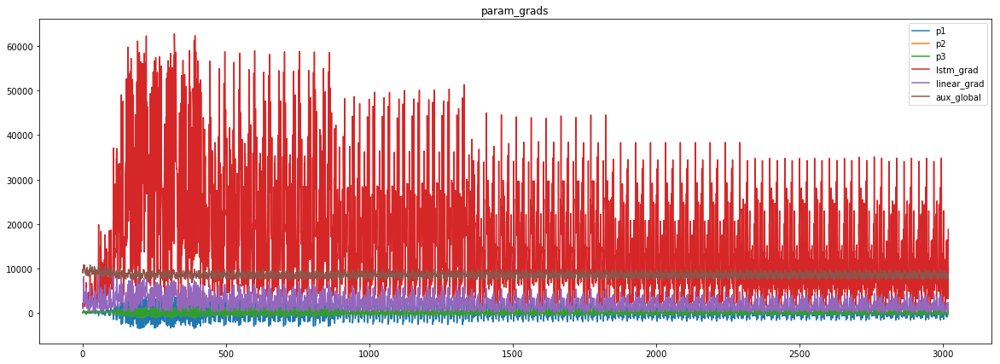

In [22]:
s = 100
e = -1
plot_shared_scale([
    (hist['grad_global']['p1'][s:e], 'p1'),
    (hist['grad_global']['p2'][s:e], 'p2'),
    (hist['grad_global']['p2'][s:e], 'p3'),
    (hist['grad_global']['lstm'][s:e], 'lstm_grad'),
    (hist['grad_global']['linear'][s:e], 'linear_grad'),
    (hist['aux_global'][s:e], 'aux_global')
], title="param_grads")
s =  10
e = -1

In [23]:
s, e = 0, t

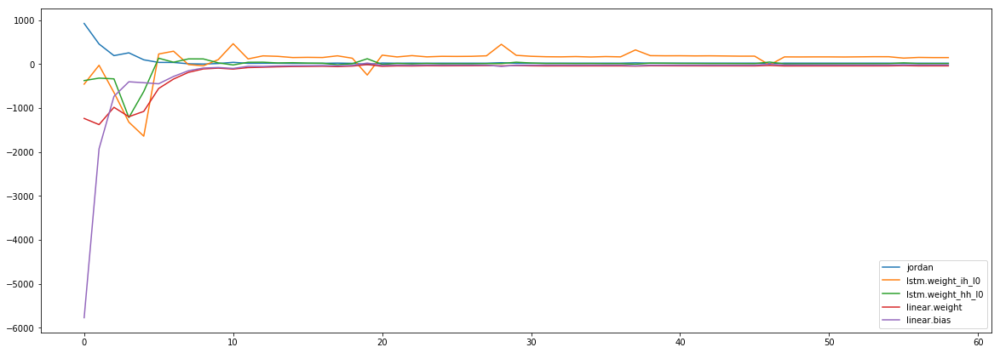

In [24]:
plot_shared_scale([(v[s:e],k)for k, v in hist['grads']['epochs'].items()])

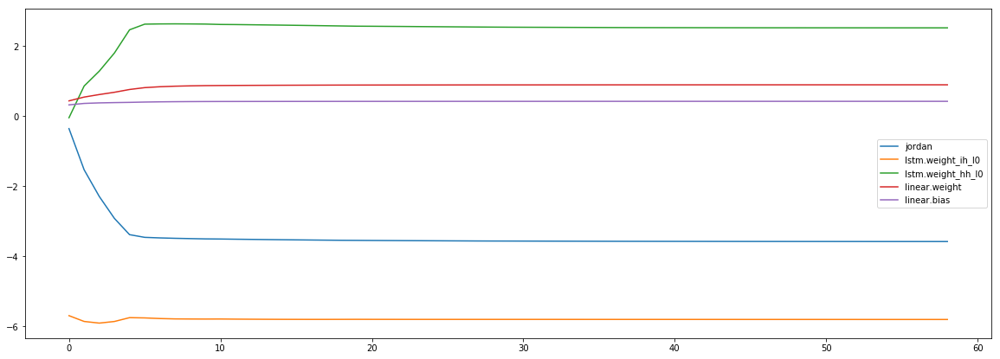

In [25]:
plot_shared_scale([(v[s:e],k)for k, v in hist['weights']['epochs'].items()])

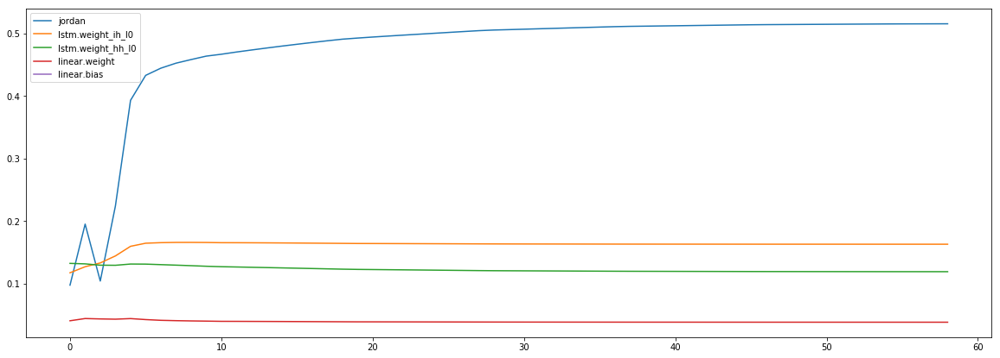

In [26]:
plot_shared_scale([(v[s:e],k)for k, v in hist['vars']['epochs'].items()])

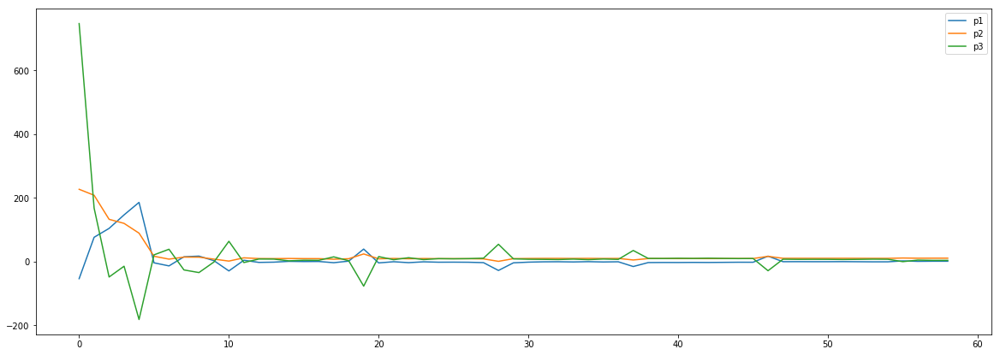

In [27]:
s = 0
plot_shared_scale([(v[s:e],k)for k, v in hist['param_grads']['epochs'].items()])

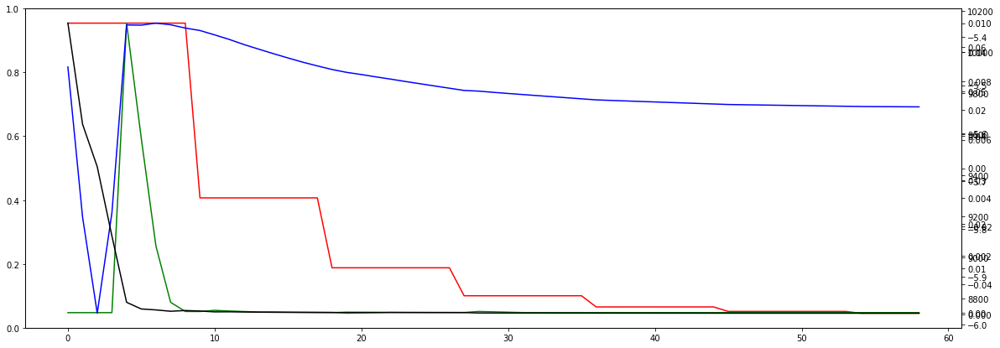

In [28]:
s, e = 0, t
plot_multiscale([
    (hist['lr'][s:e],"Red" ),
    (hist['loss_rate'][s:e], "Green"),
    (hist['weights_sum'][s:e], "Blue"),
    (hist['weights_var'][s:e], "Yellow"),
    (hist['eval_test']['epochs']['aux'][s:e], "Black")
])

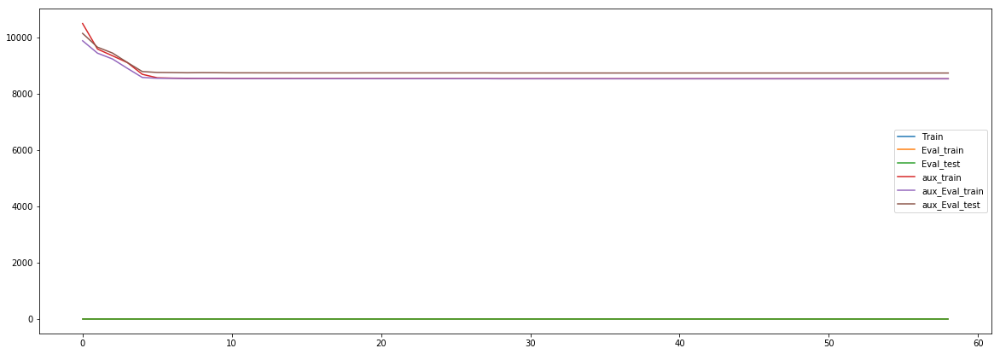

In [29]:
plot_shared_scale([
    (hist['train']["epochs"]['main'][s:e],"Train" ),
    (hist['eval_train']["epochs"]['main'][s:e], "Eval_train"),
    (hist['eval_test']["epochs"]['main'][s:e], "Eval_test"),
    (hist['train']["epochs"]['aux'][s:e], "aux_train"),
    (hist['eval_train']['epochs']['aux'][s:e], "aux_Eval_train"),
    (hist['eval_test']['epochs']['aux'][s:e], "aux_Eval_test")
])

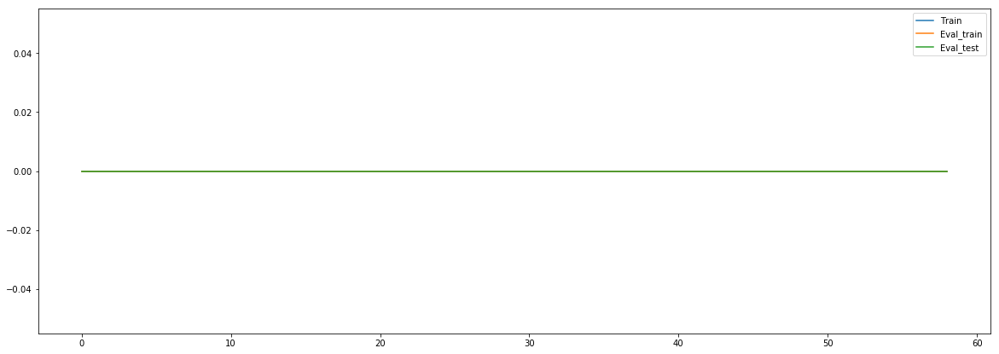

In [30]:
plot_shared_scale([
    (hist['train']["epochs"]['jordan'][s:e],"Train" ),
    (hist['eval_train']["epochs"]['jordan'][s:e], "Eval_train"),
    (hist['eval_test']["epochs"]['jordan'][s:e], "Eval_test"),
#     (hist['train']["epochs"]['aux'][s:e], "aux_train"),
#     (hist['eval_train']['epochs']['aux'][s:e], "aux_Eval_train"),
#     (hist['eval_test']['epochs']['aux'][s:e], "aux_Eval_test")
])

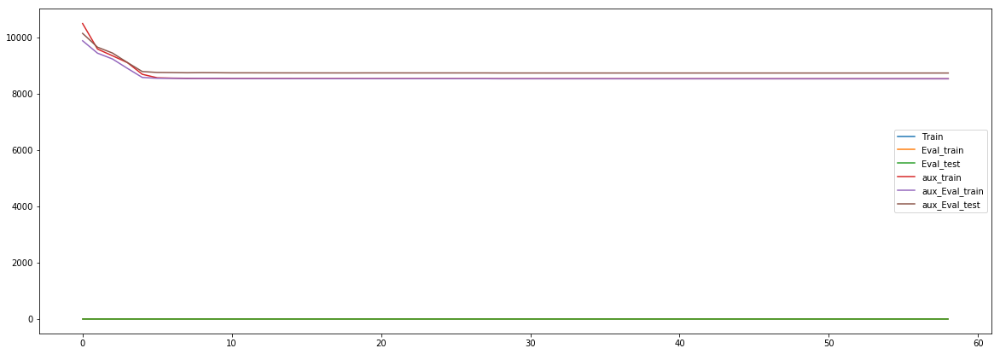

In [31]:
plot_shared_scale([
    (hist['train']["epochs"]['jordan'][s:e],"Train" ),
    (hist['eval_train']["epochs"]['jordan'][s:e], "Eval_train"),
    (hist['eval_test']["epochs"]['jordan'][s:e], "Eval_test"),
    (hist['train']["epochs"]['aux'][s:e], "aux_train"),
    (hist['eval_train']['epochs']['aux'][s:e], "aux_Eval_train"),
    (hist['eval_test']['epochs']['aux'][s:e], "aux_Eval_test")
])

In [32]:
# To the prove of faster convergence

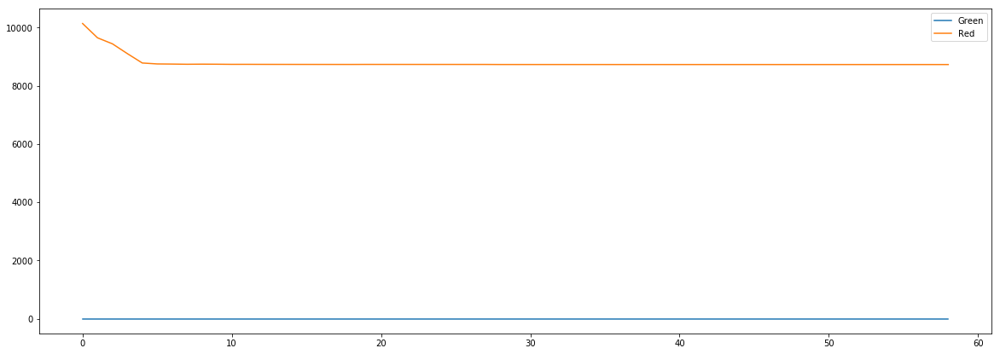

In [33]:
plot_shared_scale(
[
    (hist['eval_test']["epochs"]['jordan'][s:e], 'Green'),
    
    (hist['eval_test']["epochs"]['aux'][s:e], 'Red'),
]
)

In [34]:
for n, v in model.named_parameters():
    print(n, "\t", v.shape, "\t", v.sum())

jordan 	 torch.Size([1, 3]) 	 tensor(-3.5780, grad_fn=<SumBackward0>)
lstm.weight_ih_l0 	 torch.Size([8, 4]) 	 tensor(-5.8016, grad_fn=<SumBackward0>)
lstm.weight_hh_l0 	 torch.Size([8, 2]) 	 tensor(2.5181, grad_fn=<SumBackward0>)
linear.weight 	 torch.Size([1, 2]) 	 tensor(0.8937, grad_fn=<SumBackward0>)
linear.bias 	 torch.Size([1]) 	 tensor(0.4222, grad_fn=<SumBackward0>)


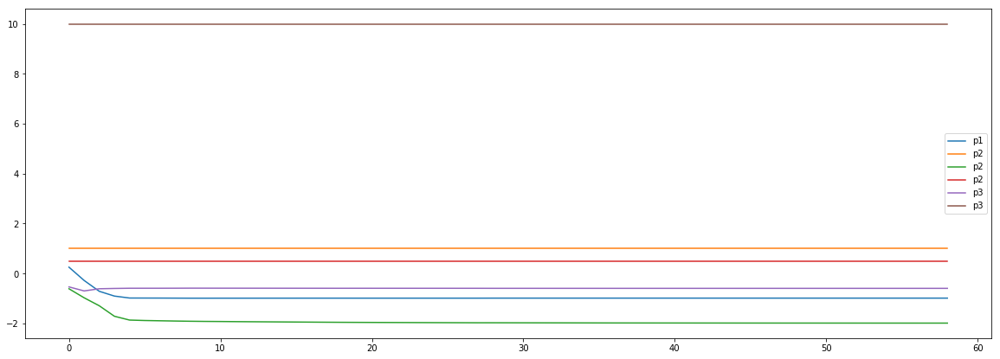

In [35]:
plot_shared_scale([
                  (hist['mean_params_sample']['1'][s:e], "p1"),
                  ((hist['mean_params_sample']['2']*0 + 1)[s:e], "p2"),
                  (hist['mean_params_sample']['2'][s:e], "p2"),
                  ((hist['mean_params_sample']['2']*0 + 0.5)[s:e], "p2"),
    (hist['mean_params_sample']['3'][s:e], "p3"),
                  ((hist['mean_params_sample']['2']*0 + 10)[s:e], "p3")
])

In [36]:
model.buffers

<bound method Module.buffers of LSTM_jordan(
  (lstm): LSTM(4, 2, bias=False)
  (linear): Linear(in_features=2, out_features=1, bias=True)
)>

In [37]:
logging.info("Training process END")